# Grid setup LUT

## Imports

In [1]:
%load_ext autoreload
%autoreload 2

# Standard imports
from collections import defaultdict
import csv
import pickle 

# 3rd party imports
import numpy as np
np.set_printoptions(linewidth=1000)
import matplotlib.colors as mcolors
import matplotlib.pyplot as plt
from pprint import pprint
from tqdm.notebook import tqdm

# Local imports
import modules.laplacian as laplacian
import modules.jacobian as jacobian

## Functions

In [2]:
def _create_correspondence(y: int, x: int, angle: int, magnitude: float, n: int):
    """
    Create a correspondence for the given parameters.
    
    Parameters:
    y (int): The y-coordinate of the pixel.
    x (int): The x-coordinate of the pixel.
    angle (int): The angle of the vector (degrees).
    magnitude (float): The magnitude of the vector.
    
    Returns:
    np.ndarray: The moving point.
    np.ndarray: The fixed point.
    """
    angle = np.radians(angle)
    mpoint = np.array([0, y, x])
    fpoint_y = y + np.sin(angle) * magnitude
    fpoint_x = x + np.cos(angle) * magnitude
    fpoint = np.array([0, fpoint_y, fpoint_x])
    # Check bounds
    if fpoint_y < 0 or fpoint_x < 0 or fpoint_y > n - 1 or fpoint_x > n - 1:
        raise Exception(f"Invalid correspondence, out of bounds: {mpoint} -> {fpoint}")
    return mpoint, fpoint


def create_case(y: int, x: int, angle: int, magnitude: float, base_mpoints: np.ndarray, base_fpoints: np.ndarray, n: int=7, pad=True):
    """
    Create a case for the given parameters.
    
    Parameters:
    y (int): The y-coordinate of the pixel.
    x (int): The x-coordinate of the pixel.
    angle (int): The angle of the vector (degrees).
    magnitude (float): The magnitude of the vector.
    base_mpoints (np.ndarray): The base moving points.
    base_fpoints (np.ndarray): The base fixed points.
    n (int): The size of the grid.
    
    Returns:
    np.ndarray: The deformation field.
    np.ndarray: The Jacobian determinant field.
    """
    #new_size = 15  # 15 x 15
    #pad_size = (new_size - n) // 2
    #fixed_resolution = np.zeros((1, new_size, new_size))
    fixed_resolution = np.zeros((1, n, n))
    # Create the correspondence and apply as the second correspondence in the grid
    mpoint, fpoint = _create_correspondence(y, x, angle, magnitude, n)
    #mpoint += np.array([0, pad_size, pad_size])
    #fpoint += np.array([0, pad_size, pad_size])
    curr_mpoints = base_mpoints.copy()
    curr_fpoints = base_fpoints.copy()
    curr_mpoints = np.append(curr_mpoints, [mpoint], axis=0)
    curr_fpoints = np.append(curr_fpoints, [fpoint], axis=0)
    # Run Laplacian and Jacobian determinant calculations and save the Jacobian determinant field
    deformation, _, _, _, _ = laplacian.sliceToSlice3DLaplacian(fixed_resolution, curr_mpoints, curr_fpoints)
    #deformation, _, _, _, _ = laplacian.sliceToSlice3DLaplacian(fixed_resolution, curr_fpoints, curr_mpoints)
    # Crop deformation field to original size
    #deformation = deformation[:, :, pad_size:pad_size + n, pad_size:pad_size + n]
    jdet_field = jacobian.sitk_jacobian_determinant(deformation)[0]
    return deformation, jdet_field


def show_data(data: dict, y: int, x: int, angle: int, magnitude: float, title="", fontsize=8):
    """
    Show the grid of deformation information.
    
    Parameters:
    data (dict): The data dictionary.
    y (int): The y-coordinate of the pixel.
    x (int): The x-coordinate of the pixel.
    angle (int): The angle of the vector.
    magnitude (float): The magnitude of the vector.
    deformation (np.ndarray): The deformation field.
    title (str): The title of the plot.
    fontsize (int): The fontsize of the text.
    """
    deformation, jdet_field = data[y][x][angle][magnitude]
    norm = mcolors.TwoSlopeNorm(vmin=min(jdet_field.min(), -1), vcenter=0, vmax=jdet_field.max())
    
    # Plot the grid of deformation information
    f = plt.figure(figsize=(10, 5))
    
    # Plot the grid of Jacobian determinants color values
    plt.imshow(jdet_field, cmap="seismic", norm=norm)
    plt.colorbar()
    angle_rad = np.radians(angle)
    plt.arrow(jdet_field.shape[1] // 2, jdet_field.shape[0] // 2, np.cos(0) * 1, np.sin(0) * 1, head_width=0.15, head_length=0.15, fc='green', ec='green')
    plt.arrow(x, y, np.cos(angle_rad) * magnitude, np.sin(angle_rad) * magnitude, head_width=0.15, head_length=0.15, fc='green', ec='green')
    
    # Draw a dot at moving points
    #for i in range(len(mpoints)):
    #    plt.scatter(mpoints[i][2], mpoints[i][1], color='green')
    
    # Plot the coordinate text
    for j in range(jdet_field.shape[0]):
        for i in range(jdet_field.shape[1]):
            # Get the pixel information
            normalized_y = j - (jdet_field.shape[0] // 2) 
            normalized_x = i - (jdet_field.shape[1] // 2)
            
            curr_displacement = deformation[:, 0, j, i]
            displacement_y = curr_displacement[1]
            displacement_x = curr_displacement[2]

            # Get the angle information
            curr_theta_rad = np.arctan2(displacement_y, displacement_x)
            if curr_theta_rad < 0:  # Ensure the angle is in the range [0, 2pi)
                curr_theta_rad += 2 * np.pi
            curr_theta = np.abs(np.degrees(curr_theta_rad))
            
            # Get the magnitude information
            curr_magnitude = np.linalg.norm(curr_displacement)
            jdet = jdet_field[j, i]
            
            # Setup text to display
            coord_text = f"({displacement_y:.1f}, {displacement_x:.1f})\n"
            jdet_text = f"{jdet:.2f} J"
            vector_text = f"\n{curr_theta:.2f}°\n" + f"∥{curr_magnitude:.2f}∥"
            #pixel_text = coord_text + jdet_text + vector_text
            pixel_text = jdet_text
            plt.text(i, j, pixel_text, color='black', ha='center', va='center', fontsize=fontsize, weight='normal')
            
            # Draw the vector direction
            magnitude_scale = 0.33  # To scale the vector magnitude for visualization purposes
            #plt.arrow(i, j, np.cos(curr_theta_rad) * magnitude_scale, np.sin(curr_theta_rad) * magnitude_scale, head_width=0.15, head_length=0.15, fc='black', ec='black')            

            

    # Set the xticks and yticks
    plt.xticks(np.arange(jdet_field.shape[0]), labels=np.arange(-(jdet_field.shape[1] // 2) - 1, jdet_field.shape[1] // 2) + 1)
    plt.yticks(np.arange(jdet_field.shape[0]), labels=np.arange(-(jdet_field.shape[0] // 2) - 1, jdet_field.shape[0] // 2) + 1)
    plt.title(title)
    plt.show()
    f.clear()
    plt.close(f)
    
    
def nested_dict():
    return defaultdict(nested_dict)

### Flip case 2

In [3]:

def _create_correspondence2(y: int, x: int, angle: int, magnitude: float, n: int):
    """
    Create a correspondence for the given parameters.
    
    Parameters:
    y (int): The y-coordinate of the pixel.
    x (int): The x-coordinate of the pixel.
    angle (int): The angle of the vector (degrees).
    magnitude (float): The magnitude of the vector.
    
    Returns:
    np.ndarray: The moving point.
    np.ndarray: The fixed point.
    """
    angle = np.radians(angle)
    mpoint = np.array([0, y, x])
    fpoint_y = y + np.sin(angle) * magnitude
    fpoint_x = x + np.cos(angle) * magnitude
    fpoint = np.array([0, fpoint_y, fpoint_x])
    return mpoint, fpoint


def create_case2(y: int, x: int, angle: int, magnitude: float, base_mpoints: np.ndarray, base_fpoints: np.ndarray, n: int=7, pad=True, base_magnitude=1, x_1_case=False):
    """
    Create a case for the given parameters.
    
    Parameters:
    y (int): The y-coordinate of the pixel.
    x (int): The x-coordinate of the pixel.
    angle (int): The angle of the vector (degrees).
    magnitude (float): The magnitude of the vector.
    base_mpoints (np.ndarray): The base moving points.
    base_fpoints (np.ndarray): The base fixed points.
    n (int): The size of the grid.
    
    Returns:
    np.ndarray: The deformation field.
    np.ndarray: The Jacobian determinant field.
    """
    #new_size = 15  # 15 x 15
    #pad_size = (new_size - n) // 2
    #fixed_resolution = np.zeros((1, new_size, new_size))
    fixed_resolution = np.zeros((1, n, n))
    # Create the correspondence and apply as the second correspondence in the grid
    mpoint, fpoint = _create_correspondence2(y, x, angle, magnitude, n)
    #mpoint += np.array([0, pad_size, pad_size])
    #fpoint += np.array([0, pad_size, pad_size])
    #base_fpoints = np.array([[0, n // 2, n // 2 + 1]])  # normal case
    #base_mpoints = np.array([[0, n // 2, n // 2]])
    
    #x_1_case = False
    if x_1_case:
        if base_fpoints is None:
            base_fpoints = np.array([[0, n // 2, n // 2 + base_magnitude - 1]])  # x - 1 case
        if base_mpoints is None:
            #base_mpoints = np.array([[0, n // 2, n // 2 - base_magnitude]])
            base_mpoints = np.array([[0, n // 2, n // 2 - 1]])
    else:  # else normal case
        if base_fpoints is None:
            base_fpoints = np.array([[0, n // 2, n // 2 + base_magnitude]])
        if base_mpoints is None:
            base_mpoints = np.array([[0, n // 2, n // 2]])
        
        
    curr_mpoints = base_mpoints.copy()
    curr_fpoints = base_fpoints.copy()
    curr_mpoints = np.append(curr_mpoints, [mpoint], axis=0)
    curr_fpoints = np.append(curr_fpoints, [fpoint], axis=0)
    # Run Laplacian and Jacobian determinant calculations and save the Jacobian determinant field
    deformation, _, _, _, _ = laplacian.sliceToSlice3DLaplacian(fixed_resolution, curr_mpoints, curr_fpoints)
    #deformation, A, Zd, Yd, Xd = laplacian.sliceToSlice3DLaplacian(fixed_resolution, curr_fpoints, curr_mpoints)
    #np.save("output/case/A.npy", A.todense())
    #np.save("output/case/Zd.npy", Zd)
    #np.save("output/case/Yd.npy", Yd)
    #np.save("output/case/Xd.npy", Xd)
    # Crop deformation field to original size
    #deformation = deformation[:, :, pad_size:pad_size + n, pad_size:pad_size + n]
    jdet_field = jacobian.sitk_jacobian_determinant(deformation)[0]
    return deformation, jdet_field


def show_data2(deformation, jdet_field, y: int, x: int, angle: int, magnitude: float, title="", fontsize=8, base_magnitude=1, multiplier=3, figsize=(10, 5), show_arrows=True):
    """
    Show the grid of deformation information.
    
    Parameters:
    data (dict): The data dictionary.
    y (int): The y-coordinate of the pixel.
    x (int): The x-coordinate of the pixel.
    angle (int): The angle of the vector.
    magnitude (float): The magnitude of the vector.
    deformation (np.ndarray): The deformation field.
    title (str): The title of the plot.
    fontsize (int): The fontsize of the text.
    """
    norm = mcolors.TwoSlopeNorm(vmin=min(jdet_field.min(), -1), vcenter=0, vmax=jdet_field.max())
    
    # Plot the grid of deformation information
    f = plt.figure(figsize=figsize)
    
    # Plot the grid of Jacobian determinants color values
    plt.imshow(jdet_field, cmap="seismic", norm=norm)
    plt.colorbar()
    angle_rad = np.radians(angle)
    
    if show_arrows:
        # Draw arrow for center
        plt.arrow(jdet_field.shape[1] // 2, jdet_field.shape[0] // 2, np.cos(0) * base_magnitude, np.sin(0) * base_magnitude, head_width=0.15, head_length=0.15, fc='green', ec='green')
        
        # Draw arrow for second neighbor
        plt.arrow(x, y, np.cos(angle_rad) * magnitude, np.sin(angle_rad) * magnitude, head_width=0.15, head_length=0.15, fc='green', ec='green')
    
    # Draw a dot at moving points
    #for i in range(len(mpoints)):
    #    plt.scatter(mpoints[i][2], mpoints[i][1], color='green')
    
    # Plot the coordinate text
    for j in range(jdet_field.shape[0]):
        for i in range(jdet_field.shape[1]):
            # Get the pixel information
            normalized_y = j - (jdet_field.shape[0] // 2) 
            normalized_x = i - (jdet_field.shape[1] // 2)
            
            curr_displacement = deformation[:, 0, j, i]
            displacement_y = curr_displacement[1]
            displacement_x = curr_displacement[2]

            # Get the angle information
            curr_theta_rad = np.arctan2(displacement_y, displacement_x)
            if curr_theta_rad < 0:  # Ensure the angle is in the range [0, 2pi)
                curr_theta_rad += 2 * np.pi
            curr_theta = np.abs(np.degrees(curr_theta_rad))
            
            # Get the magnitude information
            curr_magnitude = np.linalg.norm(curr_displacement)
            jdet = jdet_field[j, i]
            
            # Setup text to display
            coord_text = f"({displacement_y:.2f}, {displacement_x:.2f})\n"
            jdet_text = f"{jdet:.2f} J"
            vector_text = f"\n{curr_theta:.2f}°\n" + f"∥{curr_magnitude:.2f}∥"
            #pixel_text = coord_text + jdet_text + vector_text
            pixel_text = coord_text + jdet_text
            plt.text(i, j, pixel_text, color='black', ha='center', va='center', fontsize=fontsize, weight='normal')
            
            if normalized_y % multiplier == 0 and normalized_x % multiplier == 0 and base_magnitude > 1 and jdet_field.shape[0] > 7 and jdet_field.shape[1] > 7:
                # Draw a dot
                plt.scatter(i, j, color='yellow', s=10)
            
            # Draw the vector direction
            magnitude_scale = 0.33  # To scale the vector magnitude for visualization purposes
            #plt.arrow(i, j, np.cos(curr_theta_rad) * magnitude_scale, np.sin(curr_theta_rad) * magnitude_scale, head_width=0.15, head_length=0.15, fc='black', ec='black')            

            

    # Set the xticks and yticks
    plt.xticks(np.arange(jdet_field.shape[0]), labels=np.arange(-(jdet_field.shape[1] // 2) - 1, jdet_field.shape[1] // 2) + 1)
    plt.yticks(np.arange(jdet_field.shape[0]), labels=np.arange(-(jdet_field.shape[0] // 2) - 1, jdet_field.shape[0] // 2) + 1)
    plt.title(title)
    plt.show()
    f.clear()
    plt.close(f)
    
    
def show_jdet_only(jdet_field, deformation=None, title="", fontsize=8, base_magnitude=1, figsize=(10, 5)):
    norm = mcolors.TwoSlopeNorm(vmin=min(jdet_field.min(), -1), vcenter=0, vmax=jdet_field.max())
    
    # Plot the grid of deformation information
    f = plt.figure(figsize=figsize)
    
    # Plot the grid of Jacobian determinants color values
    plt.imshow(jdet_field, cmap="seismic", norm=norm)
    plt.colorbar()
        
    new_displacement_field = np.zeros((3, 1, jdet_field.shape[0], jdet_field.shape[1]))
        
    for j in range(jdet_field.shape[0]):
        for i in range(jdet_field.shape[1]):
            jdet = jdet_field[j, i]
            
            coord_text = ""
            if deformation is not None:
                curr_displacement = deformation[:, 0, (j * 3) + 1, (i * 3) + 1]
                displacement_y = curr_displacement[1] / 3
                displacement_x = curr_displacement[2] / 3
                coord_text = f"({displacement_y:.2f}, {displacement_x:.2f})\n"
                new_displacement_field[0, 0, j, i] = 0
                new_displacement_field[1, 0, j, i] = displacement_y
                new_displacement_field[2, 0, j, i] = displacement_x
            
            # Setup text to display
            jdet_text = f"{jdet:.2f} J"
            pixel_text = coord_text + jdet_text
            plt.text(i, j, pixel_text, color='black', ha='center', va='center', fontsize=fontsize, weight='normal')
            
    # Set the xticks and yticks
    plt.xticks(np.arange(jdet_field.shape[0]), labels=np.arange(-(jdet_field.shape[1] // 2) - 1, jdet_field.shape[1] // 2) + 1)
    plt.yticks(np.arange(jdet_field.shape[0]), labels=np.arange(-(jdet_field.shape[0] // 2) - 1, jdet_field.shape[0] // 2) + 1)
    plt.title(title)
    plt.show()
    f.clear()
    plt.close(f)
    return new_displacement_field 

## Run test cases

In [4]:
from skimage.measure import block_reduce
from scipy.ndimage import uniform_filter


def run_case(oy, ox, angle, magnitude, n=7, x_1_case = False, multiplier=3, base_magnitude=1,
             show_original=True, show_downsampled=True, show_upscaled=True): 
    #############################################
    # Case 2: base x

    # Run the case
    y = oy + n // 2  # Get central coordinates
    x = ox + n // 2
    deformation, jdet_field_original = create_case2(y, x, angle, magnitude, None, None, n=7, base_magnitude=base_magnitude, x_1_case=x_1_case)
    central_jdet = jdet_field_original[n//2, n//2]

    if show_original:
        print("Central Jacobian determinant:", central_jdet)
        show_data2(deformation, jdet_field_original, y, x, angle, magnitude, 
                title=f"Correspondence at ({y - n // 2}, {x - n // 2})\ntheta={angle}°, mag={magnitude}", 
                fontsize=6, figsize=(10, 5),
                base_magnitude=base_magnitude)

    #############################################
    # Case 2: base x bigger

    # Base correspondence parameters
    base_magnitude = base_magnitude * multiplier

    # Neighboring correspondence parameters
    y, x = (oy * multiplier, ox * multiplier)
    angle = angle
    magnitude = magnitude * multiplier

    # Setup the new grid size
    n = n * multiplier

    # Run the case
    y = y + n // 2  # Get central coordinates
    x = x + n // 2
    deformation, jdet_field = create_case2(y, x, angle, magnitude, None, None, n=n, base_magnitude=base_magnitude, x_1_case=x_1_case)
    central_jdet = jdet_field[n//2, n//2]
    
    #mean_field = uniform_filter(jdet_field, size=3)
    #print("Mean field")
    #pprint(mean_field)
    #print(mean_field.max())
    
    # Downsample jdet_field and show it.
    jdet_downsampled = block_reduce(jdet_field, block_size=(3, 3), func=np.mean)
    
    jdet_original_corr = jdet_field_original.flatten()
    #jdet_original_corr = (jdet_original_corr - jdet_original_corr.mean()) / jdet_original_corr.std()
    jdet_downsampled_corr = jdet_downsampled.flatten()
    #jdet_downsampled_corr = (jdet_downsampled_corr - jdet_downsampled_corr.mean()) / jdet_downsampled_corr.std()
    correlation = np.corrcoef(jdet_original_corr, jdet_downsampled_corr)[0, 1]

    if show_downsampled:
        # Plot the grid of Jacobian determinants color values
        new_field = show_jdet_only(jdet_downsampled, deformation, title=f"Correspondence at ({y - n // 2}, {x - n // 2}) (downscaled)\ntheta={angle}°, mag={magnitude}", 
                    fontsize=6, figsize=(10, 5))
        
        new_jdet = jacobian.sitk_jacobian_determinant(new_field)[0]
        show_jdet_only(new_jdet, deformation, title=f"{n}x{n} downscaled Jdet", fontsize=6, figsize=(10, 5))
        print("Correlation:", correlation)
    
    if show_upscaled:
        show_data2(deformation, jdet_field, y, x, angle, magnitude, 
                title=f"Correspondence at ({y - n // 2}, {x - n // 2})\ntheta={angle}°, mag={magnitude}", 
                fontsize=6, figsize=(20, 20),
                base_magnitude=base_magnitude)
        print("Central Jacobian determinant:", central_jdet)
    
    #############################################
    return jdet_field_original, jdet_downsampled
    

In [5]:
from skimage.measure import block_reduce
from scipy.ndimage import uniform_filter


def run_case_custom(oy, ox, angle, magnitude, n=7, x_1_case = False, multiplier=3, base_magnitude=1,
             show_original=True, show_downsampled=True, show_upscaled=True): 
    #############################################
    # Case 2: base x

    # Run the case
    y = oy + n // 2  # Get central coordinates
    x = ox + n // 2
    deformation, jdet_field_original = create_case2(y, x, angle, magnitude, None, None, n=n, base_magnitude=base_magnitude, x_1_case=x_1_case)
    central_jdet = jdet_field_original[n//2, n//2]

    if show_original:
        print("Central Jacobian determinant:", central_jdet)
        show_data2(deformation, jdet_field_original, y, x, angle, magnitude, 
                title=f"Correspondence at ({y - n // 2}, {x - n // 2})\ntheta={angle}°, mag={magnitude}", 
                fontsize=6, figsize=(20, 20),
                base_magnitude=base_magnitude)

### Run x3 magnitude cases

In [13]:
USE_X_1_CASE = False
MULTIPLIER = 3
base_magnitude = 1
n = 7  # Setup the grid size

Central Jacobian determinant: 0.9381143261376081


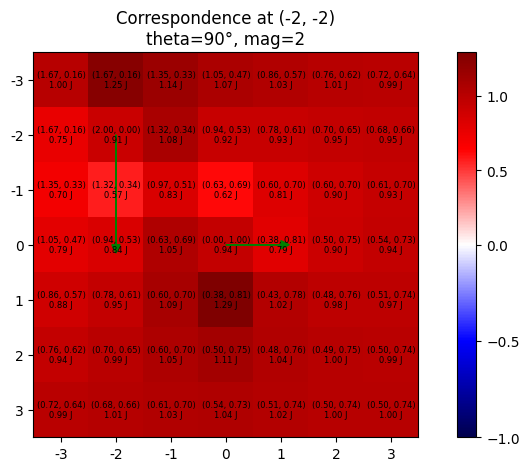

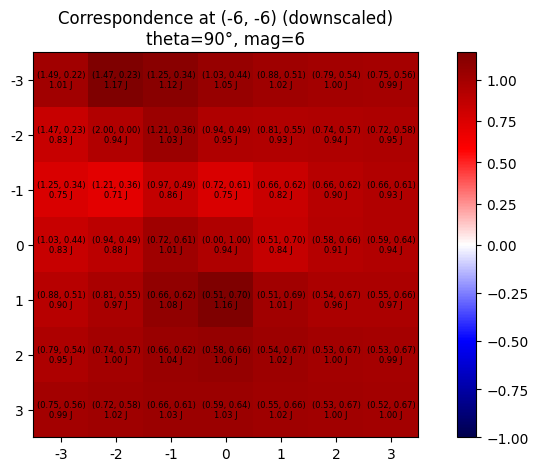

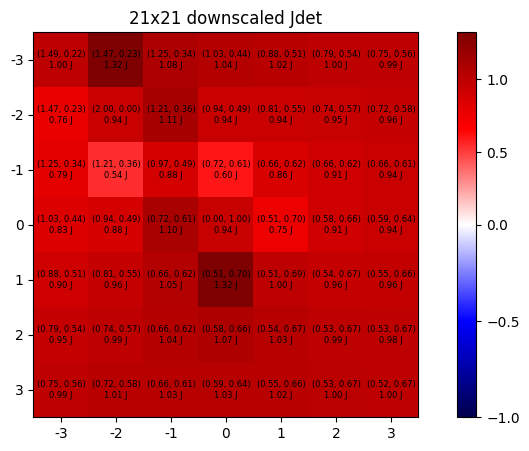

Correlation: 0.9889686446061554


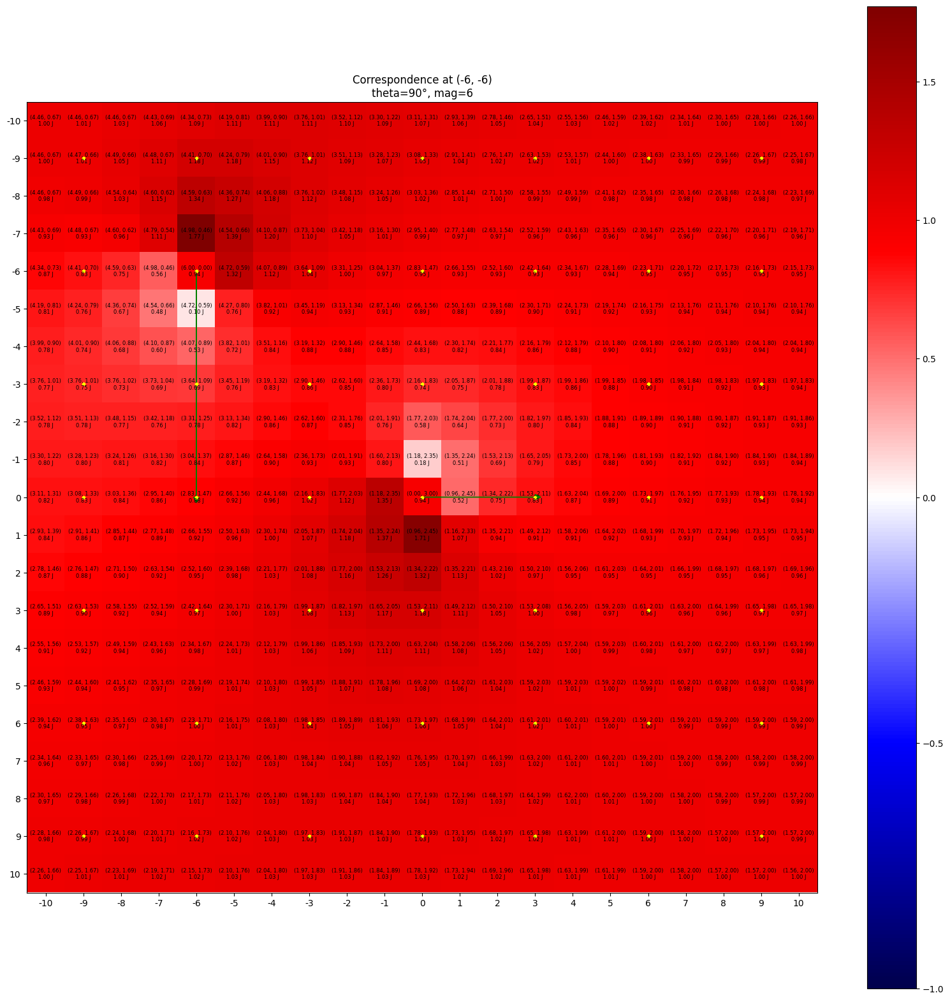

Central Jacobian determinant: 0.9400652749507911
Central Jacobian determinant: 0.9498341706135499


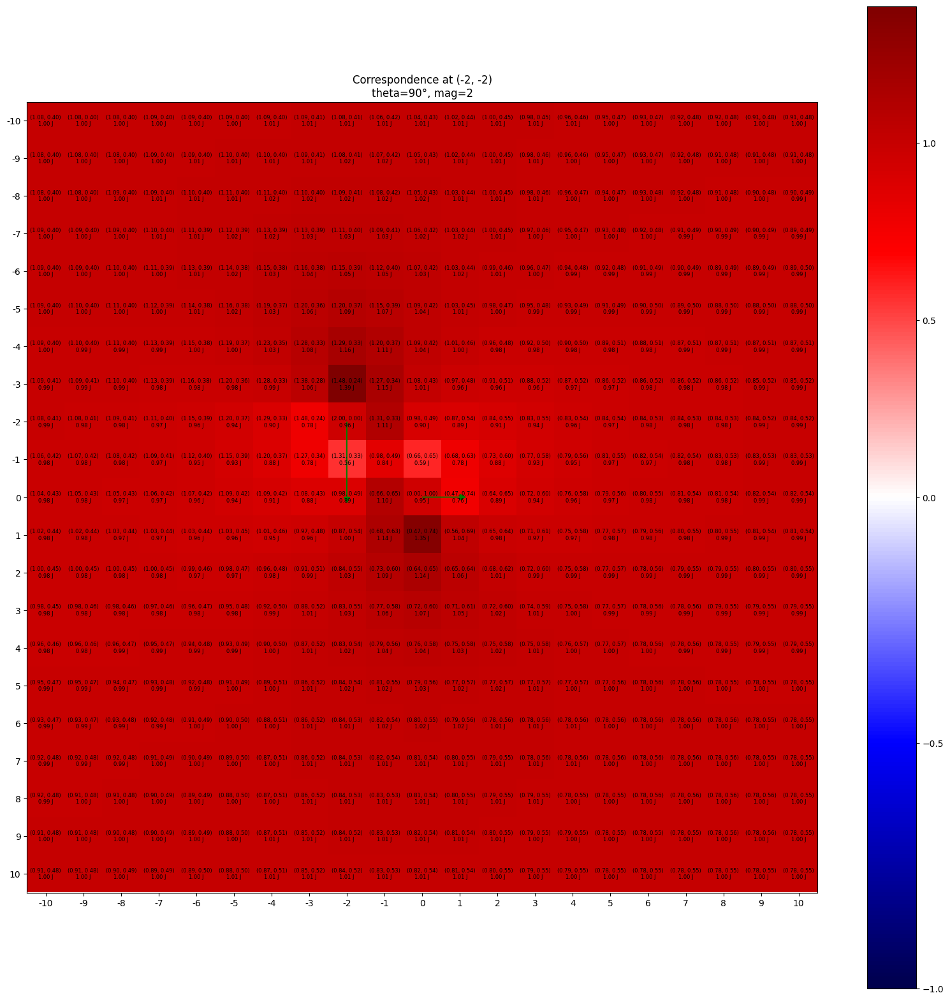

In [41]:
# Neighboring correspondence parameters
oy, ox = (-2, -2)
angle = 90
magnitude = 2

_, _ = run_case(oy, ox, angle, magnitude, n=n, x_1_case=USE_X_1_CASE, multiplier=MULTIPLIER)
run_case_custom(oy, ox, angle, magnitude, n=21, x_1_case=USE_X_1_CASE, multiplier=MULTIPLIER)

In [ ]:
# Neighboring correspondence parameters
oy, ox = (-3, 3)
angle = 180
magnitude = 4

_, _ = run_case(oy, ox, angle, magnitude, n=n, x_1_case=USE_X_1_CASE, multiplier=MULTIPLIER)

In [14]:
# Neighboring correspondence parameters
oy, ox = (-2, -2)
angle = 0
magnitude = 2

run_case(oy, ox, angle, magnitude, n=n, x_1_case=USE_X_1_CASE, multiplier=MULTIPLIER)
#run_case(oy, ox, angle, magnitude, n=n, x_1_case=USE_X_1_CASE, multiplier=9)

Central Jacobian determinant: 0.9381143261376081


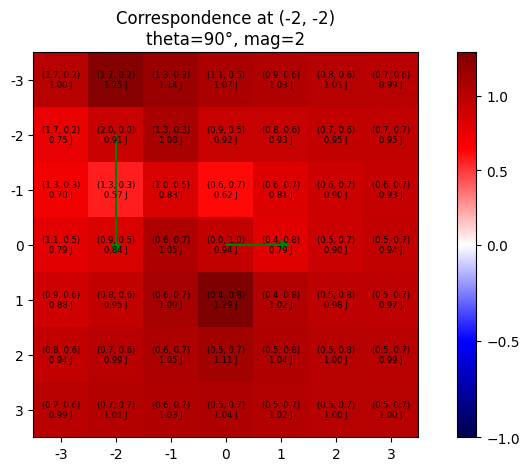

(3, 1, 7, 7)


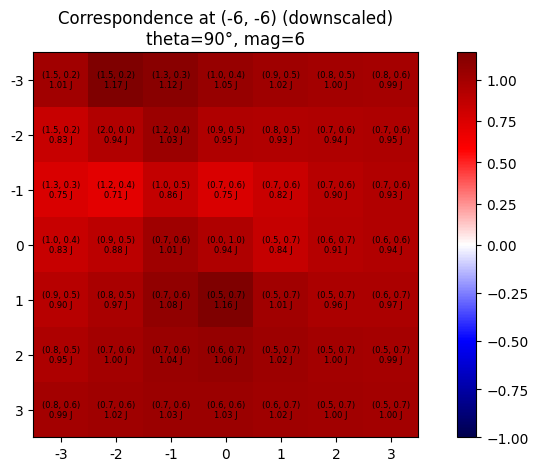

(3, 1, 7, 7)


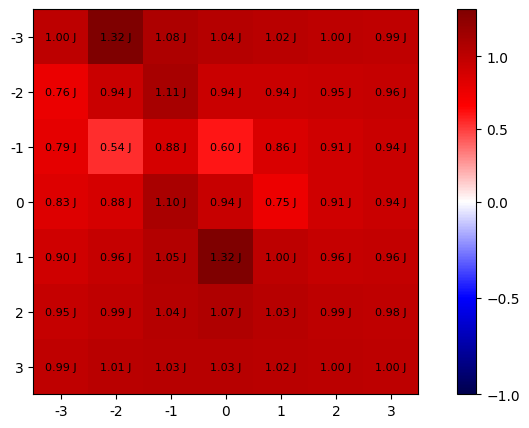

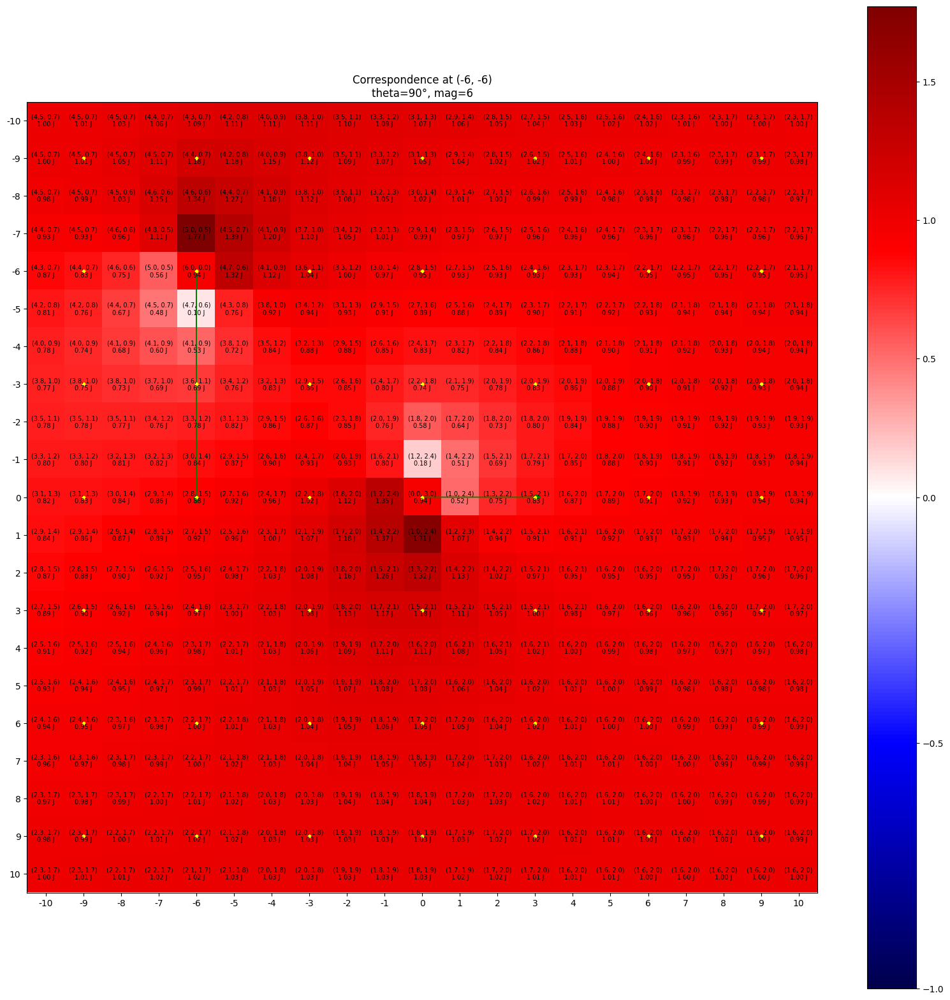

Correlation: 0.9889686446061554
Central Jacobian determinant: 0.9400652749507911


(array([[1.0001717 , 1.24589916, 1.14006413, 1.0663474 , 1.02920325, 1.00814385, 0.98972891],
        [0.75401705, 0.9108285 , 1.07759697, 0.92293486, 0.92640174, 0.94565682, 0.95050952],
        [0.69655194, 0.56502352, 0.82772768, 0.62176952, 0.80889559, 0.89710696, 0.93072595],
        [0.78600712, 0.83650143, 1.04798816, 0.93811433, 0.79178826, 0.90160762, 0.94172579],
        [0.87791479, 0.94727172, 1.08524509, 1.29087508, 1.02434269, 0.97561956, 0.97382336],
        [0.94225144, 0.98896176, 1.05410833, 1.10639287, 1.03819213, 1.00185518, 0.99229953],
        [0.98886332, 1.01357335, 1.03481613, 1.0409725 , 1.01940028, 1.00339545, 0.99855595]]),
 array([[1.01033169, 1.16607602, 1.11773606, 1.05048467, 1.01519578, 0.99800575, 0.98760853],
        [0.83414364, 0.93588069, 1.03292685, 0.94560373, 0.93002842, 0.94486526, 0.95301834],
        [0.75290772, 0.70650623, 0.85618413, 0.75225039, 0.82426585, 0.90204081, 0.93162338],
        [0.83059499, 0.88370648, 1.013494  , 0.94032074, 0

In [123]:
# Neighboring correspondence parameters
oy, ox = (-2, -2)
angle = 90
magnitude = 2

run_case(oy, ox, angle, magnitude, n=n, x_1_case=USE_X_1_CASE, multiplier=MULTIPLIER)

Central Jacobian determinant: 0.8162653425023563


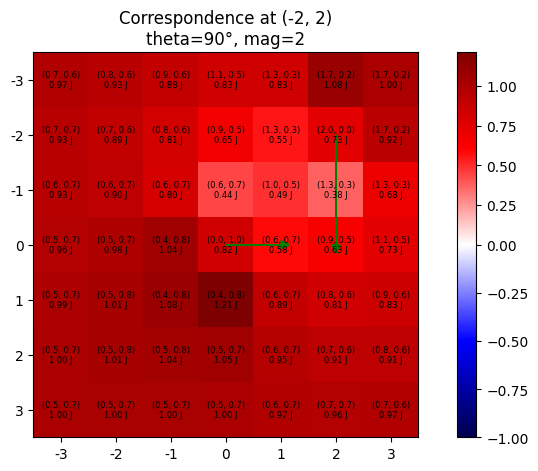

(3, 1, 7, 7)


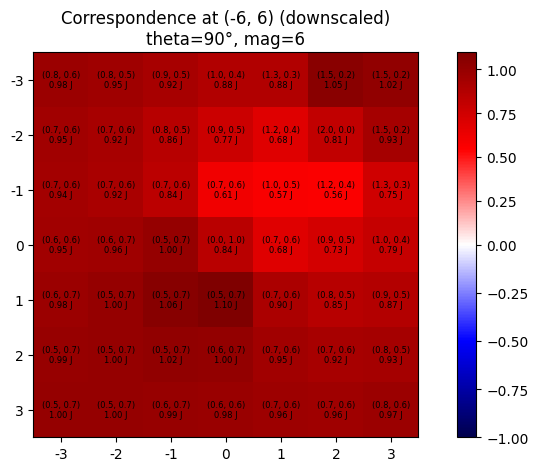

(3, 1, 7, 7)


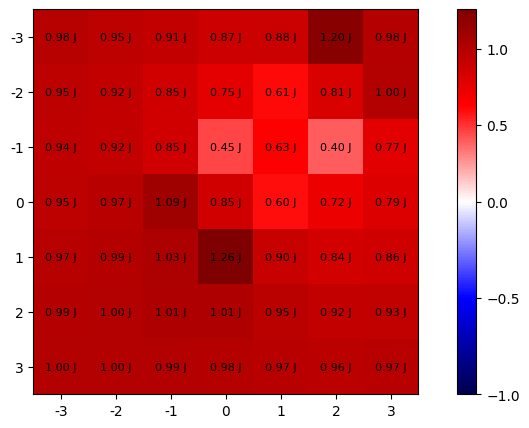

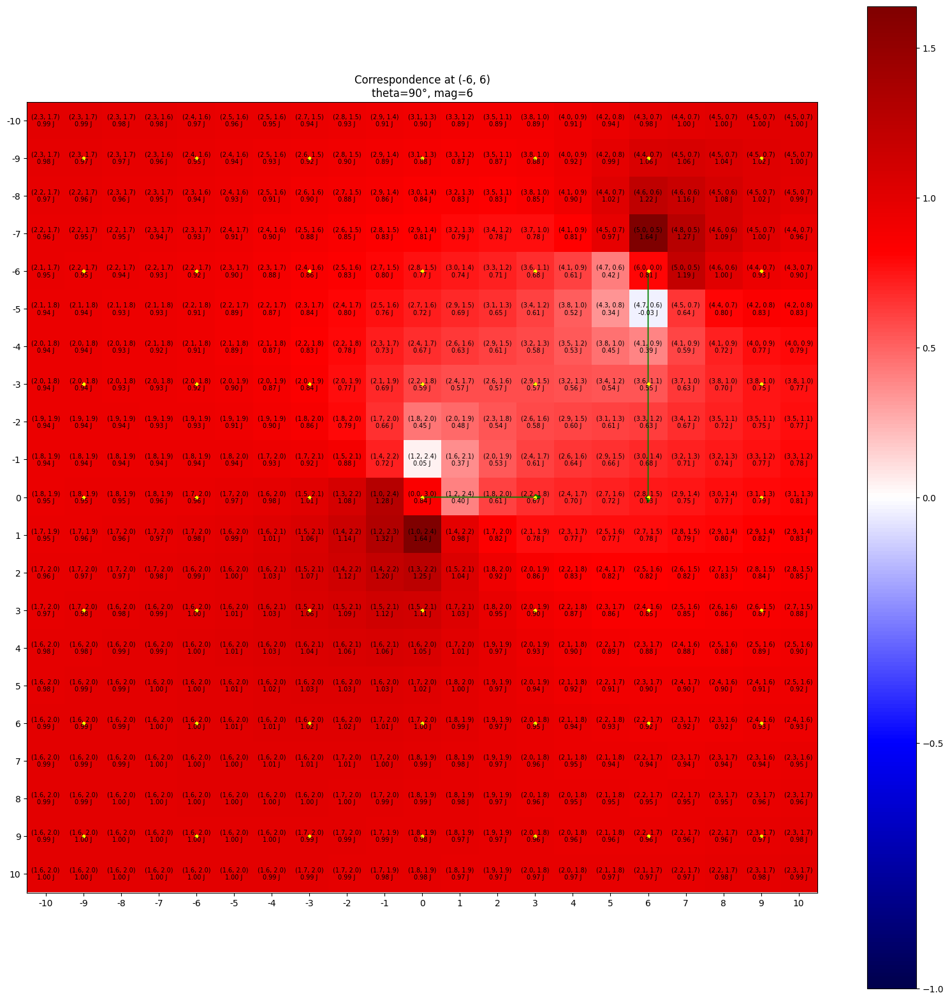

Correlation: 0.9935758243776713
Central Jacobian determinant: 0.8433746515328122


(array([[0.96656423, 0.93340938, 0.88430914, 0.82603497, 0.82952731, 1.08108011, 0.99885631],
        [0.93492493, 0.89356909, 0.80737418, 0.6547839 , 0.54878457, 0.73156546, 0.91781349],
        [0.93106436, 0.89987855, 0.79646983, 0.43536308, 0.4850805 , 0.37786296, 0.68093144],
        [0.95990551, 0.97938908, 1.04338725, 0.81626534, 0.5773077 , 0.62532099, 0.73189435],
        [0.98611825, 1.01336818, 1.07616325, 1.21053045, 0.88864383, 0.8142809 , 0.83446697],
        [0.99772086, 1.01277439, 1.03591044, 1.04880103, 0.95353845, 0.90980725, 0.91373681],
        [1.00050513, 1.00393025, 1.00426998, 0.99539933, 0.96821953, 0.95799368, 0.96796381]]),
 array([[0.97502183, 0.95294405, 0.91725444, 0.87586043, 0.88281795, 1.04637493, 1.01713618],
        [0.94562825, 0.91785675, 0.85572127, 0.76575236, 0.68360801, 0.80591897, 0.92722509],
        [0.93541919, 0.91561429, 0.83514472, 0.60661315, 0.5712814 , 0.56261589, 0.74755929],
        [0.94974554, 0.95995001, 1.00047939, 0.8436174 , 0

In [124]:
# Neighboring correspondence parameters
oy, ox = (-2, 2)
angle = 90
magnitude = 2

run_case(oy, ox, angle, magnitude, n=n, x_1_case=USE_X_1_CASE, multiplier=MULTIPLIER)

Central Jacobian determinant: 0.8878189414893449


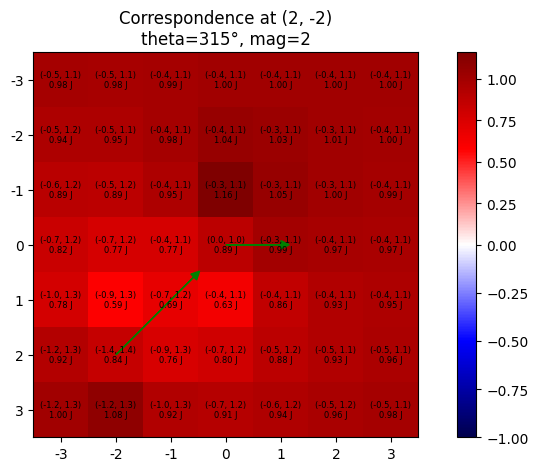

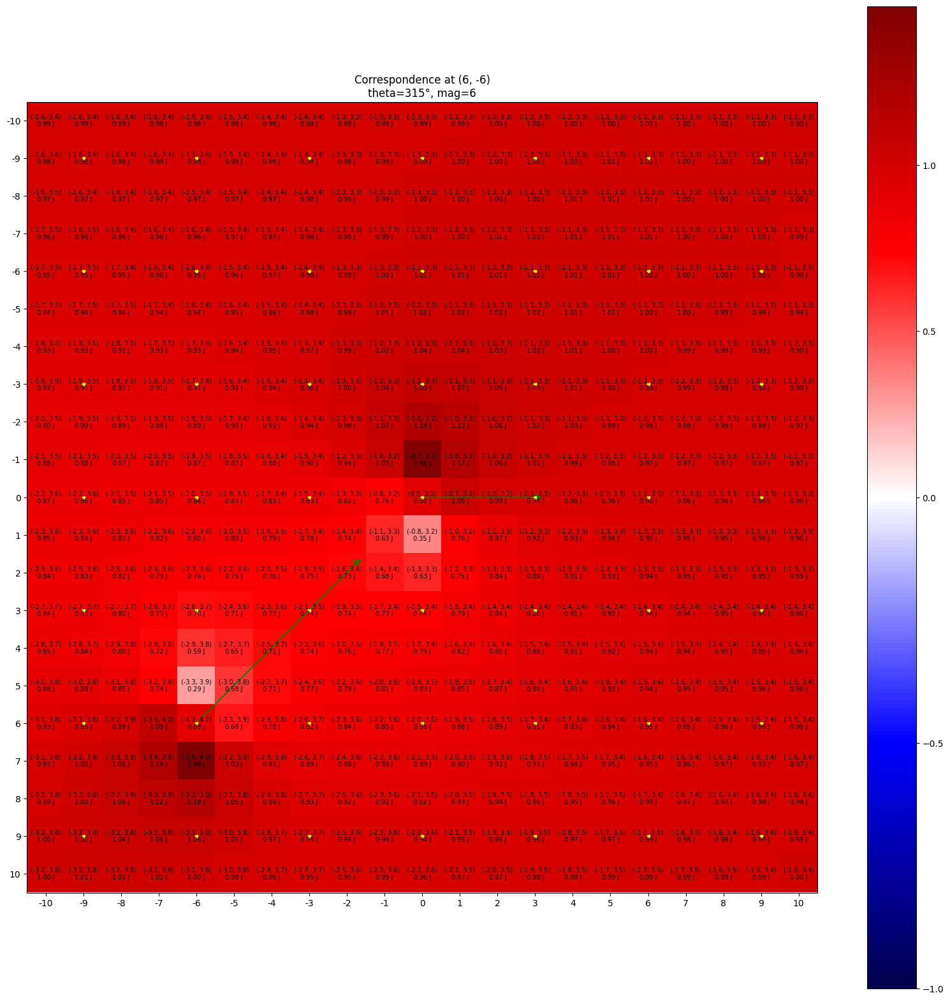

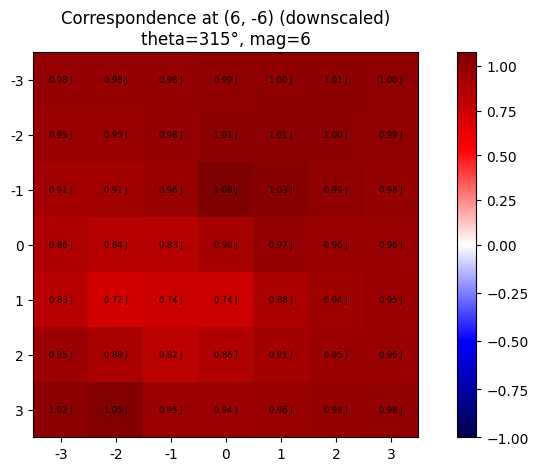

Correlation: 0.990795944885807
Central Jacobian determinant: 0.9036386930816327


(array([[0.98024585, 0.97767196, 0.98645406, 1.00295717, 1.00404825, 1.00034702, 0.99867757],
        [0.94298705, 0.94684506, 0.98120702, 1.04299126, 1.02523714, 1.0058005 , 0.99637752],
        [0.88957871, 0.88809812, 0.94975138, 1.16039712, 1.04598711, 1.00326882, 0.98772131],
        [0.81844075, 0.76605001, 0.76987546, 0.88781894, 0.99345677, 0.97332188, 0.9684816 ],
        [0.77683784, 0.58771565, 0.68584248, 0.62765901, 0.85750377, 0.92842624, 0.95104497],
        [0.91795823, 0.83663761, 0.75845049, 0.79511808, 0.88150359, 0.93217618, 0.95591212],
        [0.99974989, 1.08185749, 0.92483636, 0.91206686, 0.94008619, 0.96411122, 0.97933919]]),
 array([[0.98109462, 0.97624281, 0.98166539, 0.99244848, 1.00149051, 1.00506484, 0.99998045],
        [0.95150138, 0.95410213, 0.97738942, 1.00771471, 1.0120163 , 1.00364016, 0.99458577],
        [0.91258736, 0.91433107, 0.96042283, 1.07552326, 1.027095  , 0.99188731, 0.98165139],
        [0.86034531, 0.83795621, 0.83261022, 0.90363925, 0

In [48]:
# Neighboring correspondence parameters
oy, ox = (2, -2)
angle = 315
magnitude = 2

run_case(oy, ox, angle, magnitude, n=n, x_1_case=USE_X_1_CASE, multiplier=MULTIPLIER)

Central Jacobian determinant: 0.8487175450437766


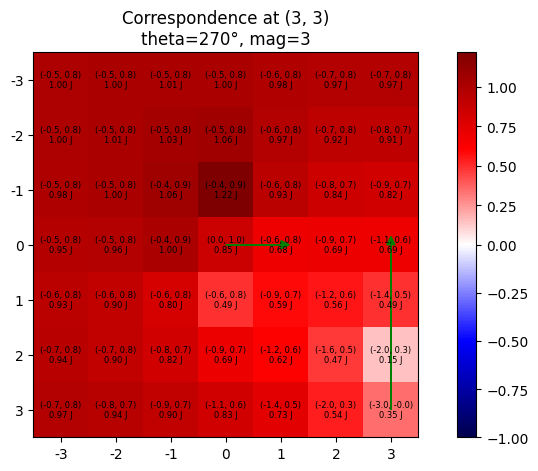

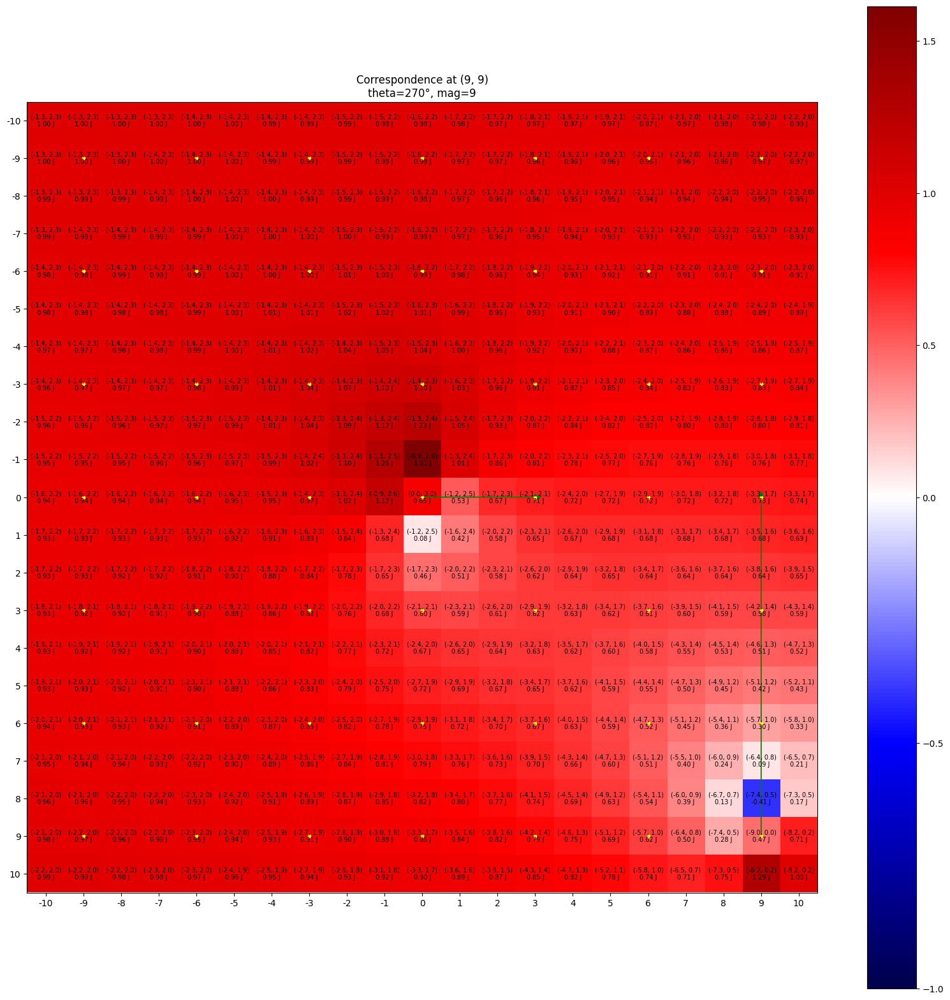

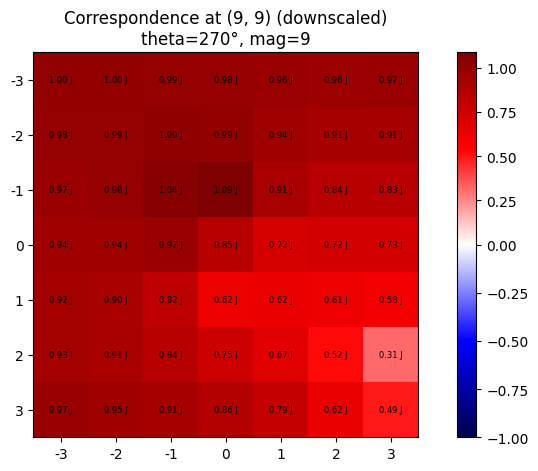

Correlation: 0.9944159436649652
Central Jacobian determinant: 0.8459552427747368


(array([[0.99986216, 1.00295031, 1.00565988, 1.00178875, 0.97881457, 0.96691556, 0.9705264 ],
        [0.99705788, 1.00991125, 1.03449019, 1.05708017, 0.97204147, 0.92407511, 0.91421143],
        [0.98260589, 1.00413789, 1.06453175, 1.22023062, 0.92977439, 0.84260907, 0.82421684],
        [0.95473045, 0.96467685, 1.00113561, 0.84871755, 0.68386395, 0.69331125, 0.68563169],
        [0.93006072, 0.90040912, 0.8035735 , 0.48792599, 0.58781658, 0.55997416, 0.49051754],
        [0.93791265, 0.90239529, 0.82455705, 0.68901441, 0.61932589, 0.46777742, 0.15223496],
        [0.97131366, 0.94467523, 0.89867697, 0.82611473, 0.73405834, 0.54016451, 0.34612069]]),
 array([[0.99604828, 0.99652488, 0.99246193, 0.9801426 , 0.96372114, 0.95786716, 0.9655718 ],
        [0.98467765, 0.99218678, 1.00477201, 0.99398812, 0.94300067, 0.90963764, 0.90823057],
        [0.96634367, 0.98238879, 1.03630964, 1.08594571, 0.90611222, 0.83791849, 0.83209136],
        [0.94169599, 0.94458981, 0.96722236, 0.84593796, 0

In [49]:
# Neighboring correspondence parameters
oy, ox = (3, 3)
angle = 270
magnitude = 3

run_case(oy, ox, angle, magnitude, n=n, x_1_case=USE_X_1_CASE, multiplier=MULTIPLIER)

Central Jacobian determinant: 1.447759531518034


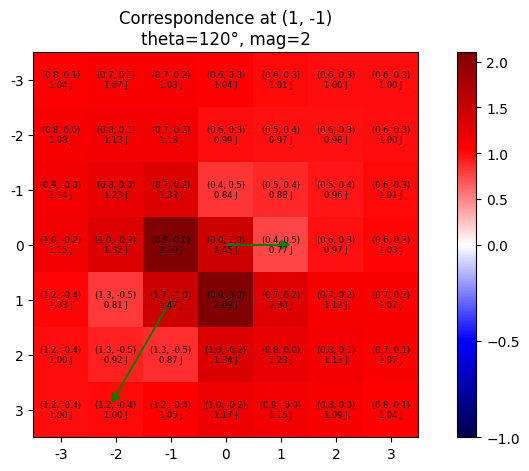

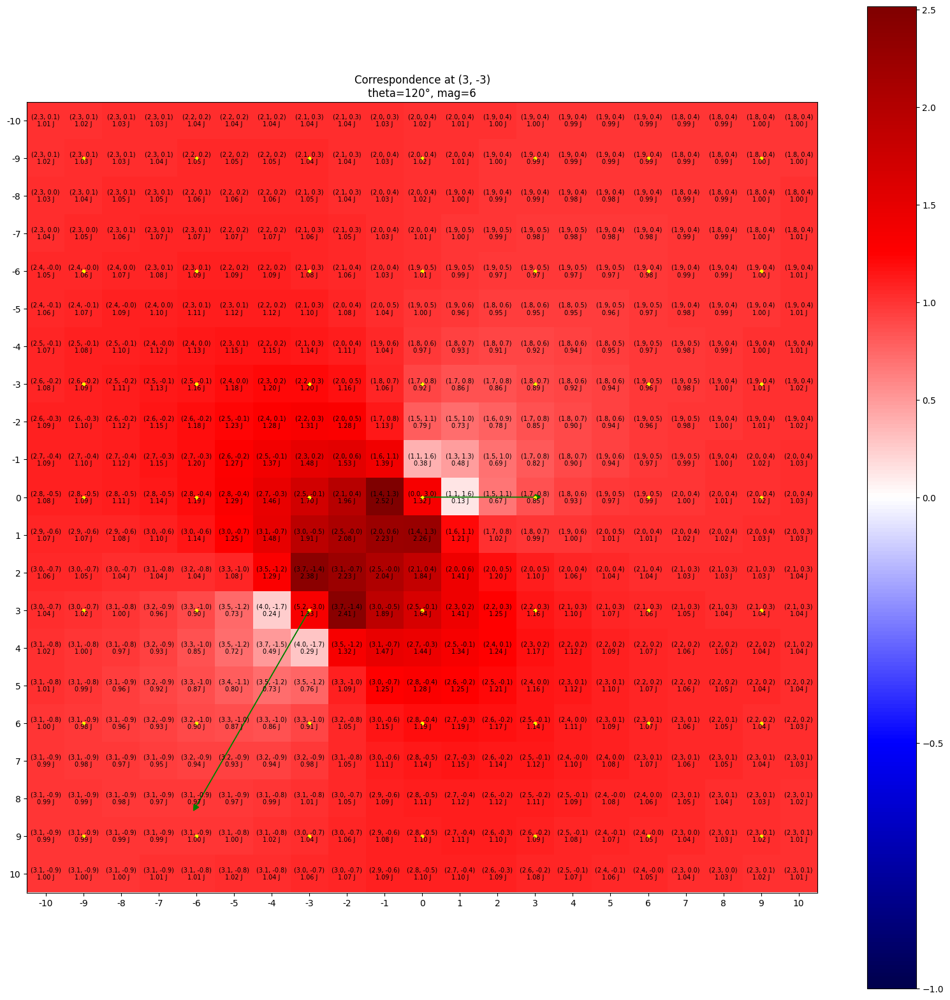

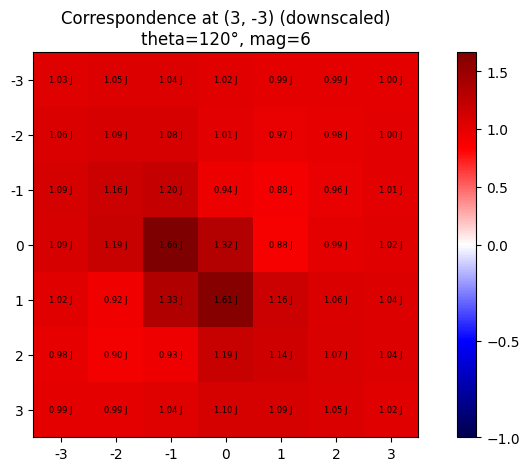

Correlation: 0.9920136385256147
Central Jacobian determinant: 1.321535160230732


(array([[1.03966724, 1.07367614, 1.08082313, 1.0411139 , 1.01115616, 1.00054736, 0.99951439],
        [1.08464755, 1.1302867 , 1.13282191, 0.9947328 , 0.96886918, 0.98255809, 0.9987799 ],
        [1.13606291, 1.22969676, 1.32519339, 0.8365025 , 0.88469455, 0.96180173, 1.00711623],
        [1.15430002, 1.32364434, 2.10090628, 1.44775953, 0.76922512, 0.96939454, 1.03001061],
        [1.02980788, 0.80950794, 1.46591607, 2.0867495 , 1.299575  , 1.11576667, 1.0697102 ],
        [0.99616054, 0.91850635, 0.86644972, 1.33819393, 1.22771102, 1.12638988, 1.06865501],
        [0.99869897, 1.00158278, 1.05086098, 1.17118363, 1.14632446, 1.08992246, 1.04000048]]),
 array([[1.02697024, 1.04663359, 1.04473915, 1.01837861, 0.99381905, 0.98833381, 0.99744979],
        [1.06105256, 1.08914433, 1.07906667, 1.00721337, 0.96670836, 0.97867223, 1.0016907 ],
        [1.09338965, 1.15777221, 1.20412122, 0.93624485, 0.88417773, 0.96411329, 1.00720728],
        [1.09078021, 1.1931696 , 1.66369588, 1.32287642, 0

In [50]:
# Neighboring correspondence parameters
oy, ox = (1, -1)
angle = 120
magnitude = 2

run_case(oy, ox, angle, magnitude, n=n, x_1_case=USE_X_1_CASE, multiplier=MULTIPLIER)

Central Jacobian determinant: 0.8246638700000957


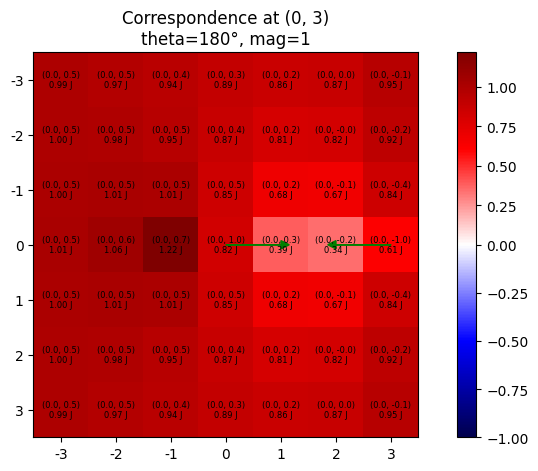

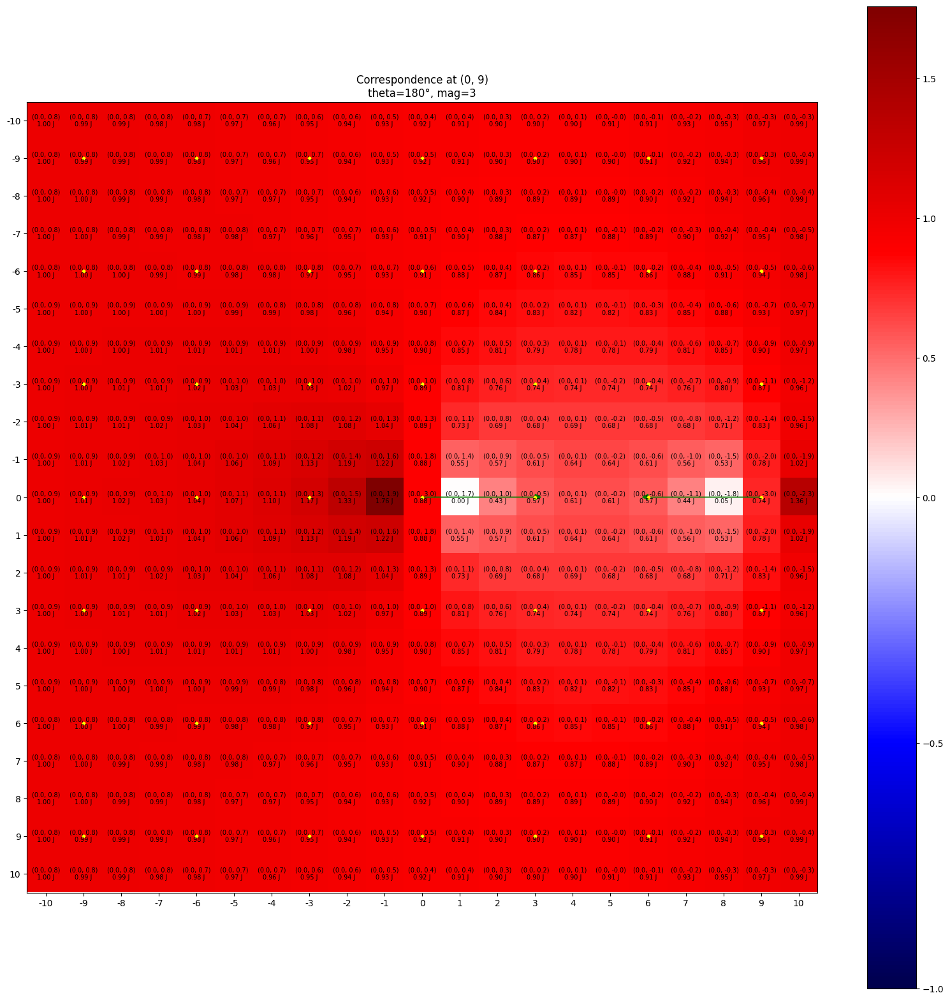

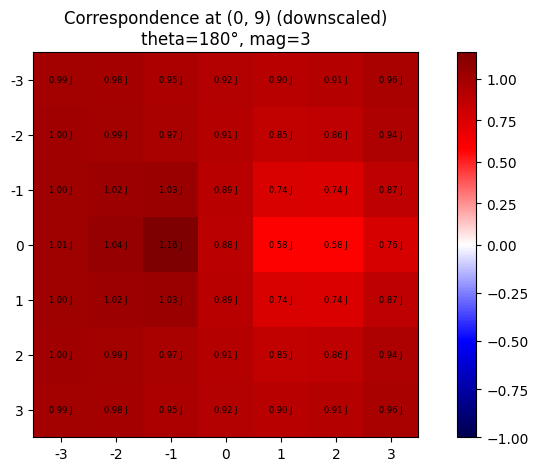

Correlation: 0.9924831157415731
Central Jacobian determinant: 0.8829609844076255


(array([[0.99126158, 0.96928799, 0.93546996, 0.88891365, 0.85698004, 0.87430666, 0.94879672],
        [0.99535215, 0.98178703, 0.9491269 , 0.87267716, 0.80660387, 0.81783345, 0.92121472],
        [1.00478586, 1.01420502, 1.00640224, 0.84550004, 0.6778238 , 0.66962339, 0.84031654],
        [1.01475469, 1.06458464, 1.21739892, 0.82466387, 0.38866827, 0.34296749, 0.61139412],
        [1.00478586, 1.01420502, 1.00640224, 0.84550004, 0.6778238 , 0.66962339, 0.84031654],
        [0.99535215, 0.98178703, 0.9491269 , 0.87267716, 0.80660387, 0.81783345, 0.92121472],
        [0.99126158, 0.96928799, 0.93546996, 0.88891365, 0.85698004, 0.87430666, 0.94879672]]),
 array([[0.99479288, 0.97907742, 0.9528611 , 0.91774437, 0.89569284, 0.91040899, 0.96388396],
        [0.99788727, 0.98995254, 0.96694443, 0.90736714, 0.85491757, 0.8641482 , 0.94171861],
        [1.00495085, 1.01939392, 1.03131281, 0.891609  , 0.74258294, 0.74049346, 0.87264977],
        [1.00954452, 1.04367769, 1.15880886, 0.88300444, 0

In [51]:
# Neighboring correspondence parameters
oy, ox = (0, 3)
angle = 180
magnitude = 1

run_case(oy, ox, angle, magnitude, n=n, x_1_case=USE_X_1_CASE, multiplier=MULTIPLIER)

### Scaling test 1

Central Jacobian determinant: 0.5368158635215001


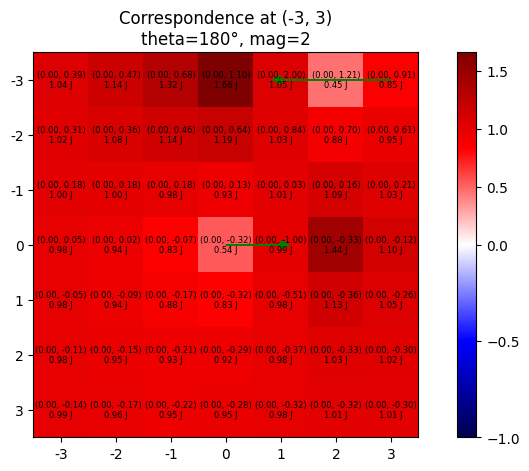

Central Jacobian determinant: 0.3487618822458567


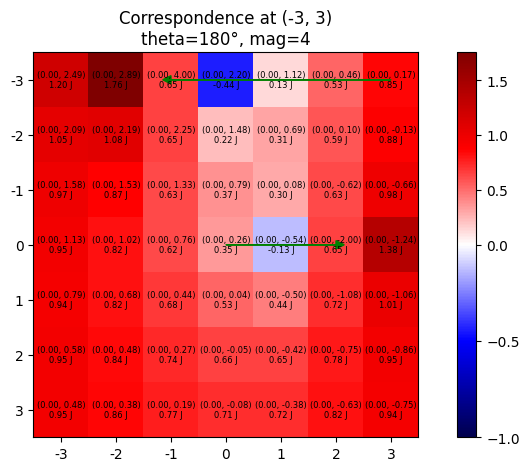

Central Jacobian determinant: 0.350615137338374


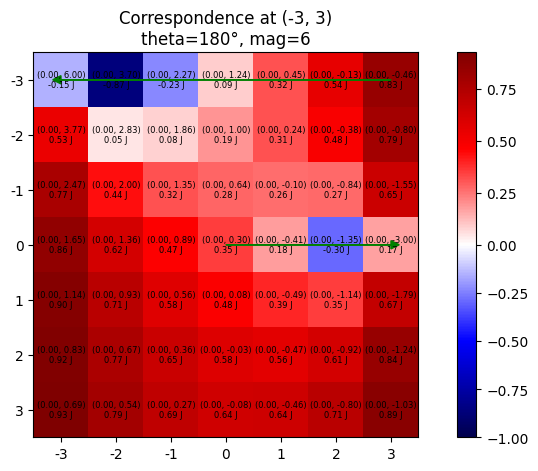

(array([[-0.14900835, -0.86554346, -0.23301132,  0.09019005,  0.31660353,  0.54448993,  0.83455265],
        [ 0.53293951,  0.04759237,  0.08188381,  0.19064599,  0.3114705 ,  0.47895926,  0.7909038 ],
        [ 0.76691683,  0.4391241 ,  0.31679595,  0.27872464,  0.26019258,  0.27311895,  0.64706233],
        [ 0.85696226,  0.61954535,  0.46608933,  0.35061514,  0.17830729, -0.295568  ,  0.17323361],
        [ 0.89672157,  0.71272079,  0.57565841,  0.47572412,  0.39143747,  0.34799381,  0.67262127],
        [ 0.91669072,  0.76589202,  0.65252953,  0.58075336,  0.55676067,  0.61476382,  0.83542827],
        [ 0.92506277,  0.79082816,  0.69153598,  0.63566109,  0.63626782,  0.71409675,  0.88771944]]),
 array([[-0.02561082, -0.6593419 , -0.08348028,  0.21034169,  0.42561591,  0.63597383,  0.87044881],
        [ 0.5214354 ,  0.0619914 ,  0.153442  ,  0.28982536,  0.42166441,  0.5794815 ,  0.83475645],
        [ 0.78657049,  0.49237214,  0.39917609,  0.39418858,  0.39533698,  0.39196437,  0

In [22]:
# Neighboring correspondence parameters
oy, ox = (-3, 3)
angle = 180
magnitude = 3
base_magnitude = 3
MULTIPLIER = 3
USE_X_1_CASE = False

run_case(oy, ox, angle, 2, n=n, x_1_case=USE_X_1_CASE, multiplier=MULTIPLIER, base_magnitude=1, show_downsampled=False, show_upscaled=False)
run_case(oy, ox, angle, 4, n=n, x_1_case=USE_X_1_CASE, multiplier=MULTIPLIER, base_magnitude=2, show_downsampled=False, show_upscaled=False)
run_case(oy, ox, angle, 6, n=n, x_1_case=USE_X_1_CASE, multiplier=MULTIPLIER, base_magnitude=3, show_downsampled=False, show_upscaled=False)

Central Jacobian determinant: 0.6669414273398576


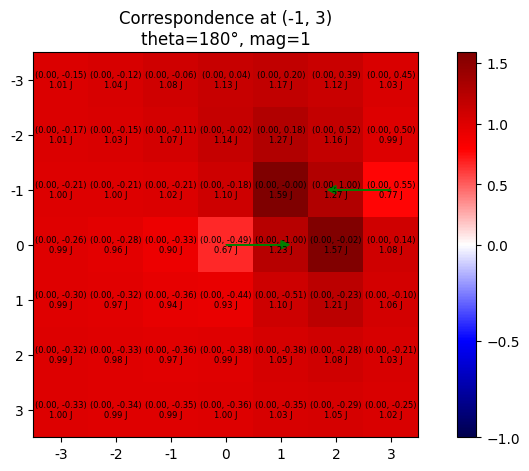

Central Jacobian determinant: 0.8217739884353514


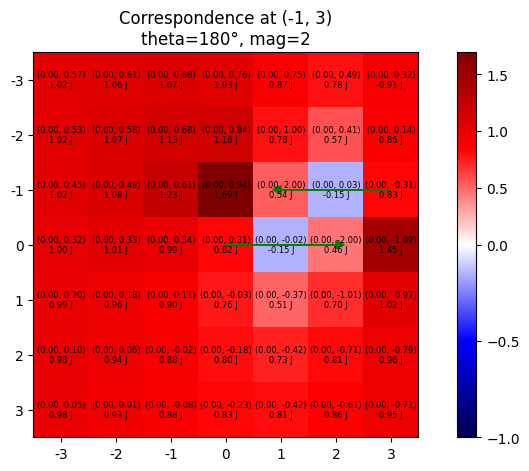

Central Jacobian determinant: 0.49576374635532894


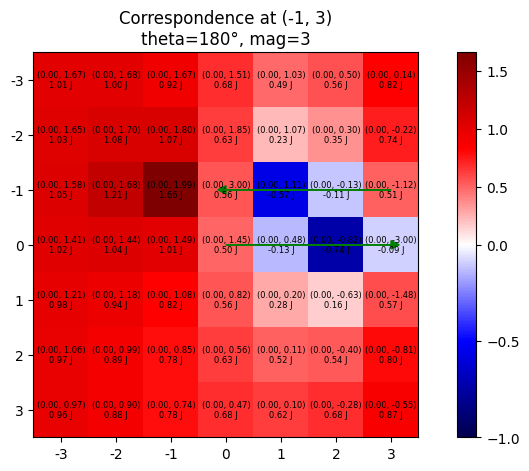

(array([[ 1.0076808 ,  1.00068784,  0.91656268,  0.68052134,  0.49112077,  0.55809546,  0.82394038],
        [ 1.02715679,  1.07708783,  1.07158239,  0.63387374,  0.22907521,  0.35485571,  0.73800289],
        [ 1.04982311,  1.20778212,  1.6612924 ,  0.55657155, -0.5652063 , -0.11076137,  0.50768309],
        [ 1.01522091,  1.04183993,  1.00515217,  0.49576375, -0.13364348, -0.74129574, -0.09042167],
        [ 0.98395929,  0.93590015,  0.82077877,  0.55657155,  0.27530733,  0.1611206 ,  0.57354691],
        [ 0.9688743 ,  0.89433706,  0.78389701,  0.63387374,  0.51676059,  0.53760648,  0.79628538],
        [ 0.96401567,  0.88293681,  0.78387232,  0.68052134,  0.62381113,  0.6758465 ,  0.86760551]]),
 array([[ 1.01679329,  1.02728003,  0.96400564,  0.770798  ,  0.61350917,  0.66299677,  0.8667667 ],
        [ 1.0290464 ,  1.09392944,  1.13783418,  0.73984585,  0.36254325,  0.49616693,  0.8005184 ],
        [ 1.0363364 ,  1.14897734,  1.49204889,  0.69296993, -0.13269733,  0.1660239 ,  0

In [44]:
# Neighboring correspondence parameters
oy, ox = (-1, 3)
angle = 180
magnitude = 3
base_magnitude = 3
MULTIPLIER = 3
USE_X_1_CASE = False

run_case(oy, ox, angle, 1, n=n, x_1_case=USE_X_1_CASE, multiplier=MULTIPLIER, base_magnitude=1, show_downsampled=False, show_upscaled=False)
run_case(oy, ox, angle, 2, n=n, x_1_case=USE_X_1_CASE, multiplier=MULTIPLIER, base_magnitude=2, show_downsampled=False, show_upscaled=False)
run_case(oy, ox, angle, 3, n=n, x_1_case=USE_X_1_CASE, multiplier=MULTIPLIER, base_magnitude=3, show_downsampled=False, show_upscaled=False)

Central Jacobian determinant: 0.7477789204232682


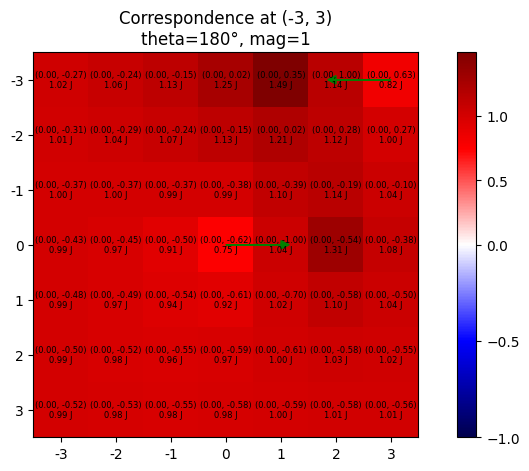

Central Jacobian determinant: 0.7000232147046029


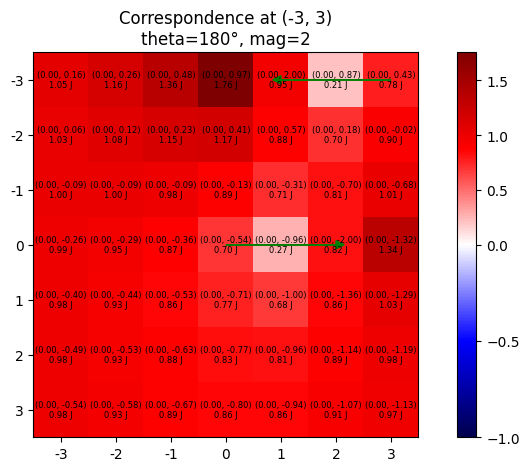

Central Jacobian determinant: 0.6031594379720618


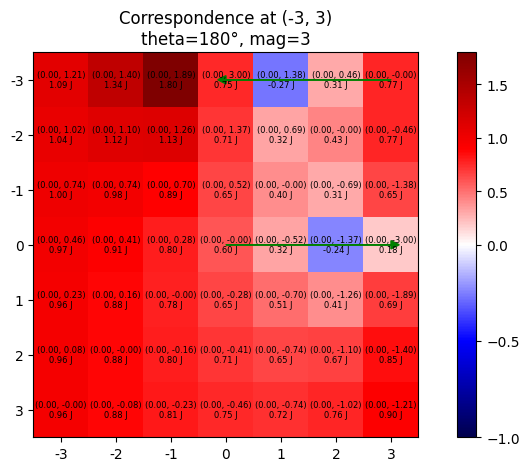

(array([[ 1.09438889,  1.33736915,  1.7990272 ,  0.74782415, -0.26954064,  0.30823976,  0.7695576 ],
        [ 1.04325087,  1.12314447,  1.13149   ,  0.71187959,  0.31621907,  0.42549348,  0.7695576 ],
        [ 0.99997042,  0.98116364,  0.89030005,  0.6507218 ,  0.39755084,  0.30823976,  0.65230389],
        [ 0.9744997 ,  0.90872805,  0.79577282,  0.60315944,  0.31621907, -0.241598  ,  0.1837979 ],
        [ 0.96402587,  0.8840613 ,  0.7815799 ,  0.6507218 ,  0.506271  ,  0.40534211,  0.68824844],
        [ 0.96147337,  0.8815088 ,  0.79577282,  0.71187959,  0.65193625,  0.66712915,  0.8513351 ],
        [ 0.96147337,  0.8840613 ,  0.80879915,  0.74782415,  0.72068742,  0.76154762,  0.90247313]]),
 array([[1.07726919, 1.26363698, 1.61486217, 0.79466147, 0.01028775, 0.46996737, 0.82584671],
        [1.04459852, 1.12880955, 1.15643661, 0.77108433, 0.40772166, 0.5205699 , 0.81170698],
        [1.00880221, 1.00867995, 0.93758487, 0.73532712, 0.51274019, 0.39925972, 0.68413952],
        [

In [23]:
# Neighboring correspondence parameters
oy, ox = (-3, 3)
angle = 180
magnitude = 3
base_magnitude = 3
MULTIPLIER = 3
USE_X_1_CASE = False

run_case(oy, ox, angle, 1, n=n, x_1_case=USE_X_1_CASE, multiplier=MULTIPLIER, base_magnitude=1, show_downsampled=False, show_upscaled=False)
run_case(oy, ox, angle, 2, n=n, x_1_case=USE_X_1_CASE, multiplier=MULTIPLIER, base_magnitude=2, show_downsampled=False, show_upscaled=False)
run_case(oy, ox, angle, 3, n=n, x_1_case=USE_X_1_CASE, multiplier=MULTIPLIER, base_magnitude=3, show_downsampled=False, show_upscaled=False)

Central Jacobian determinant: 1.241798428605141


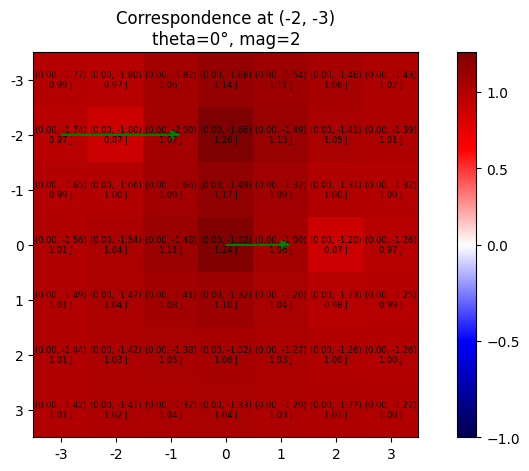

Central Jacobian determinant: 1.1648301529299125


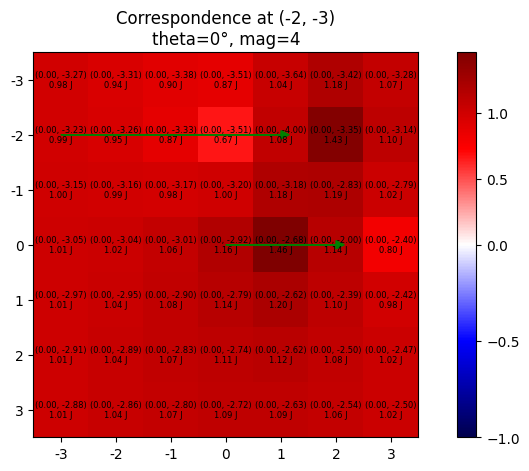

Central Jacobian determinant: 1.0721237727023762


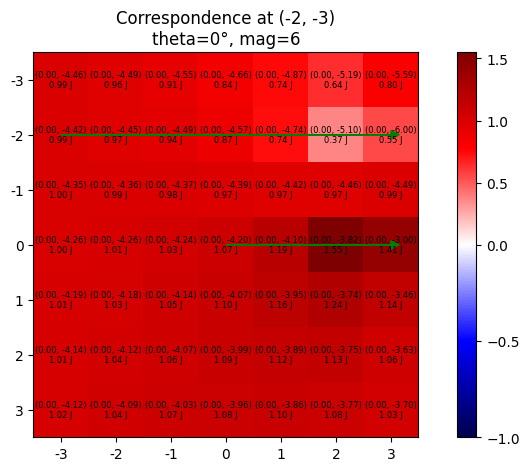

(array([[0.98592708, 0.95674796, 0.91462107, 0.84183493, 0.73863925, 0.6392497 , 0.79864519],
        [0.98929458, 0.96813621, 0.93612506, 0.8736356 , 0.73761871, 0.37051613, 0.54924959],
        [0.99589046, 0.98982496, 0.98357115, 0.97468288, 0.96707636, 0.96780202, 0.98577189],
        [1.00274576, 1.01129173, 1.02993008, 1.07212377, 1.18844129, 1.5491177 , 1.41141608],
        [1.00796975, 1.02674345, 1.05347206, 1.09608988, 1.16298647, 1.2439789 , 1.14238395],
        [1.01199389, 1.03641669, 1.06138849, 1.09138441, 1.12020244, 1.12633088, 1.06054717],
        [1.01525699, 1.04335029, 1.06622002, 1.08489121, 1.0959076 , 1.08324928, 1.03410617]]),
 array([[0.97057733, 0.91388742, 0.86177934, 0.80194945, 0.72415548, 0.64202853, 0.80135325],
        [0.97450815, 0.92721425, 0.88319484, 0.83431128, 0.7567306 , 0.53097293, 0.67806489],
        [0.98106523, 0.94603351, 0.91791424, 0.89789695, 0.89277503, 0.90637057, 0.95854652],
        [0.98643251, 0.96405107, 0.95249565, 0.95907607, 1

In [47]:
# Neighboring correspondence parameters
oy, ox = (-2, -3)
angle = 0
magnitude = 3
base_magnitude = 3
MULTIPLIER = 3
USE_X_1_CASE = False

run_case(oy, ox, angle, 2, n=n, x_1_case=USE_X_1_CASE, multiplier=MULTIPLIER, base_magnitude=1, show_downsampled=False, show_upscaled=False, )
run_case(oy, ox, angle, 4, n=n, x_1_case=USE_X_1_CASE, multiplier=MULTIPLIER, base_magnitude=2, show_downsampled=False, show_upscaled=False)
run_case(oy, ox, angle, 6, n=n, x_1_case=USE_X_1_CASE, multiplier=MULTIPLIER, base_magnitude=3, show_downsampled=False, show_upscaled=False)

Central Jacobian determinant: 0.9971416024105009


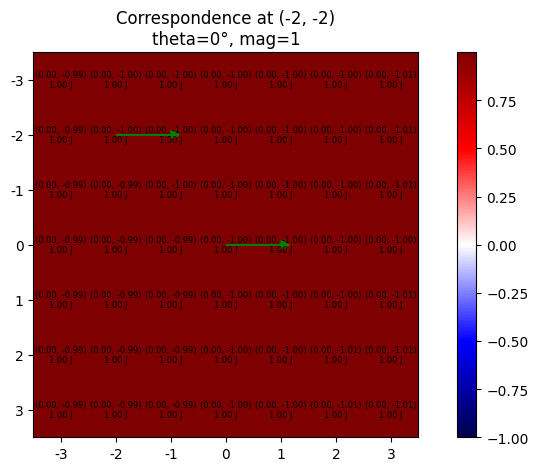

Central Jacobian determinant: 0.9993693775456567


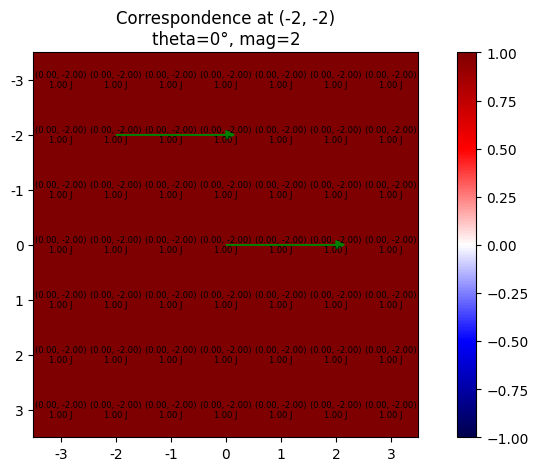

Central Jacobian determinant: 0.9990725643154728


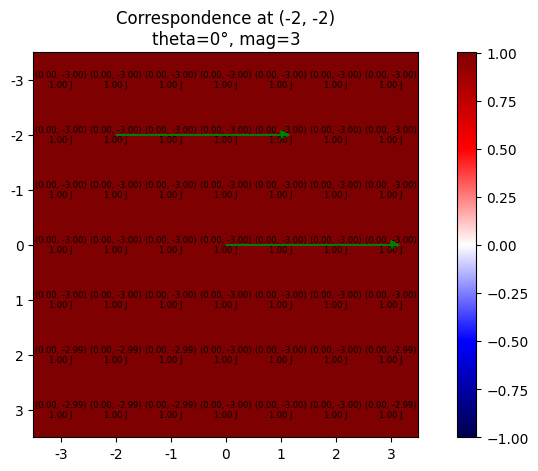

(array([[1.00100785, 1.00219851, 1.00078065, 0.99965426, 1.00047772, 1.00088267, 1.00046922],
        [1.00028227, 1.00026622, 0.9998169 , 0.99955949, 1.00047739, 1.00156598, 1.00081514],
        [1.00024701, 0.99984591, 0.99909891, 0.99983275, 1.00103535, 1.00120195, 1.00049934],
        [0.99941266, 0.99920703, 0.99872165, 0.99907256, 1.00097771, 1.00120735, 1.00037493],
        [0.99936363, 0.99852982, 0.9973092 , 0.99790237, 1.0007676 , 1.00234196, 1.00133372],
        [0.99873788, 0.99735475, 0.99671719, 0.99681533, 0.99954026, 1.00387349, 1.00304824],
        [0.9983179 , 0.99688451, 0.99666403, 0.99725448, 1.00043041, 1.00361126, 1.0023379 ]]),
 array([[0.98929183, 0.97852763, 0.98636545, 0.99480333, 1.01299229, 1.01903189, 1.00371329],
        [0.99492757, 0.98889158, 0.98690001, 0.98546561, 1.00841366, 1.02199792, 1.00611387],
        [0.99455106, 0.9932012 , 0.99221592, 0.99271918, 1.00437821, 1.00378418, 0.99855938],
        [0.99462421, 0.99007377, 0.99384431, 0.99463395, 0

In [24]:
# Neighboring correspondence parameters
oy, ox = (-2, -2)
angle = 0
magnitude = 3
base_magnitude = 3
MULTIPLIER = 3
USE_X_1_CASE = False

run_case(oy, ox, angle, 1, n=n, x_1_case=USE_X_1_CASE, multiplier=MULTIPLIER, base_magnitude=1, show_downsampled=False, show_upscaled=False, )
run_case(oy, ox, angle, 2, n=n, x_1_case=USE_X_1_CASE, multiplier=MULTIPLIER, base_magnitude=2, show_downsampled=False, show_upscaled=False)
run_case(oy, ox, angle, 3, n=n, x_1_case=USE_X_1_CASE, multiplier=MULTIPLIER, base_magnitude=3, show_downsampled=False, show_upscaled=False)

Central Jacobian determinant: 0.7694760507438189


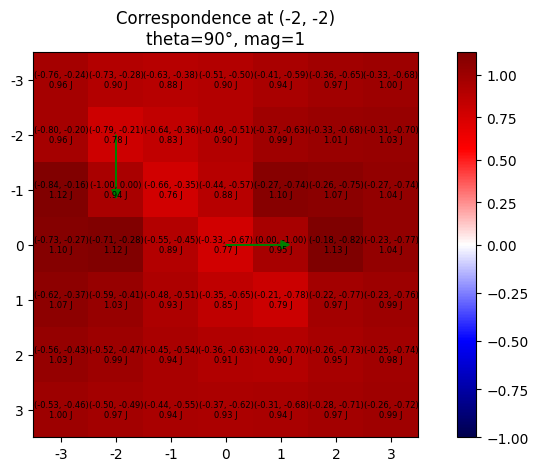

Central Jacobian determinant: 0.6029747182551438


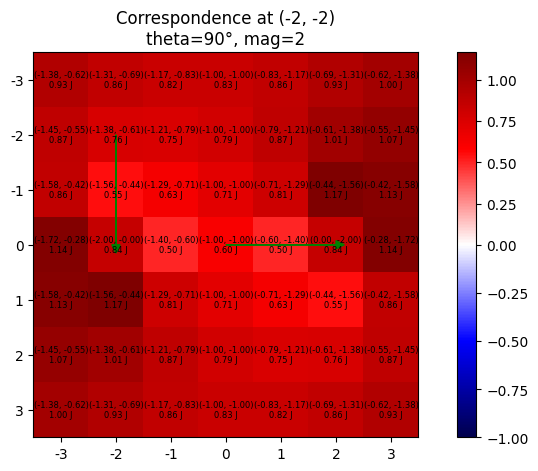

Central Jacobian determinant: 0.5297294398735355


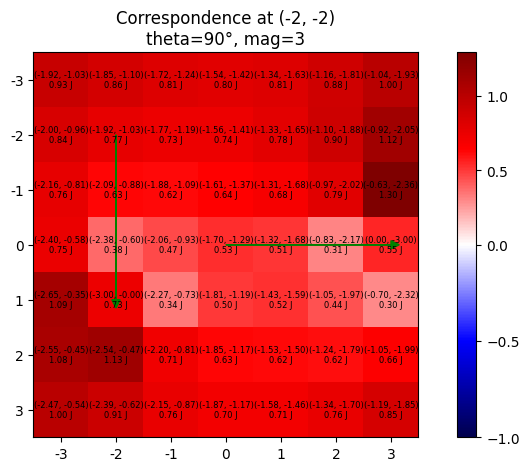

(array([[0.92663456, 0.86111554, 0.81460584, 0.79596236, 0.81466086, 0.88111682, 1.00032165],
        [0.84427681, 0.76793099, 0.73444919, 0.73797428, 0.7822628 , 0.89536913, 1.12104151],
        [0.7639126 , 0.63140802, 0.61811558, 0.64168234, 0.68075217, 0.79435887, 1.29509689],
        [0.747357  , 0.3752875 , 0.46524226, 0.52972944, 0.50841353, 0.30695072, 0.5541673 ],
        [1.09289273, 0.73280091, 0.33825806, 0.50353248, 0.51641631, 0.43576091, 0.3034537 ],
        [1.07822582, 1.12608649, 0.71205612, 0.63196138, 0.61730978, 0.61677647, 0.65609397],
        [0.99648631, 0.90981892, 0.75574781, 0.7000121 , 0.70729144, 0.75762022, 0.85337268]]),
 array([[0.94454363, 0.89957721, 0.86220694, 0.84315436, 0.85632837, 0.90429013, 0.99215635],
        [0.88092237, 0.83386498, 0.80066785, 0.79278821, 0.82263569, 0.9084304 , 1.06727204],
        [0.80723981, 0.7299813 , 0.6997721 , 0.71141942, 0.73014399, 0.8108047 , 1.17541653],
        [0.78469858, 0.53128758, 0.55051638, 0.63140871, 0

In [25]:
# Neighboring correspondence parameters
oy, ox = (-2, -2)
angle = 90
magnitude = 3
base_magnitude = 3
MULTIPLIER = 3
USE_X_1_CASE = False

run_case(oy, ox, angle, 1, n=n, x_1_case=USE_X_1_CASE, multiplier=MULTIPLIER, base_magnitude=1, show_downsampled=False, show_upscaled=False, )
run_case(oy, ox, angle, 2, n=n, x_1_case=USE_X_1_CASE, multiplier=MULTIPLIER, base_magnitude=2, show_downsampled=False, show_upscaled=False)
run_case(oy, ox, angle, 3, n=n, x_1_case=USE_X_1_CASE, multiplier=MULTIPLIER, base_magnitude=3, show_downsampled=False, show_upscaled=False)

Central Jacobian determinant: 1.1208841002159764


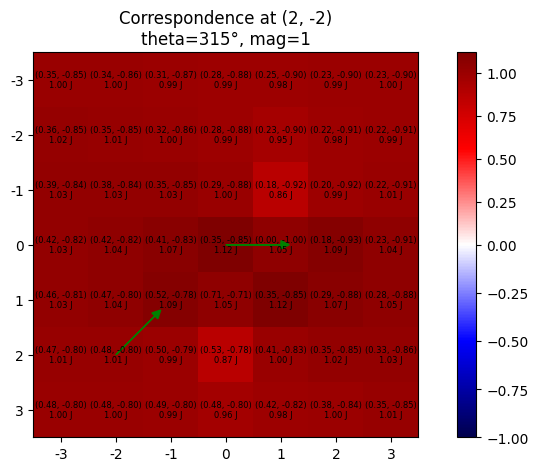

Central Jacobian determinant: 0.9770611006876629


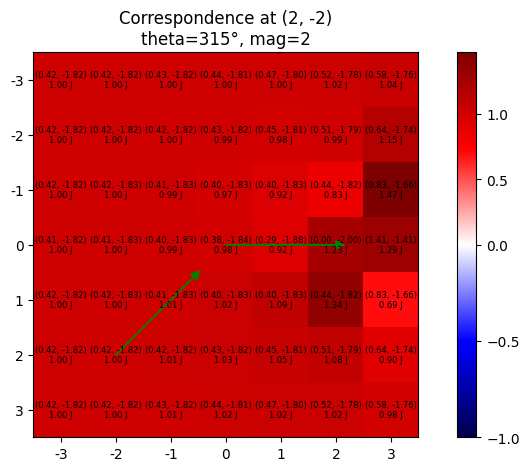

Central Jacobian determinant: 0.7918496918843069


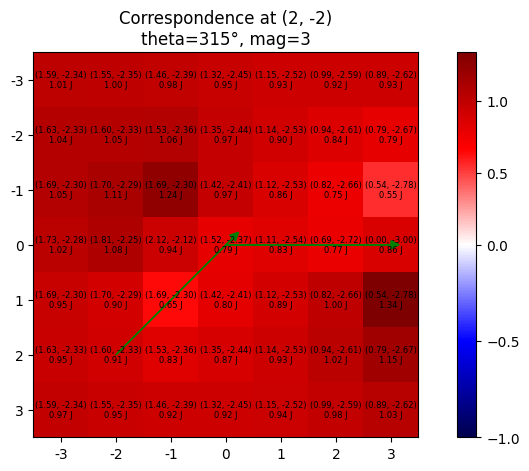

(array([[1.01157142, 0.99914701, 0.98262778, 0.95025074, 0.92641854, 0.91874551, 0.92800199],
        [1.0437354 , 1.05406656, 1.06165579, 0.96864142, 0.89880355, 0.84127974, 0.79178918],
        [1.0544125 , 1.1072516 , 1.2389632 , 0.96512464, 0.86110324, 0.75420836, 0.54701266],
        [1.01768279, 1.07966788, 0.93816617, 0.79184969, 0.82631769, 0.76882375, 0.85817467],
        [0.95210857, 0.89626793, 0.64507456, 0.79776108, 0.88768982, 1.00168277, 1.33593182],
        [0.9471019 , 0.90676628, 0.83482208, 0.86900089, 0.92753462, 1.01518347, 1.14949585],
        [0.97401461, 0.94963886, 0.92102908, 0.91970101, 0.93860032, 0.97812734, 1.03334671]]),
 array([[1.03291837, 1.01548264, 0.99300852, 0.96806101, 0.94698314, 0.93875905, 0.95296244],
        [1.11071287, 1.06679698, 1.01172643, 0.96405085, 0.9174224 , 0.8765021 , 0.86615436],
        [1.22252985, 1.10509453, 1.00262836, 0.94930342, 0.89078926, 0.79172809, 0.6939756 ],
        [1.01960693, 0.90686307, 0.94326924, 0.9342051 , 0

In [26]:
# Neighboring correspondence parameters
oy, ox = (2, -2)
angle = 315
magnitude = 3
base_magnitude = 3
MULTIPLIER = 3
USE_X_1_CASE = False

run_case(oy, ox, angle, 1, n=n, x_1_case=USE_X_1_CASE, multiplier=MULTIPLIER, base_magnitude=1, show_downsampled=False, show_upscaled=False, )
run_case(oy, ox, angle, 2, n=n, x_1_case=USE_X_1_CASE, multiplier=MULTIPLIER, base_magnitude=2, show_downsampled=False, show_upscaled=False)
run_case(oy, ox, angle, 3, n=n, x_1_case=USE_X_1_CASE, multiplier=MULTIPLIER, base_magnitude=3, show_downsampled=False, show_upscaled=False)

Central Jacobian determinant: 0.6871536810234251


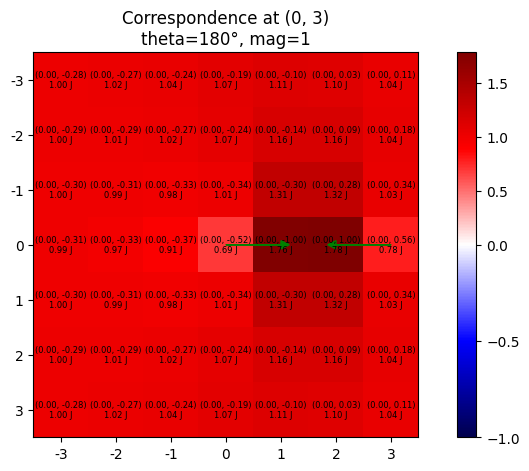

Central Jacobian determinant: 1.6256926379531498


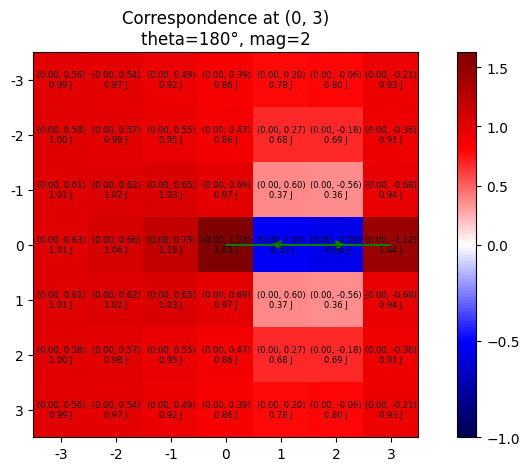

Central Jacobian determinant: 0.4739916100002858


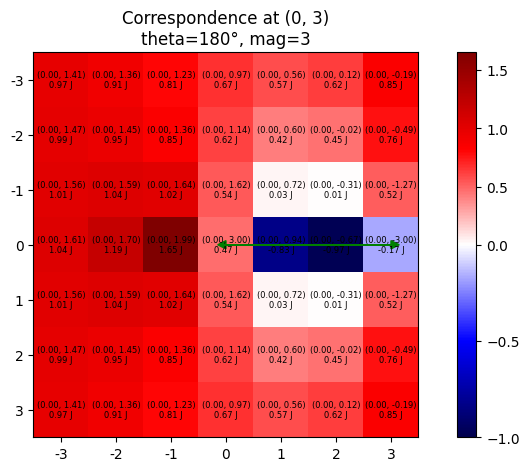

(array([[ 0.97378475,  0.90786398,  0.80640988,  0.66674094,  0.57094012,  0.62291998,  0.84639015],
        [ 0.98605644,  0.94536109,  0.84738069,  0.61803149,  0.41981162,  0.45350034,  0.76364416],
        [ 1.01435759,  1.04261507,  1.01920672,  0.53650011,  0.03347141,  0.00887016,  0.52094961],
        [ 1.04426407,  1.19375393,  1.65219677,  0.47399161, -0.83399519, -0.97109752, -0.16581763],
        [ 1.01435759,  1.04261507,  1.01920672,  0.53650011,  0.03347141,  0.00887016,  0.52094961],
        [ 0.98605644,  0.94536109,  0.84738069,  0.61803149,  0.41981162,  0.45350034,  0.76364416],
        [ 0.97378475,  0.90786398,  0.80640988,  0.66674094,  0.57094012,  0.62291998,  0.84639015]]),
 array([[ 0.98437864,  0.93723226,  0.85858331,  0.7532331 ,  0.68707852,  0.73122697,  0.89165188],
        [ 0.99366181,  0.96985762,  0.9008333 ,  0.72210143,  0.5647527 ,  0.59244459,  0.82515584],
        [ 1.01485256,  1.05818176,  1.09393843,  0.67482701,  0.22774883,  0.22148038,  0

In [27]:
# Neighboring correspondence parameters
oy, ox = (0, 3)
angle = 180
magnitude = 3
base_magnitude = 3
MULTIPLIER = 3
USE_X_1_CASE = False

run_case(oy, ox, angle, 1, n=n, x_1_case=USE_X_1_CASE, multiplier=MULTIPLIER, base_magnitude=1, show_downsampled=False, show_upscaled=False, )
run_case(oy, ox, angle, 2, n=n, x_1_case=USE_X_1_CASE, multiplier=MULTIPLIER, base_magnitude=2, show_downsampled=False, show_upscaled=False)
run_case(oy, ox, angle, 3, n=n, x_1_case=USE_X_1_CASE, multiplier=MULTIPLIER, base_magnitude=3, show_downsampled=False, show_upscaled=False)

Central Jacobian determinant: 0.6444612825447159


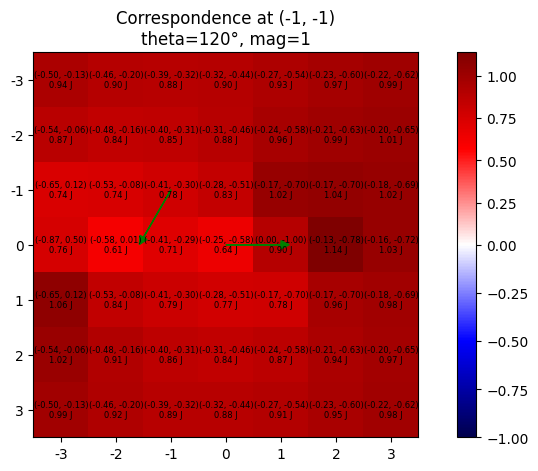

Central Jacobian determinant: 0.8797906777361375


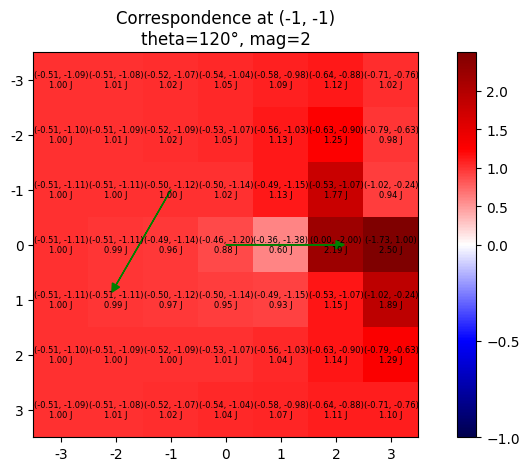

Central Jacobian determinant: 0.7040541520252057


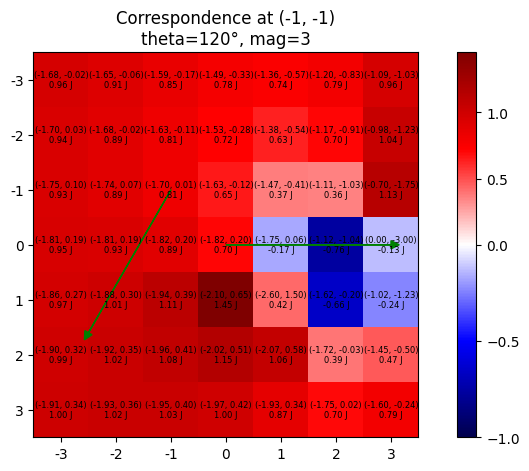

(array([[ 0.9637195 ,  0.91011701,  0.84614391,  0.77939718,  0.73942063,  0.78862596,  0.95677394],
        [ 0.94180052,  0.88832088,  0.81359857,  0.71629324,  0.63075896,  0.70410687,  1.03776067],
        [ 0.93388009,  0.88951494,  0.8089256 ,  0.64812967,  0.36590344,  0.35994187,  1.13420809],
        [ 0.9452076 ,  0.93165312,  0.88710028,  0.70405415, -0.16941777, -0.76016154, -0.12852733],
        [ 0.96971836,  1.00593748,  1.10546283,  1.45339045,  0.42193268, -0.6561499 , -0.23768881],
        [ 0.98943283,  1.0228275 ,  1.07664475,  1.14800122,  1.06108189,  0.39309873,  0.47378551],
        [ 1.00295178,  1.02295353,  1.03169146,  0.9991842 ,  0.87249039,  0.69549513,  0.79203595]]),
 array([[0.96902137, 0.93023757, 0.89085304, 0.85626753, 0.84134671, 0.86977987, 0.95651145],
        [0.94683019, 0.90889608, 0.8669127 , 0.81947563, 0.78011871, 0.80058735, 0.95129582],
        [0.9338967 , 0.89758448, 0.8512685 , 0.78454089, 0.68113669, 0.58388563, 0.91821028],
        [

In [28]:
# Neighboring correspondence parameters
oy, ox = (-1, -1)
angle = 120
magnitude = 3
base_magnitude = 3
MULTIPLIER = 3
USE_X_1_CASE = False

run_case(oy, ox, angle, 1, n=n, x_1_case=USE_X_1_CASE, multiplier=MULTIPLIER, base_magnitude=1, show_downsampled=False, show_upscaled=False)
run_case(oy, ox, angle, 2, n=n, x_1_case=USE_X_1_CASE, multiplier=MULTIPLIER, base_magnitude=2, show_downsampled=False, show_upscaled=False)
run_case(oy, ox, angle, 3, n=n, x_1_case=USE_X_1_CASE, multiplier=MULTIPLIER, base_magnitude=3, show_downsampled=False, show_upscaled=False)

### Scaling test 2

The second experiment is to keep the reference to a unit vector and the neighborhood vector to whatever you had in your first experiment. 

Just increase the resolution as you have done now (but without scaling the magnitude). 

What happens then? Would the scaling down from 21x21 to 7x7 give you the same displacement for all pixels as the original 7x7? 

What happens to the Jacobian for 21x21 and 3x3 versions?

In [29]:
from skimage.measure import block_reduce
from scipy.ndimage import uniform_filter


def run_case2(oy, ox, angle, magnitude, n=7, x_1_case = False, multiplier=3, base_magnitude=1, upscaled_fontsize=6,
              show_original=True, show_downsampled=True, show_upscaled=True, upscaled_figsize=(20, 20), upscaled_offset=1): 
    #############################################
    # Case 2: base x

    # Run the case
    y = oy + n // 2  # Get central coordinates
    x = ox + n // 2
    deformation, jdet_field_original = create_case2(y, x, angle, magnitude, None, None, n=7, base_magnitude=base_magnitude, x_1_case=x_1_case)
    central_jdet = jdet_field_original[n//2, n//2]

    if show_original:
        print("Central Jacobian determinant:", central_jdet)
        show_data2(deformation, jdet_field_original, y, x, angle, magnitude, 
                title=f"Correspondence at ({y - n // 2}, {x - n // 2})\ntheta={angle}°, mag={magnitude}", 
                fontsize=6, figsize=(10, 5),
                base_magnitude=base_magnitude)

    #############################################
    # Case 2: base x bigger

    # Base correspondence parameters
    base_magnitude = base_magnitude

    # Neighboring correspondence parameters
    y, x = (oy * multiplier, ox * multiplier)
    angle = angle
    magnitude = magnitude

    # Setup the new grid size
    n = n * multiplier

    # Run the case
    y = y + n // 2  # Get central coordinates
    x = x + n // 2
    deformation, jdet_field = create_case2(y, x, angle, magnitude, None, None, n=n, base_magnitude=base_magnitude, x_1_case=x_1_case)
    central_jdet = jdet_field[n//2, n//2]
    
    #mean_field = uniform_filter(jdet_field, size=3)
    #print("Mean field")
    #pprint(mean_field)
    #print(mean_field.max())
    
    # Downsample jdet_field and show it.
    jdet_downsampled = block_reduce(jdet_field, block_size=(multiplier, multiplier), func=np.mean)
    
    jdet_original_corr = jdet_field_original.flatten()
    #jdet_original_corr = (jdet_original_corr - jdet_original_corr.mean()) / jdet_original_corr.std()
    jdet_downsampled_corr = jdet_downsampled.flatten()
    #jdet_downsampled_corr = (jdet_downsampled_corr - jdet_downsampled_corr.mean()) / jdet_downsampled_corr.std()
    #correlation = np.corrcoef(jdet_original_corr, jdet_downsampled_corr)[0, 1]

    if show_downsampled:
        # Plot the grid of Jacobian determinants color values
        new_field = show_jdet_only2(jdet_downsampled, deformation, multiplier=multiplier, title=f"Correspondence at ({y - n // 2}, {x - n // 2}) (downscaled)\ntheta={angle}°, mag={magnitude}", 
                    fontsize=6, figsize=(10, 5), upscaled_offset=upscaled_offset)
        
        new_jdet = jacobian.sitk_jacobian_determinant(new_field)[0]
        show_jdet_only2(new_jdet, deformation, multiplier=multiplier, title=f"{n}x{n} downscaled re-computed Jdet ", upscaled_offset=upscaled_offset, fontsize=6)
        #print("Correlation:", correlation)
    
    if show_upscaled:
        show_data2(deformation, jdet_field, y, x, angle, magnitude, multiplier=multiplier,
                title=f"Correspondence at ({y - n // 2}, {x - n // 2})\ntheta={angle}°, mag={magnitude}", 
                fontsize=upscaled_fontsize, figsize=upscaled_figsize,
                base_magnitude=base_magnitude)
        print("Central Jacobian determinant:", central_jdet)
    
    #############################################
    return jdet_field_original, jdet_downsampled



def show_jdet_only2(jdet_field, deformation=None, title="", fontsize=8, base_magnitude=1, multiplier=3, figsize=(10, 5), upscaled_offset=1):
    norm = mcolors.TwoSlopeNorm(vmin=min(jdet_field.min(), -1), vcenter=0, vmax=jdet_field.max())
    
    # Plot the grid of deformation information
    f = plt.figure(figsize=figsize)
    
    # Plot the grid of Jacobian determinants color values
    plt.imshow(jdet_field, cmap="seismic", norm=norm)
    plt.colorbar()
        
    new_displacement_field = np.zeros((3, 1, jdet_field.shape[0], jdet_field.shape[1]))
        
    for j in range(jdet_field.shape[0]):
        for i in range(jdet_field.shape[1]):
            jdet = jdet_field[j, i]
            
            coord_text = ""
            if deformation is not None:
                curr_displacement = deformation[:, 0, (j * multiplier) + upscaled_offset, (i * multiplier) + upscaled_offset]
                displacement_y = curr_displacement[1] / multiplier
                displacement_x = curr_displacement[2] / multiplier
                coord_text = f"({displacement_y:.2f}, {displacement_x:.2f})\n"
                new_displacement_field[0, 0, j, i] = 0
                new_displacement_field[1, 0, j, i] = displacement_y
                new_displacement_field[2, 0, j, i] = displacement_x
            
            # Setup text to display
            jdet_text = f"{jdet:.2f} J"
            pixel_text = coord_text + jdet_text
            plt.text(i, j, pixel_text, color='black', ha='center', va='center', fontsize=fontsize, weight='normal')
            
    # Set the xticks and yticks
    plt.xticks(np.arange(jdet_field.shape[0]), labels=np.arange(-(jdet_field.shape[1] // 2) - 1, jdet_field.shape[1] // 2) + 1)
    plt.yticks(np.arange(jdet_field.shape[0]), labels=np.arange(-(jdet_field.shape[0] // 2) - 1, jdet_field.shape[0] // 2) + 1)
    plt.title(title)
    plt.show()
    f.clear()
    plt.close(f)
    return new_displacement_field 

In [52]:
# Neighboring correspondence parameters
oy, ox = (-2, -2)
angle = 90
magnitude = 6
base_magnitude = 2

MULTIPLIER = 3
USE_X_1_CASE = False

run_case2(oy, ox, angle, magnitude, n=n, x_1_case=USE_X_1_CASE, multiplier=3, base_magnitude=base_magnitude, show_original=True, show_downsampled=True, show_upscaled=True, upscaled_fontsize=6, upscaled_figsize=(20, 20), upscaled_offset=1)

IndexError: index 106 is out of bounds for axis 0 with size 49

Central Jacobian determinant: 0.4430289352384694


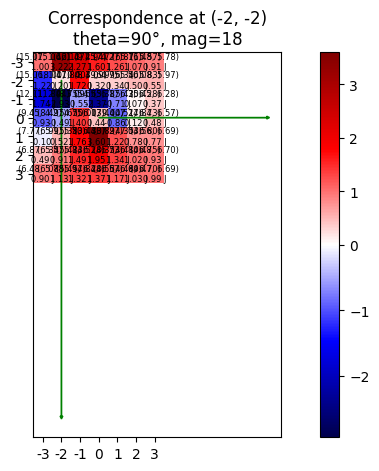

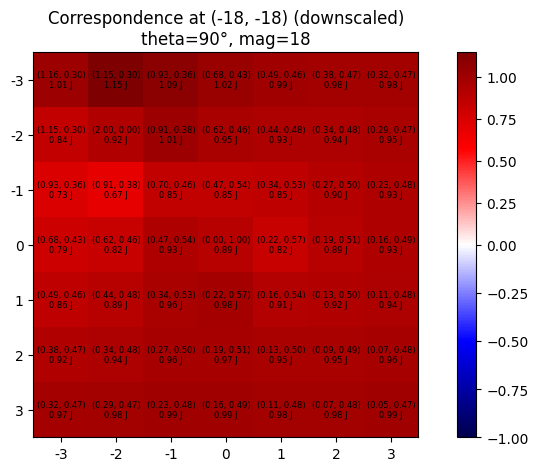

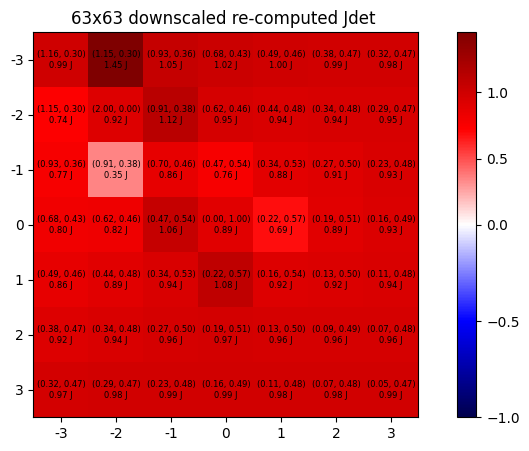

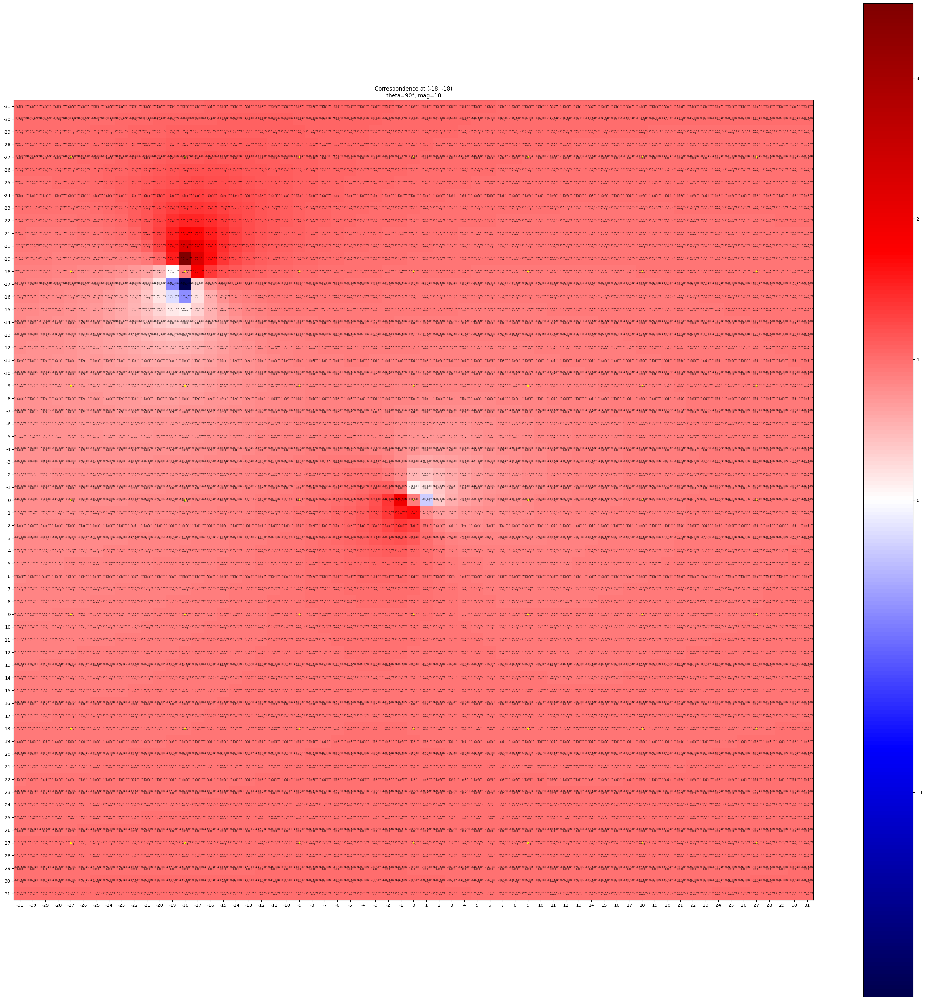

Central Jacobian determinant: 0.8883011855974706


(array([[ 1.0015453 ,  3.2156036 ,  2.26808788,  1.60289135,  1.26205074,  1.06805659,  0.90548719],
        [-1.21635768,  0.19745652,  1.71581943,  0.32087076,  0.33817687,  0.50342412,  0.55060837],
        [-1.73854327, -2.93223504, -0.55045092, -2.37192893, -0.71470042,  0.06984599,  0.37353374],
        [-0.93170065, -0.48594415,  1.39974804,  0.44302894, -0.85565692,  0.12009697,  0.47796061],
        [-0.09798839,  0.52488424,  1.76196654,  3.59962701,  1.21908418,  0.78487945,  0.76684898],
        [ 0.48550109,  0.90814311,  1.49109161,  1.9519074 ,  1.33942577,  1.01669665,  0.93174157],
        [ 0.90184285,  1.1261374 ,  1.31634499,  1.36632392,  1.17216374,  1.02951327,  0.98700355]]),
 array([[1.01202212, 1.14762357, 1.09056453, 1.02331783, 0.99344072, 0.98458239, 0.98354243],
        [0.84195852, 0.92024517, 1.00830754, 0.95239621, 0.93347553, 0.93979874, 0.95183061],
        [0.73122987, 0.67430114, 0.84871475, 0.84542057, 0.85434273, 0.90090011, 0.93019447],
        [

In [28]:
# Neighboring correspondence parameters
oy, ox = (-2, -2)
angle = 90
magnitude = 18
base_magnitude = 9

MULTIPLIER = 3
USE_X_1_CASE = False


run_case2(oy, ox, angle, magnitude, n=n, x_1_case=USE_X_1_CASE, multiplier=9, base_magnitude=base_magnitude, show_original=True, show_downsampled=True, show_upscaled=True, upscaled_fontsize=4.5, upscaled_figsize=(40, 40), upscaled_offset=4)

Central Jacobian determinant: 0.7000232147046029


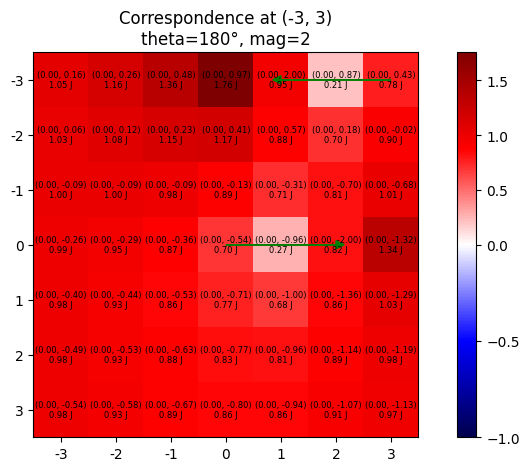

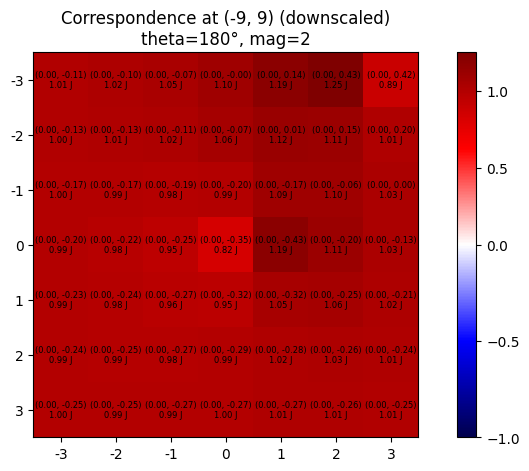

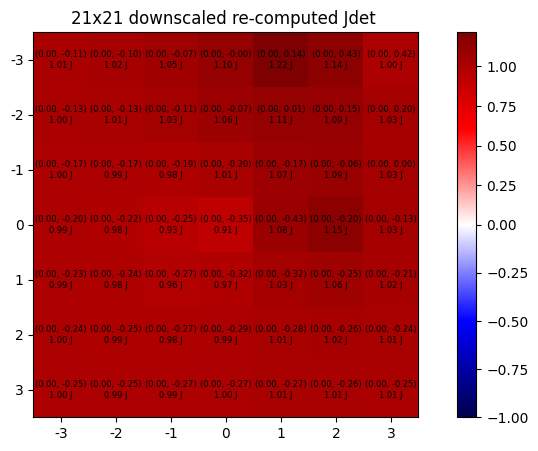

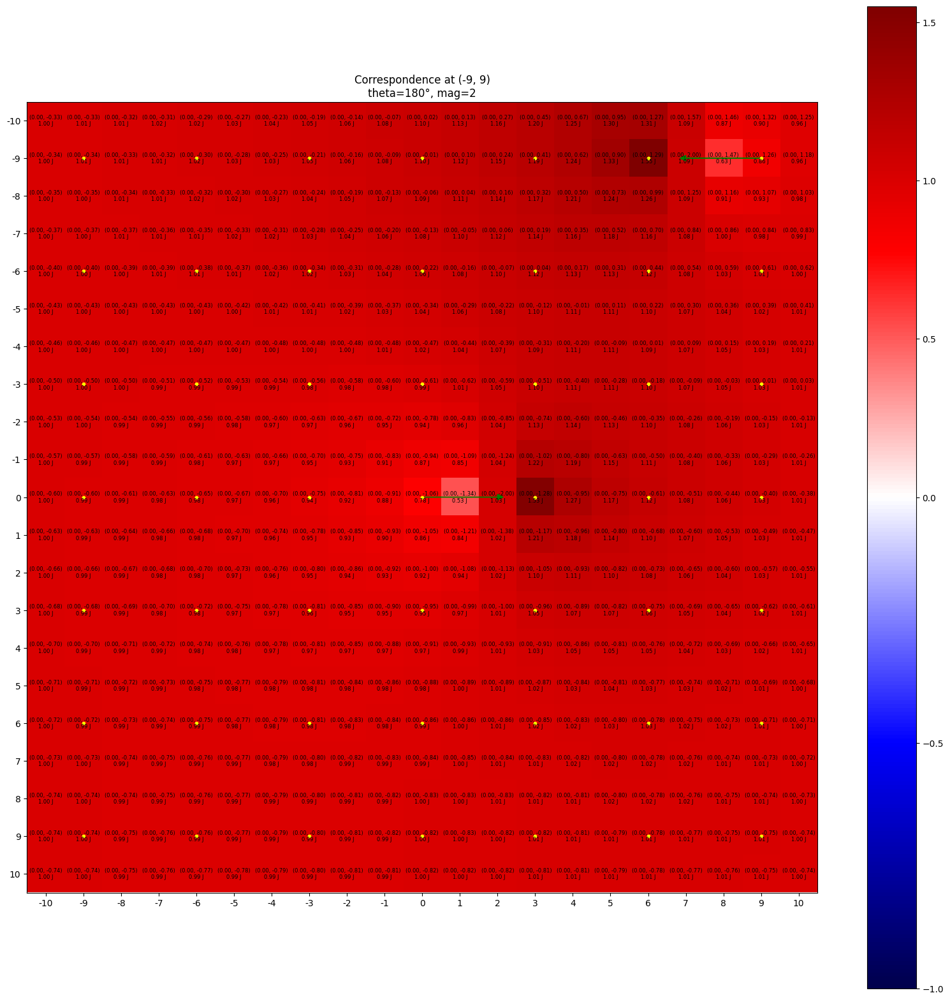

Central Jacobian determinant: 0.7844836326935534


(array([[1.04709302, 1.1618777 , 1.35512068, 1.75755591, 0.95161145, 0.2128627 , 0.77847117],
        [1.02670976, 1.08432802, 1.14665377, 1.1693256 , 0.88390788, 0.70260266, 0.89898485],
        [1.00371942, 1.00373631, 0.97814131, 0.89052588, 0.71419498, 0.81193906, 1.01014554],
        [0.98663312, 0.94883642, 0.87283067, 0.70002321, 0.27028998, 0.81977791, 1.33888378],
        [0.97958695, 0.93100474, 0.86243404, 0.76765411, 0.6773853 , 0.8552684 , 1.03452096],
        [0.97811195, 0.93093008, 0.87925099, 0.83132656, 0.81494335, 0.88920868, 0.97915903],
        [0.97845577, 0.93401933, 0.89243668, 0.86309873, 0.86280087, 0.90751554, 0.97094028]]),
 array([[1.00544456, 1.01959373, 1.04570494, 1.09592474, 1.18963252, 1.25255597, 0.88932528],
        [1.00212921, 1.0081976 , 1.02348421, 1.06029708, 1.11963454, 1.1142143 , 1.01117034],
        [0.99715153, 0.99096204, 0.98239491, 0.98841087, 1.09356656, 1.09567957, 1.03072882],
        [0.99377245, 0.97820994, 0.94557095, 0.82387706, 1

In [31]:
# Neighboring correspondence parameters
oy, ox = (-3, 3)
angle = 180
magnitude = 2
base_magnitude = 2
MULTIPLIER = 3
USE_X_1_CASE = False


run_case2(oy, ox, angle, magnitude, n=n, x_1_case=USE_X_1_CASE, multiplier=MULTIPLIER, base_magnitude=base_magnitude, show_downsampled=True, show_upscaled=True, upscaled_offset=1)

Central Jacobian determinant: 0.7000232147046029


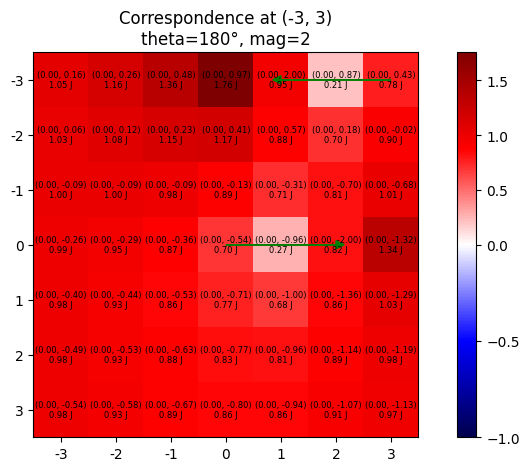

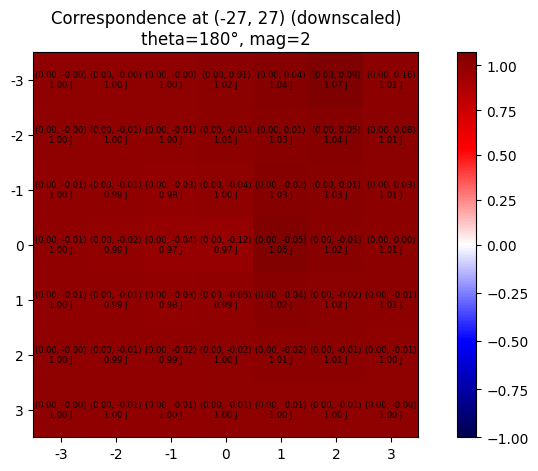

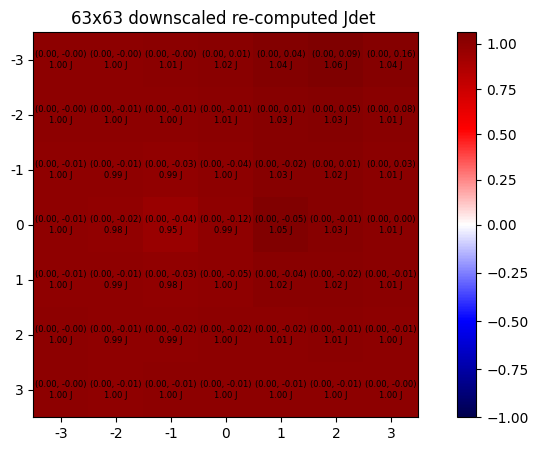

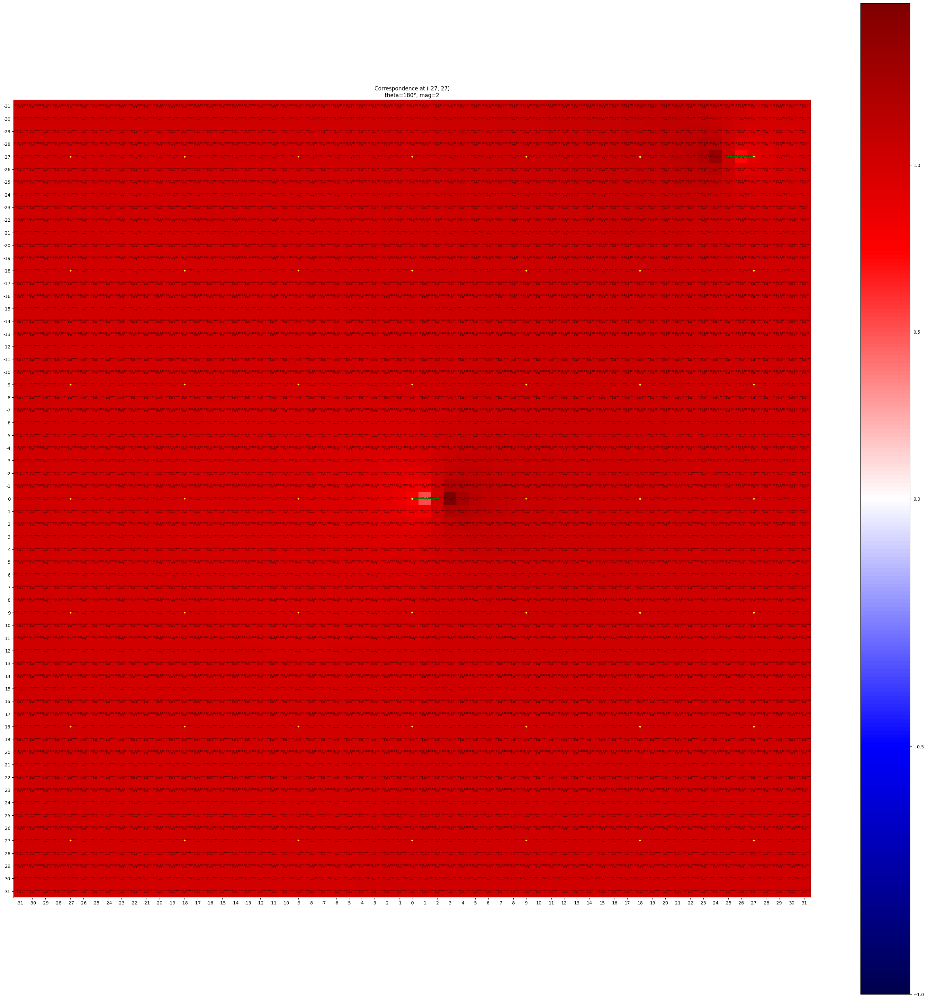

Central Jacobian determinant: 0.7654573470636574


(array([[1.04709302, 1.1618777 , 1.35512068, 1.75755591, 0.95161145, 0.2128627 , 0.77847117],
        [1.02670976, 1.08432802, 1.14665377, 1.1693256 , 0.88390788, 0.70260266, 0.89898485],
        [1.00371942, 1.00373631, 0.97814131, 0.89052588, 0.71419498, 0.81193906, 1.01014554],
        [0.98663312, 0.94883642, 0.87283067, 0.70002321, 0.27028998, 0.81977791, 1.33888378],
        [0.97958695, 0.93100474, 0.86243404, 0.76765411, 0.6773853 , 0.8552684 , 1.03452096],
        [0.97811195, 0.93093008, 0.87925099, 0.83132656, 0.81494335, 0.88920868, 0.97915903],
        [0.97845577, 0.93401933, 0.89243668, 0.86309873, 0.86280087, 0.90751554, 0.97094028]]),
 array([[0.9986763 , 0.9996112 , 1.00460687, 1.01781133, 1.03804935, 1.07236248, 1.01116491],
        [0.9983476 , 0.99620756, 0.99873612, 1.01172887, 1.0296487 , 1.03776311, 1.01395711],
        [0.99686056, 0.98984035, 0.98430361, 0.99938434, 1.03232161, 1.02638485, 1.01001795],
        [0.99600992, 0.98565307, 0.96713643, 0.97099604, 1

In [32]:
run_case2(oy, ox, angle, magnitude, n=n, x_1_case=USE_X_1_CASE, multiplier=9, base_magnitude=base_magnitude, show_original=True, show_downsampled=True, show_upscaled=True, upscaled_fontsize=4.5, upscaled_figsize=(40, 40), upscaled_offset=4)

Central Jacobian determinant: 0.6031594379720618


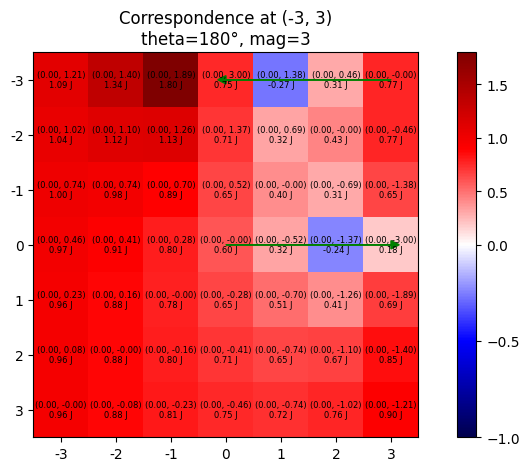

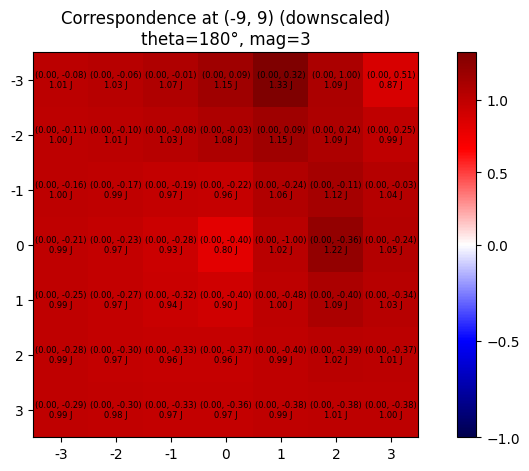

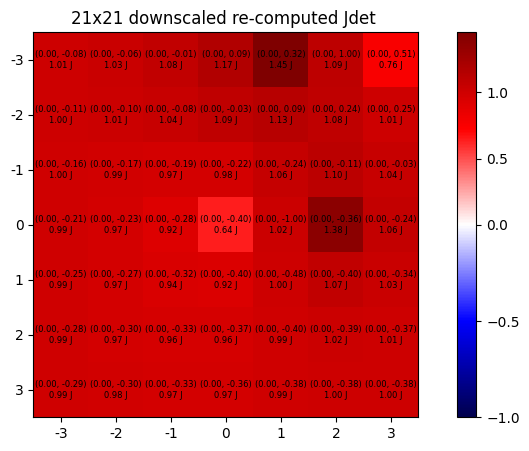

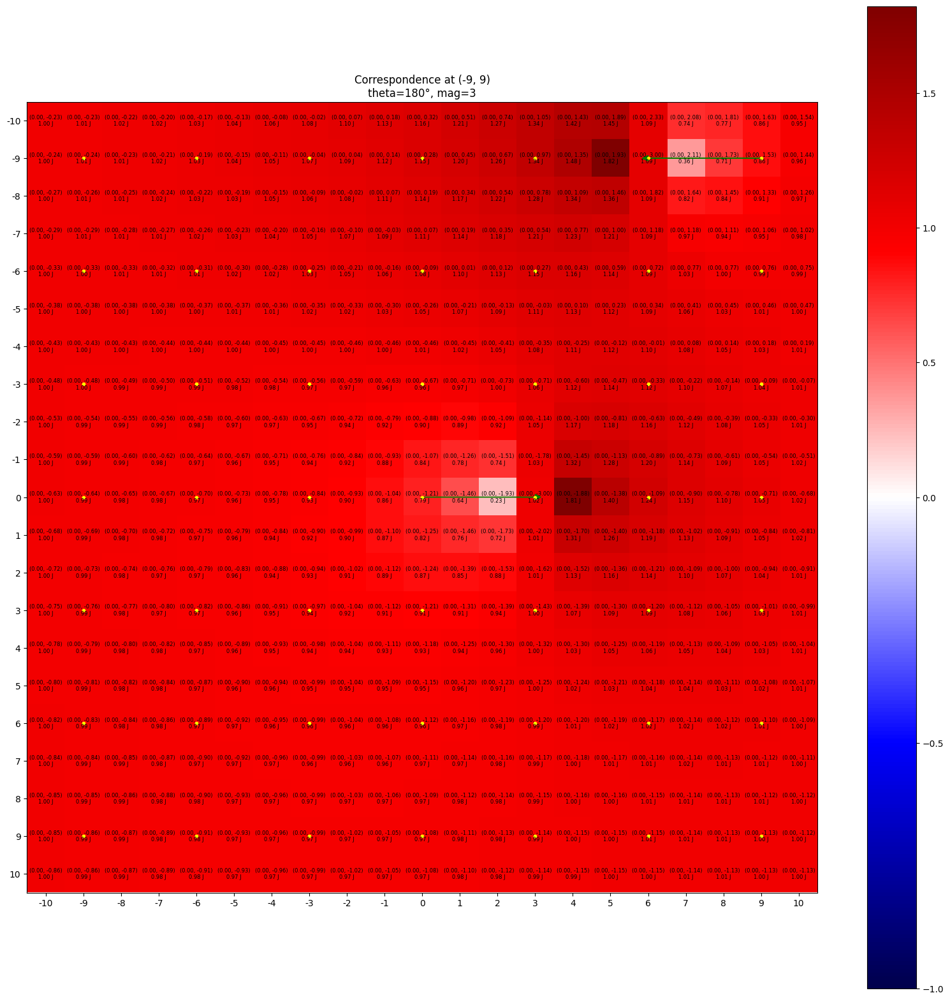

Central Jacobian determinant: 0.7899360791943315


(array([[ 1.09438889,  1.33736915,  1.7990272 ,  0.74782415, -0.26954064,  0.30823976,  0.7695576 ],
        [ 1.04325087,  1.12314447,  1.13149   ,  0.71187959,  0.31621907,  0.42549348,  0.7695576 ],
        [ 0.99997042,  0.98116364,  0.89030005,  0.6507218 ,  0.39755084,  0.30823976,  0.65230389],
        [ 0.9744997 ,  0.90872805,  0.79577282,  0.60315944,  0.31621907, -0.241598  ,  0.1837979 ],
        [ 0.96402587,  0.8840613 ,  0.7815799 ,  0.6507218 ,  0.506271  ,  0.40534211,  0.68824844],
        [ 0.96147337,  0.8815088 ,  0.79577282,  0.71187959,  0.65193625,  0.66712915,  0.8513351 ],
        [ 0.96147337,  0.8840613 ,  0.80879915,  0.74782415,  0.72068742,  0.76154762,  0.90247313]]),
 array([[1.00818177, 1.02962423, 1.07128343, 1.15450913, 1.32779185, 1.09299572, 0.86987203],
        [1.0031592 , 1.01235983, 1.03393355, 1.08072472, 1.15468379, 1.08765078, 0.98895879],
        [0.99615899, 0.98748114, 0.97431678, 0.95976628, 1.06234792, 1.12330039, 1.03772412],
        [

In [33]:
# Neighboring correspondence parameters
oy, ox = (-3, 3)
angle = 180
magnitude = 3
base_magnitude = 3
MULTIPLIER = 3
USE_X_1_CASE = False


run_case2(oy, ox, angle, magnitude, n=n, x_1_case=USE_X_1_CASE, multiplier=MULTIPLIER, base_magnitude=base_magnitude, show_downsampled=True, show_upscaled=True, upscaled_offset=1)

Central Jacobian determinant: 0.6031594379720618


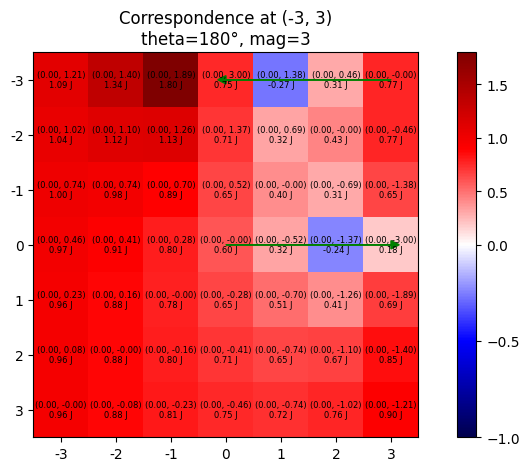

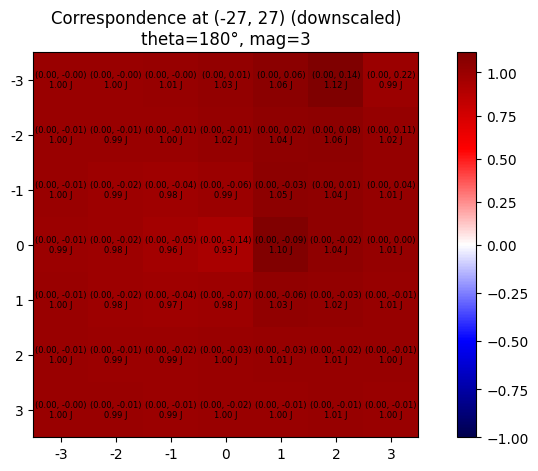

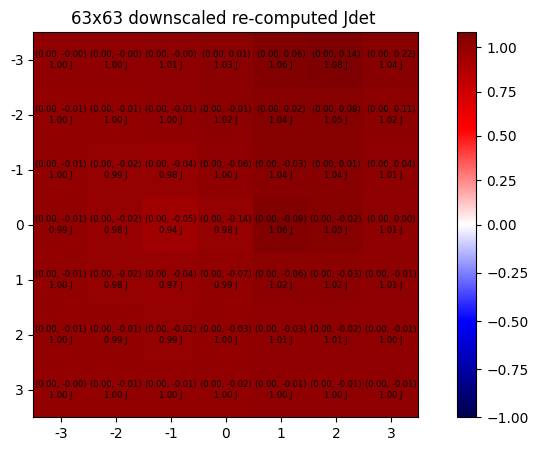

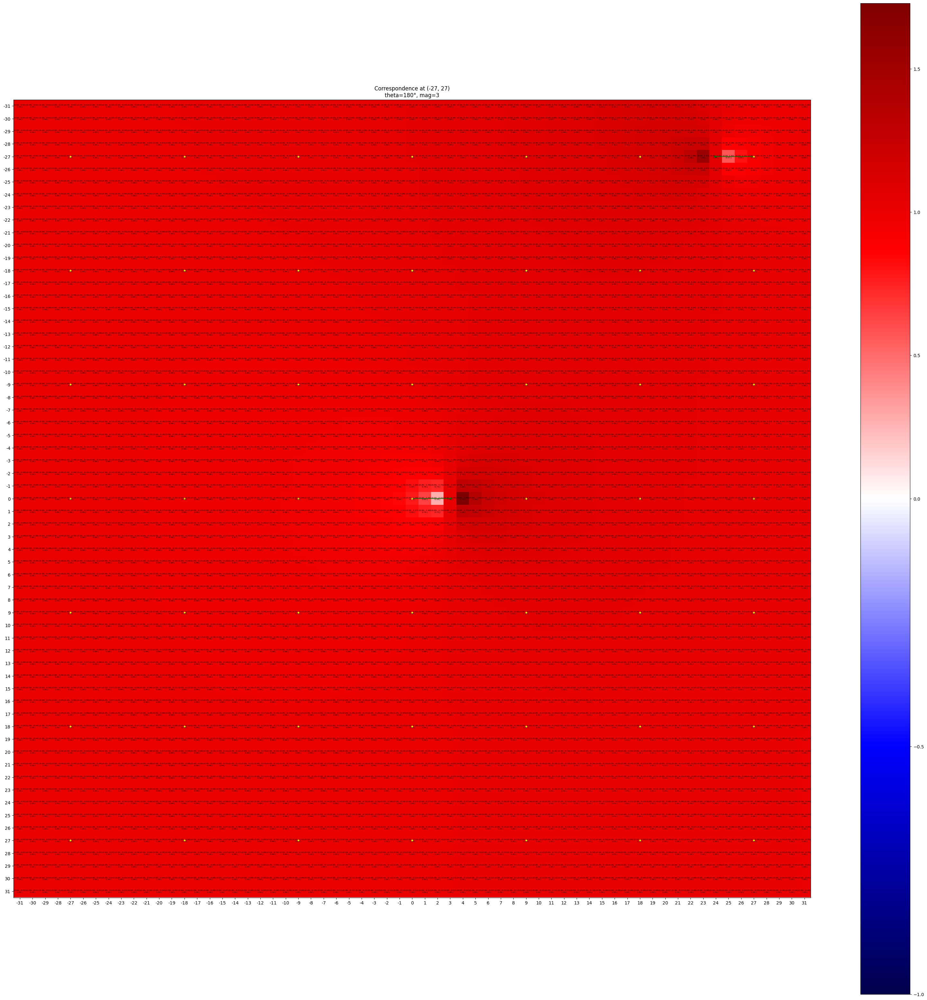

Central Jacobian determinant: 0.7801970032365798


(array([[ 1.09438889,  1.33736915,  1.7990272 ,  0.74782415, -0.26954064,  0.30823976,  0.7695576 ],
        [ 1.04325087,  1.12314447,  1.13149   ,  0.71187959,  0.31621907,  0.42549348,  0.7695576 ],
        [ 0.99997042,  0.98116364,  0.89030005,  0.6507218 ,  0.39755084,  0.30823976,  0.65230389],
        [ 0.9744997 ,  0.90872805,  0.79577282,  0.60315944,  0.31621907, -0.241598  ,  0.1837979 ],
        [ 0.96402587,  0.8840613 ,  0.7815799 ,  0.6507218 ,  0.506271  ,  0.40534211,  0.68824844],
        [ 0.96147337,  0.8815088 ,  0.79577282,  0.71187959,  0.65193625,  0.66712915,  0.8513351 ],
        [ 0.96147337,  0.8840613 ,  0.80879915,  0.74782415,  0.72068742,  0.76154762,  0.90247313]]),
 array([[0.99825527, 0.99979126, 1.00700858, 1.02770988, 1.06002288, 1.11695984, 0.99248754],
        [0.99759248, 0.99479785, 0.99791067, 1.01691637, 1.04481508, 1.05542962, 1.01645638],
        [0.99562784, 0.98573134, 0.97716508, 0.9931419 , 1.04735856, 1.04020998, 1.01471539],
        [

In [34]:
run_case2(oy, ox, angle, magnitude, n=n, x_1_case=USE_X_1_CASE, multiplier=9, base_magnitude=base_magnitude, show_original=True, show_downsampled=True, show_upscaled=True, upscaled_fontsize=4.5, upscaled_figsize=(40, 40), upscaled_offset=4)

Central Jacobian determinant: 0.9990725643154728


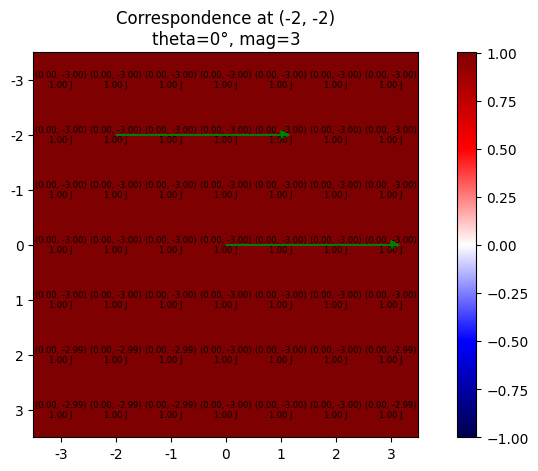

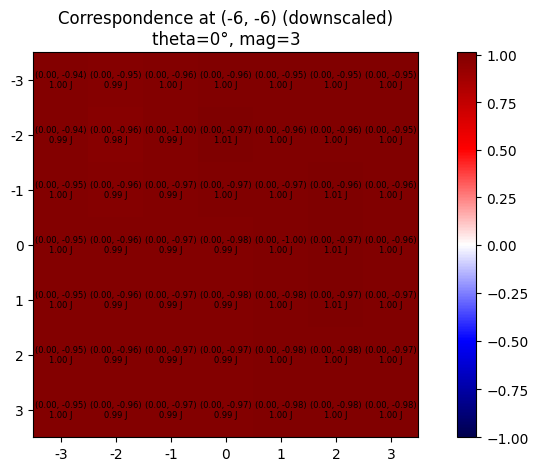

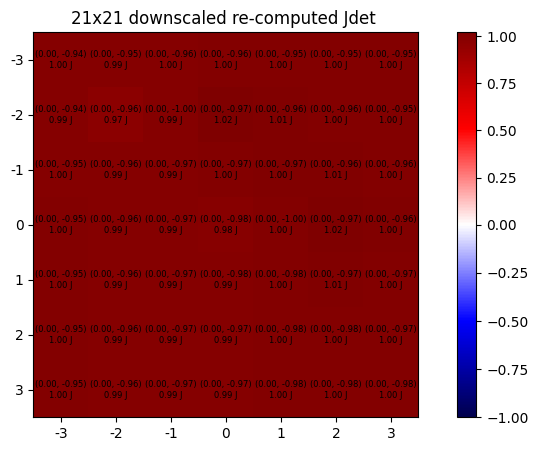

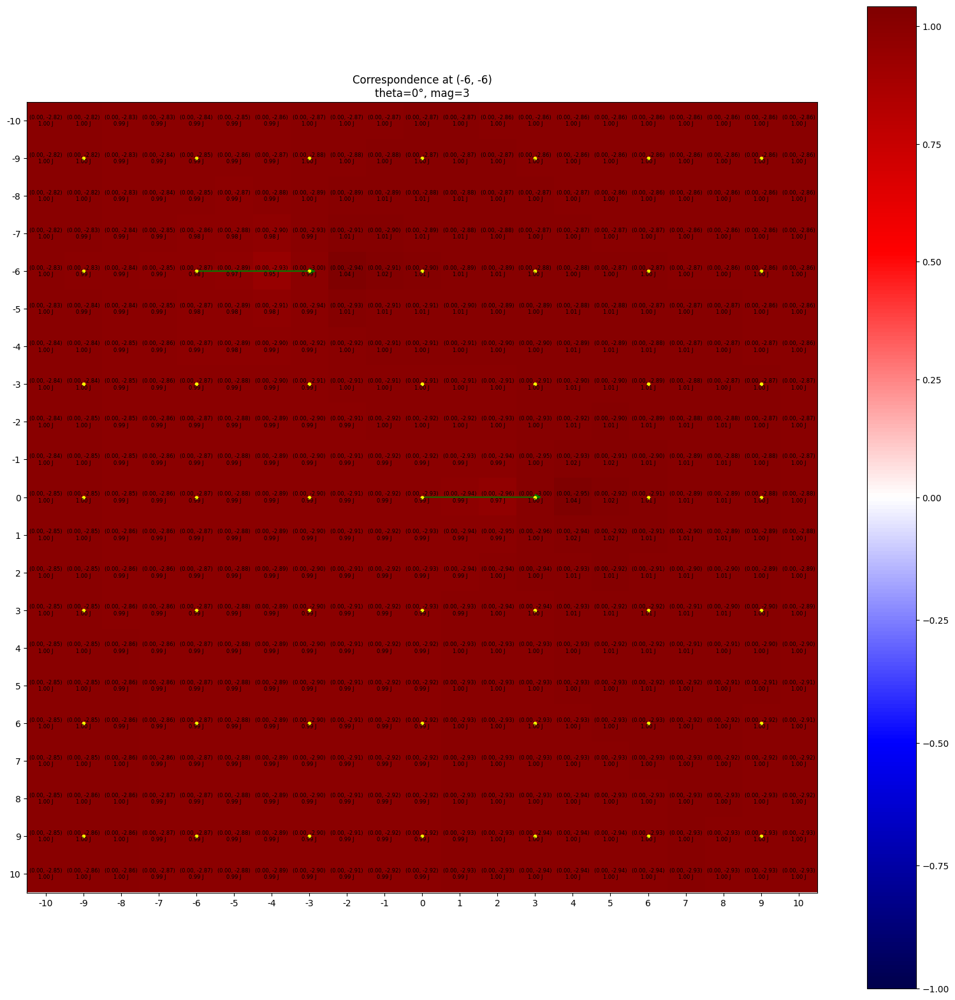

Central Jacobian determinant: 0.989834025331165


(array([[1.00100785, 1.00219851, 1.00078065, 0.99965426, 1.00047772, 1.00088267, 1.00046922],
        [1.00028227, 1.00026622, 0.9998169 , 0.99955949, 1.00047739, 1.00156598, 1.00081514],
        [1.00024701, 0.99984591, 0.99909891, 0.99983275, 1.00103535, 1.00120195, 1.00049934],
        [0.99941266, 0.99920703, 0.99872165, 0.99907256, 1.00097771, 1.00120735, 1.00037493],
        [0.99936363, 0.99852982, 0.9973092 , 0.99790237, 1.0007676 , 1.00234196, 1.00133372],
        [0.99873788, 0.99735475, 0.99671719, 0.99681533, 0.99954026, 1.00387349, 1.00304824],
        [0.9983179 , 0.99688451, 0.99666403, 0.99725448, 1.00043041, 1.00361126, 1.0023379 ]]),
 array([[0.99547293, 0.98868311, 0.99546766, 1.00376772, 1.0022953 , 1.00065038, 0.99986532],
        [0.99447578, 0.98140358, 0.99423596, 1.00980297, 1.0045684 , 1.00316351, 1.00108991],
        [0.99560283, 0.98778482, 0.99230845, 0.99989672, 1.00460962, 1.00791502, 1.00307566],
        [0.99604803, 0.99076361, 0.9903593 , 0.99049909, 1

In [35]:
# Neighboring correspondence parameters
oy, ox = (-2, -2)
angle = 0
magnitude = 3
base_magnitude = 3
MULTIPLIER = 3
USE_X_1_CASE = False


run_case2(oy, ox, angle, magnitude, n=n, x_1_case=USE_X_1_CASE, multiplier=MULTIPLIER, base_magnitude=base_magnitude, show_downsampled=True, show_upscaled=True, upscaled_offset=1)

Central Jacobian determinant: 0.9990725643154728


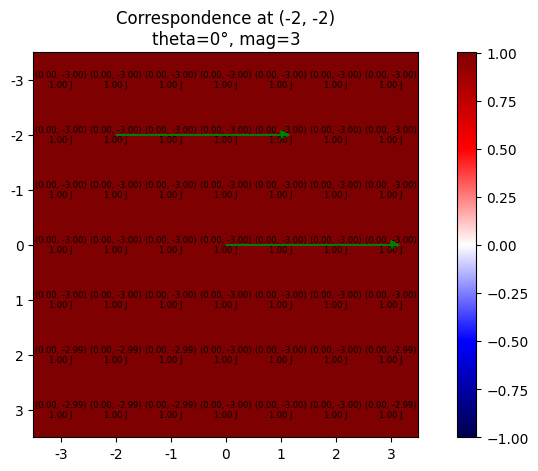

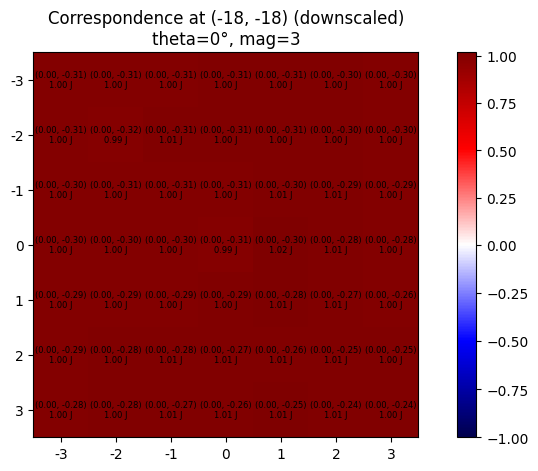

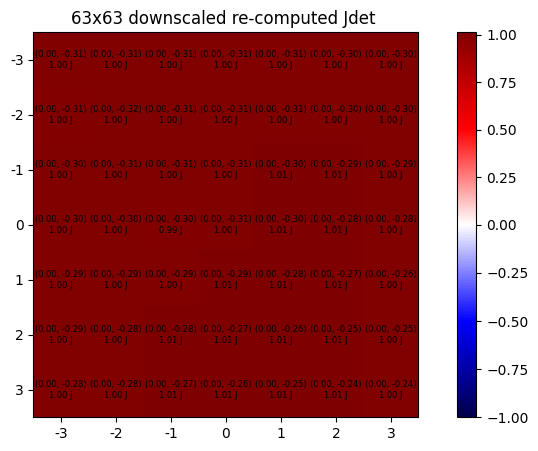

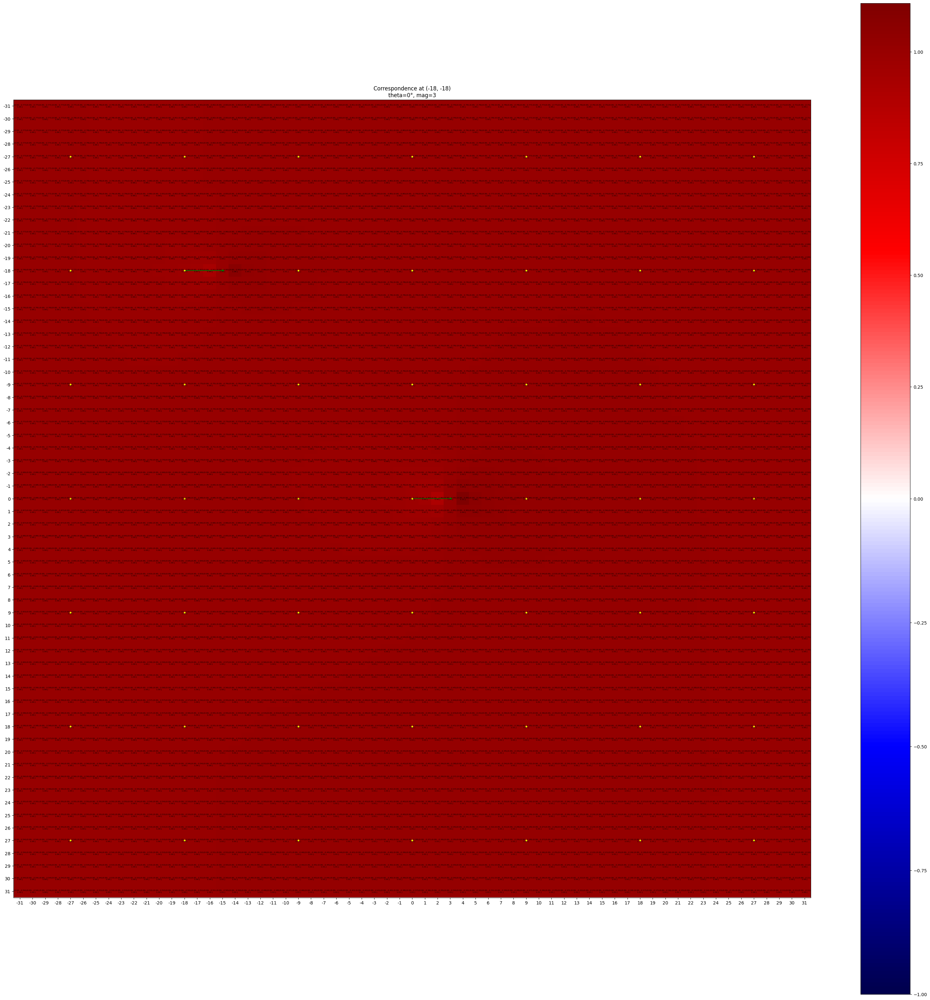

Central Jacobian determinant: 0.9731956298059261


(array([[1.00100785, 1.00219851, 1.00078065, 0.99965426, 1.00047772, 1.00088267, 1.00046922],
        [1.00028227, 1.00026622, 0.9998169 , 0.99955949, 1.00047739, 1.00156598, 1.00081514],
        [1.00024701, 0.99984591, 0.99909891, 0.99983275, 1.00103535, 1.00120195, 1.00049934],
        [0.99941266, 0.99920703, 0.99872165, 0.99907256, 1.00097771, 1.00120735, 1.00037493],
        [0.99936363, 0.99852982, 0.9973092 , 0.99790237, 1.0007676 , 1.00234196, 1.00133372],
        [0.99873788, 0.99735475, 0.99671719, 0.99681533, 0.99954026, 1.00387349, 1.00304824],
        [0.9983179 , 0.99688451, 0.99666403, 0.99725448, 1.00043041, 1.00361126, 1.0023379 ]]),
 array([[0.99749915, 0.99617015, 1.00187748, 1.00294504, 1.00346367, 1.00318883, 1.00165674],
        [0.99697137, 0.99226402, 1.00700252, 1.00353715, 1.00423524, 1.00370296, 1.00161521],
        [0.998929  , 0.9977032 , 0.99982194, 1.00162266, 1.00787662, 1.0060269 , 1.00194642],
        [1.00042915, 0.99949012, 0.99696458, 0.99445424, 1

In [36]:
run_case2(oy, ox, angle, magnitude, n=n, x_1_case=USE_X_1_CASE, multiplier=9, base_magnitude=base_magnitude, show_original=True, show_downsampled=True, show_upscaled=True, upscaled_fontsize=4.5, upscaled_figsize=(40, 40), upscaled_offset=4)

Central Jacobian determinant: 0.9990725643154728


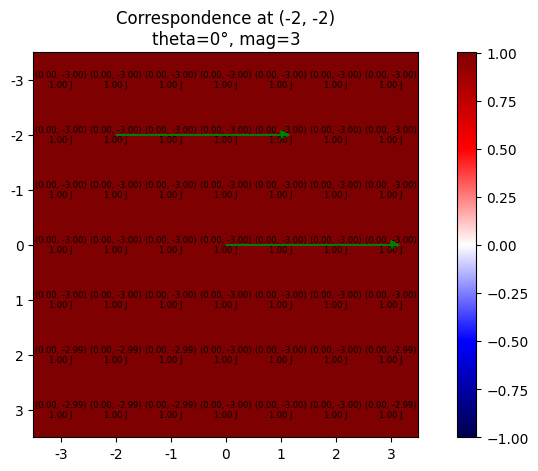

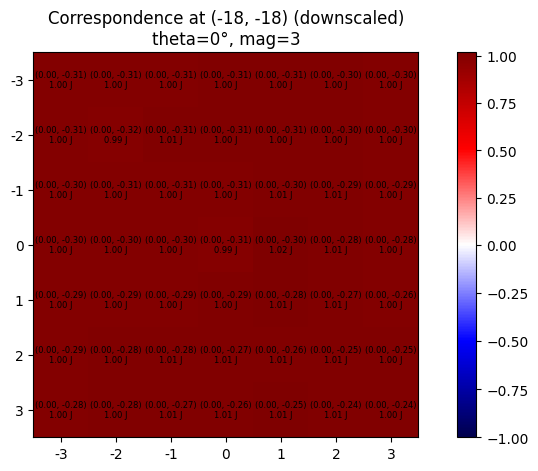

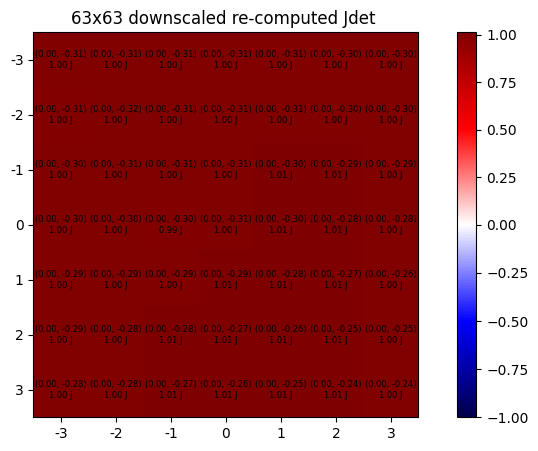

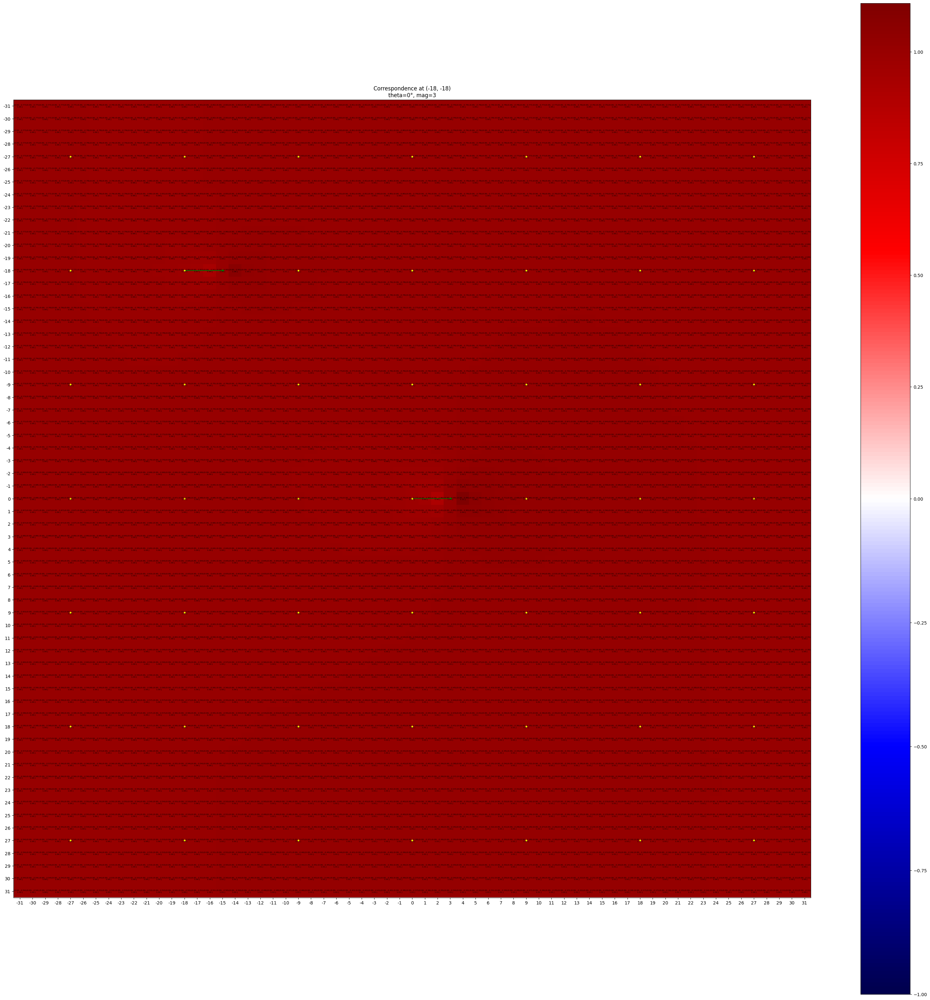

Central Jacobian determinant: 0.9731956298059261


(array([[1.00100785, 1.00219851, 1.00078065, 0.99965426, 1.00047772, 1.00088267, 1.00046922],
        [1.00028227, 1.00026622, 0.9998169 , 0.99955949, 1.00047739, 1.00156598, 1.00081514],
        [1.00024701, 0.99984591, 0.99909891, 0.99983275, 1.00103535, 1.00120195, 1.00049934],
        [0.99941266, 0.99920703, 0.99872165, 0.99907256, 1.00097771, 1.00120735, 1.00037493],
        [0.99936363, 0.99852982, 0.9973092 , 0.99790237, 1.0007676 , 1.00234196, 1.00133372],
        [0.99873788, 0.99735475, 0.99671719, 0.99681533, 0.99954026, 1.00387349, 1.00304824],
        [0.9983179 , 0.99688451, 0.99666403, 0.99725448, 1.00043041, 1.00361126, 1.0023379 ]]),
 array([[0.99749915, 0.99617015, 1.00187748, 1.00294504, 1.00346367, 1.00318883, 1.00165674],
        [0.99697137, 0.99226402, 1.00700252, 1.00353715, 1.00423524, 1.00370296, 1.00161521],
        [0.998929  , 0.9977032 , 0.99982194, 1.00162266, 1.00787662, 1.0060269 , 1.00194642],
        [1.00042915, 0.99949012, 0.99696458, 0.99445424, 1

In [37]:
run_case2(oy, ox, angle, magnitude, n=n, x_1_case=USE_X_1_CASE, multiplier=9, base_magnitude=base_magnitude, show_original=True, show_downsampled=True, show_upscaled=True, upscaled_fontsize=4.5, upscaled_figsize=(40, 40), upscaled_offset=4)

Central Jacobian determinant: 0.5297294398735355


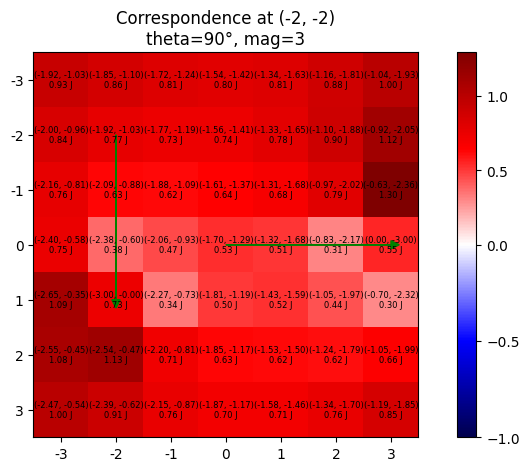

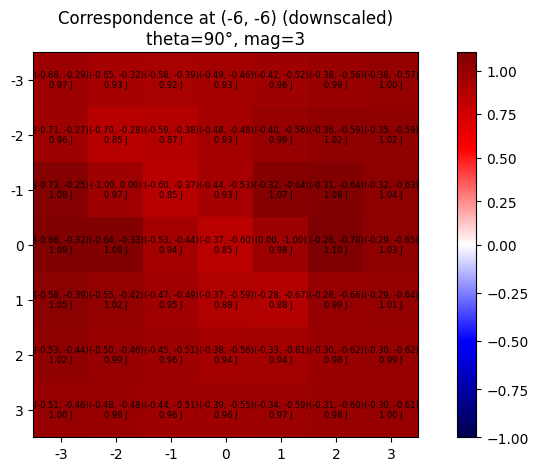

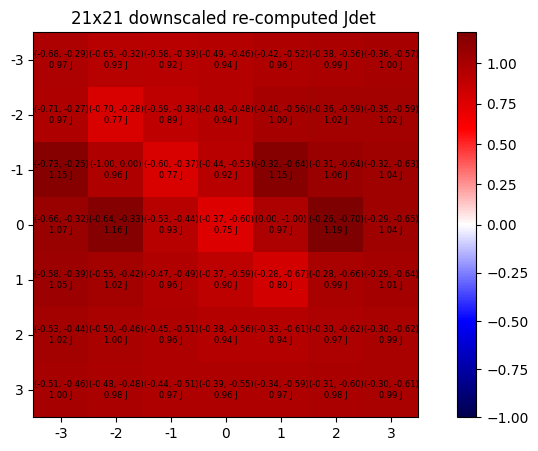

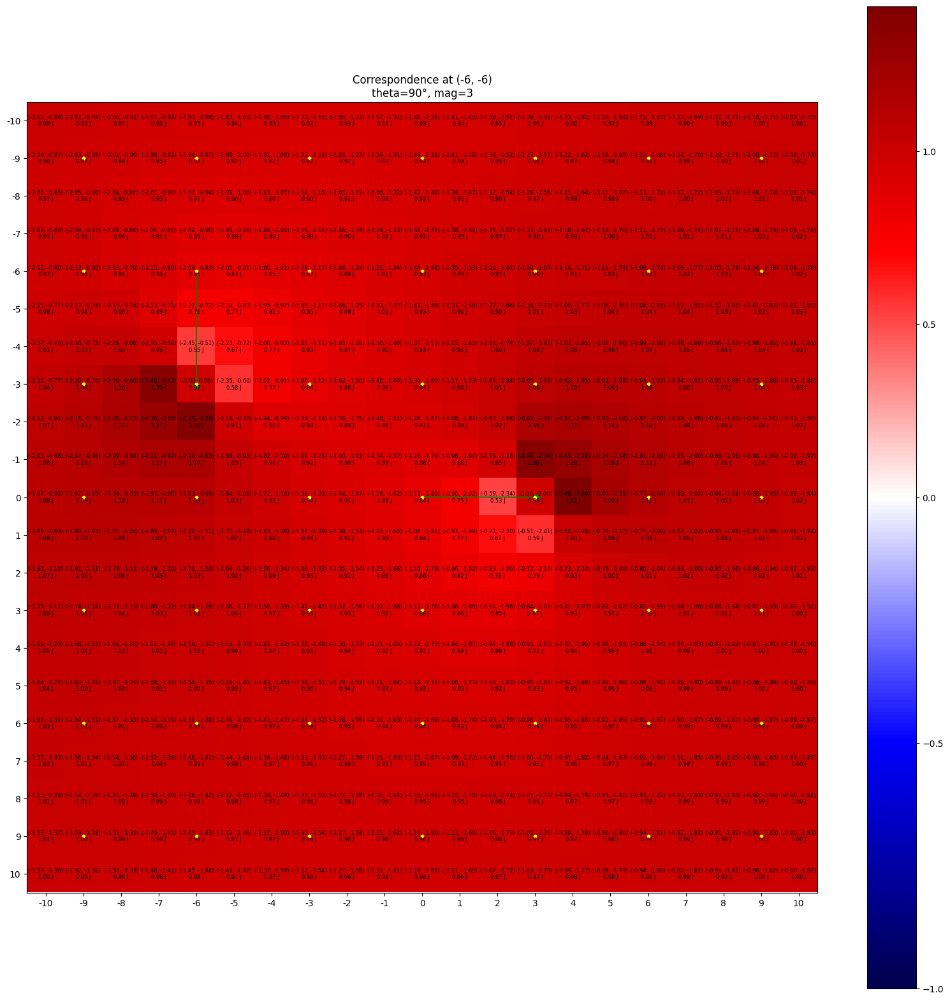

Central Jacobian determinant: 0.8375210624924733


(array([[0.92663456, 0.86111554, 0.81460584, 0.79596236, 0.81466086, 0.88111682, 1.00032165],
        [0.84427681, 0.76793099, 0.73444919, 0.73797428, 0.7822628 , 0.89536913, 1.12104151],
        [0.7639126 , 0.63140802, 0.61811558, 0.64168234, 0.68075217, 0.79435887, 1.29509689],
        [0.747357  , 0.3752875 , 0.46524226, 0.52972944, 0.50841353, 0.30695072, 0.5541673 ],
        [1.09289273, 0.73280091, 0.33825806, 0.50353248, 0.51641631, 0.43576091, 0.3034537 ],
        [1.07822582, 1.12608649, 0.71205612, 0.63196138, 0.61730978, 0.61677647, 0.65609397],
        [0.99648631, 0.90981892, 0.75574781, 0.7000121 , 0.70729144, 0.75762022, 0.85337268]]),
 array([[0.97047294, 0.93204172, 0.91718323, 0.93370266, 0.96261018, 0.98717672, 1.00195579],
        [0.96212094, 0.85385366, 0.86766684, 0.93317621, 0.99299397, 1.02085687, 1.02270413],
        [1.07519699, 0.9656696 , 0.84968392, 0.92717371, 1.06884629, 1.08079353, 1.03984396],
        [1.09240947, 1.08157326, 0.93694474, 0.84528294, 0

In [38]:
# Neighboring correspondence parameters
oy, ox = (-2, -2)
angle = 90
magnitude = 3
base_magnitude = 3
MULTIPLIER = 3
USE_X_1_CASE = False


run_case2(oy, ox, angle, magnitude, n=n, x_1_case=USE_X_1_CASE, multiplier=MULTIPLIER, base_magnitude=base_magnitude, show_downsampled=True, show_upscaled=True, upscaled_offset=1)

Central Jacobian determinant: 0.5297294398735355


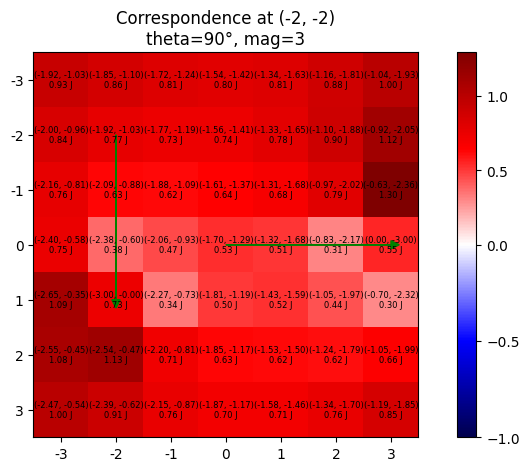

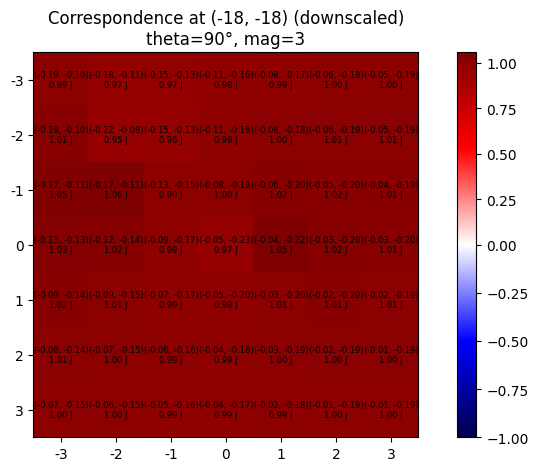

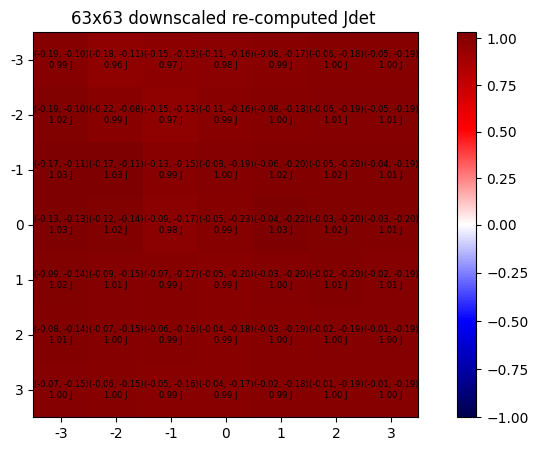

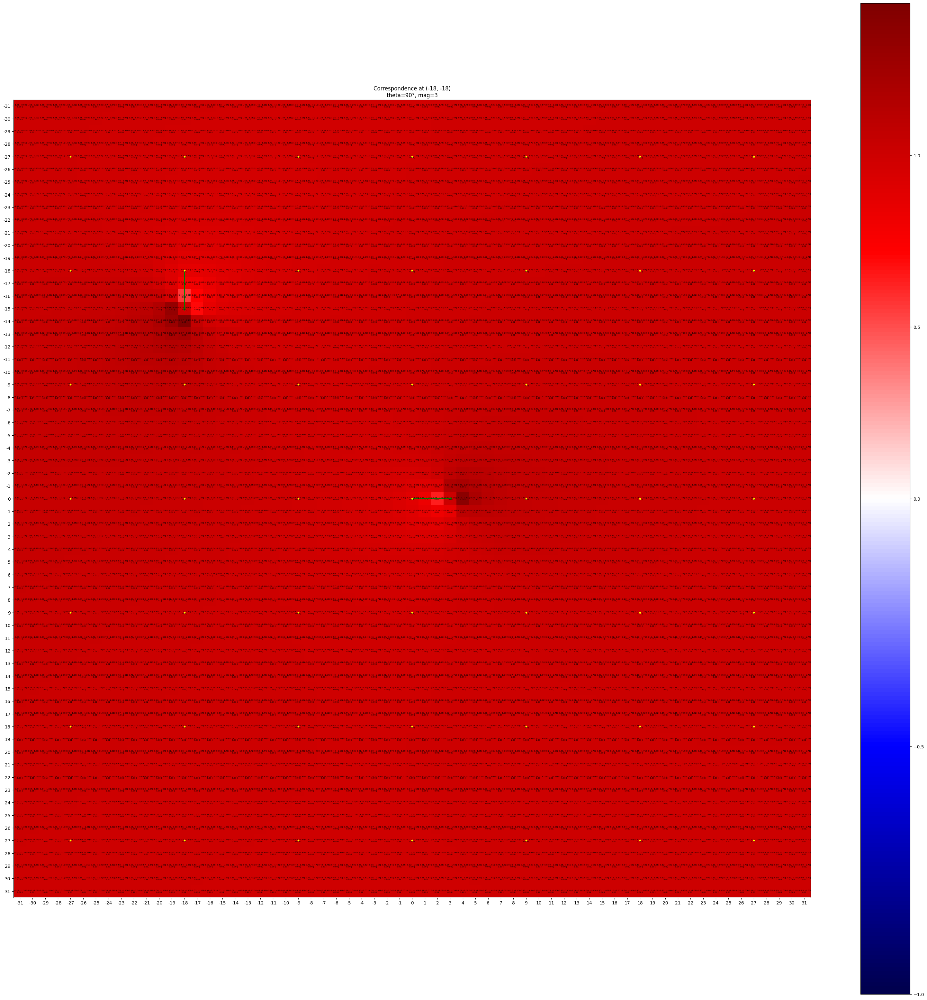

Central Jacobian determinant: 0.8903231732795158


(array([[0.92663456, 0.86111554, 0.81460584, 0.79596236, 0.81466086, 0.88111682, 1.00032165],
        [0.84427681, 0.76793099, 0.73444919, 0.73797428, 0.7822628 , 0.89536913, 1.12104151],
        [0.7639126 , 0.63140802, 0.61811558, 0.64168234, 0.68075217, 0.79435887, 1.29509689],
        [0.747357  , 0.3752875 , 0.46524226, 0.52972944, 0.50841353, 0.30695072, 0.5541673 ],
        [1.09289273, 0.73280091, 0.33825806, 0.50353248, 0.51641631, 0.43576091, 0.3034537 ],
        [1.07822582, 1.12608649, 0.71205612, 0.63196138, 0.61730978, 0.61677647, 0.65609397],
        [0.99648631, 0.90981892, 0.75574781, 0.7000121 , 0.70729144, 0.75762022, 0.85337268]]),
 array([[0.9935448 , 0.97290944, 0.96965873, 0.98084173, 0.99067671, 0.99707094, 1.00097672],
        [1.01453849, 0.95390045, 0.96202409, 0.98826912, 1.00183722, 1.00612229, 1.00699111],
        [1.04567854, 1.05939234, 0.99342747, 1.00069572, 1.02376614, 1.01663117, 1.01158701],
        [1.03356856, 1.0201788 , 0.98970836, 0.96657414, 1

In [39]:
run_case2(oy, ox, angle, magnitude, n=n, x_1_case=USE_X_1_CASE, multiplier=9, base_magnitude=base_magnitude, show_original=True, show_downsampled=True, show_upscaled=True, upscaled_fontsize=4.5, upscaled_figsize=(40, 40), upscaled_offset=4)

Central Jacobian determinant: 0.5297294398735355


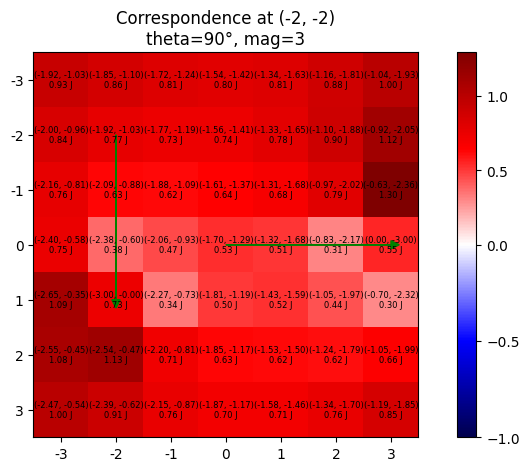

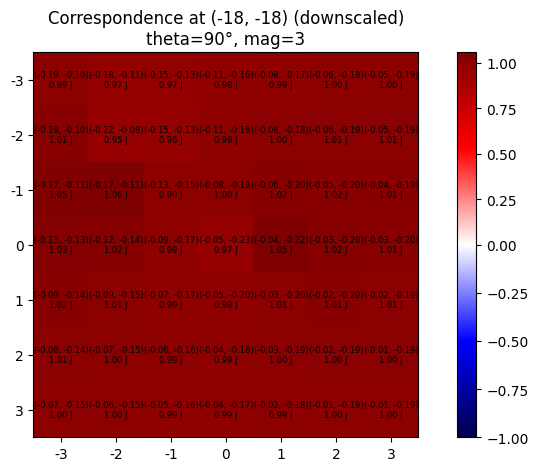

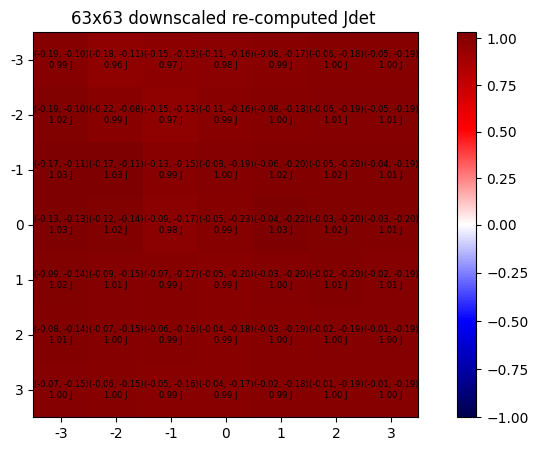

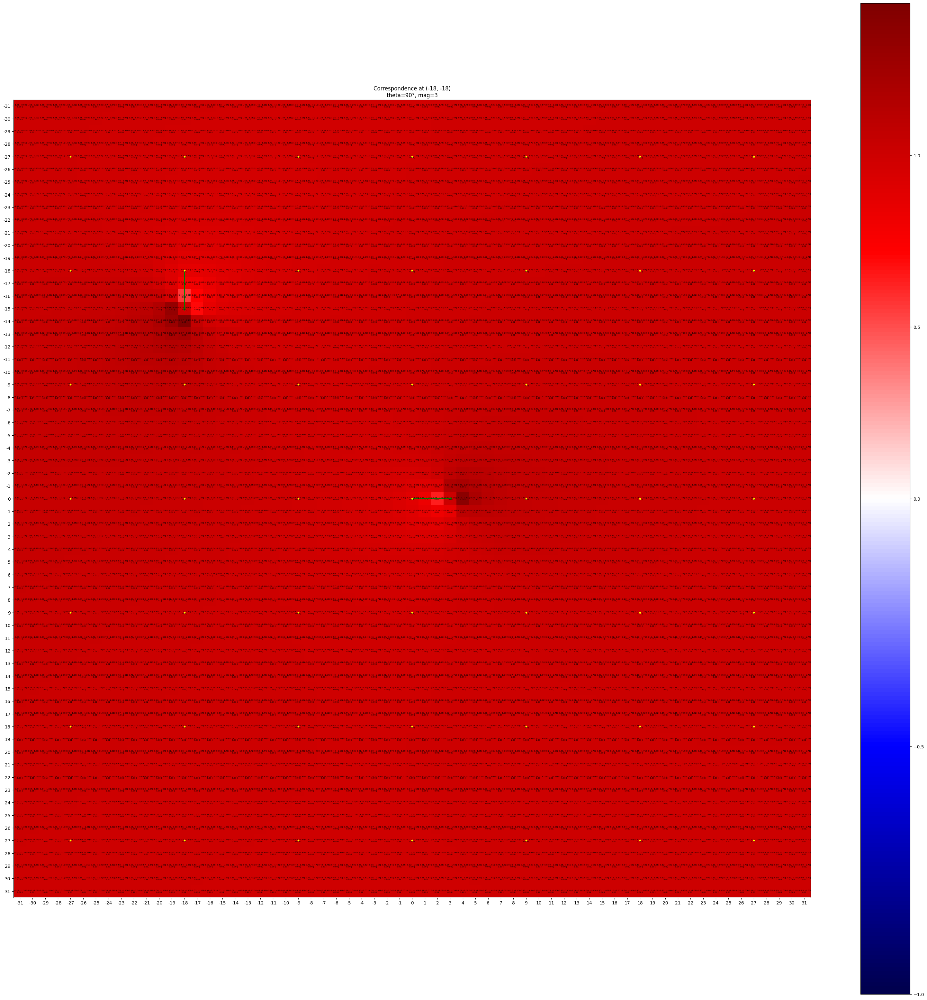

Central Jacobian determinant: 0.8903231732795158


(array([[0.92663456, 0.86111554, 0.81460584, 0.79596236, 0.81466086, 0.88111682, 1.00032165],
        [0.84427681, 0.76793099, 0.73444919, 0.73797428, 0.7822628 , 0.89536913, 1.12104151],
        [0.7639126 , 0.63140802, 0.61811558, 0.64168234, 0.68075217, 0.79435887, 1.29509689],
        [0.747357  , 0.3752875 , 0.46524226, 0.52972944, 0.50841353, 0.30695072, 0.5541673 ],
        [1.09289273, 0.73280091, 0.33825806, 0.50353248, 0.51641631, 0.43576091, 0.3034537 ],
        [1.07822582, 1.12608649, 0.71205612, 0.63196138, 0.61730978, 0.61677647, 0.65609397],
        [0.99648631, 0.90981892, 0.75574781, 0.7000121 , 0.70729144, 0.75762022, 0.85337268]]),
 array([[0.9935448 , 0.97290944, 0.96965873, 0.98084173, 0.99067671, 0.99707094, 1.00097672],
        [1.01453849, 0.95390045, 0.96202409, 0.98826912, 1.00183722, 1.00612229, 1.00699111],
        [1.04567854, 1.05939234, 0.99342747, 1.00069572, 1.02376614, 1.01663117, 1.01158701],
        [1.03356856, 1.0201788 , 0.98970836, 0.96657414, 1

In [40]:
run_case2(oy, ox, angle, magnitude, n=n, x_1_case=USE_X_1_CASE, multiplier=9, base_magnitude=base_magnitude, show_original=True, show_downsampled=True, show_upscaled=True, upscaled_fontsize=4.5, upscaled_figsize=(40, 40), upscaled_offset=4)

Central Jacobian determinant: 0.7918496918843069


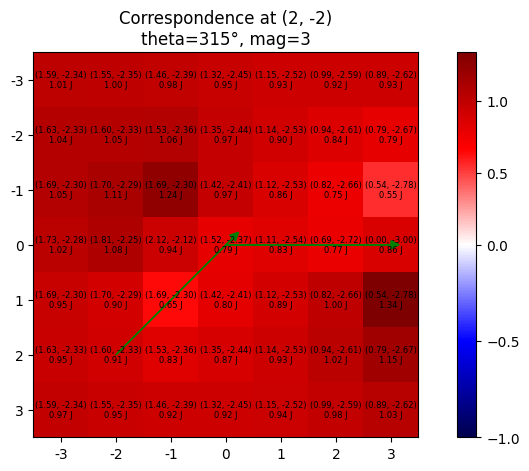

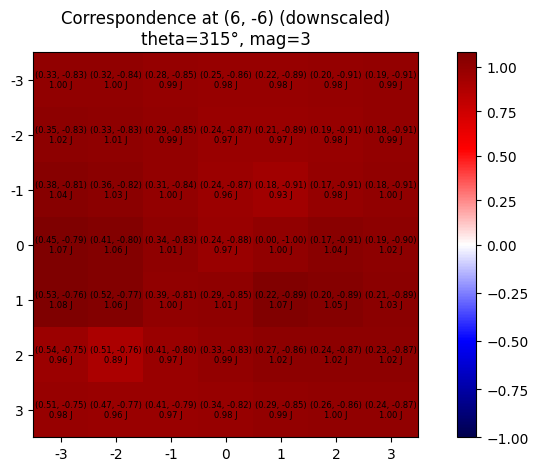

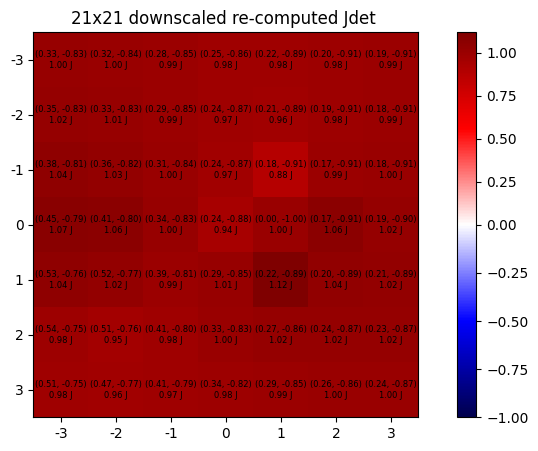

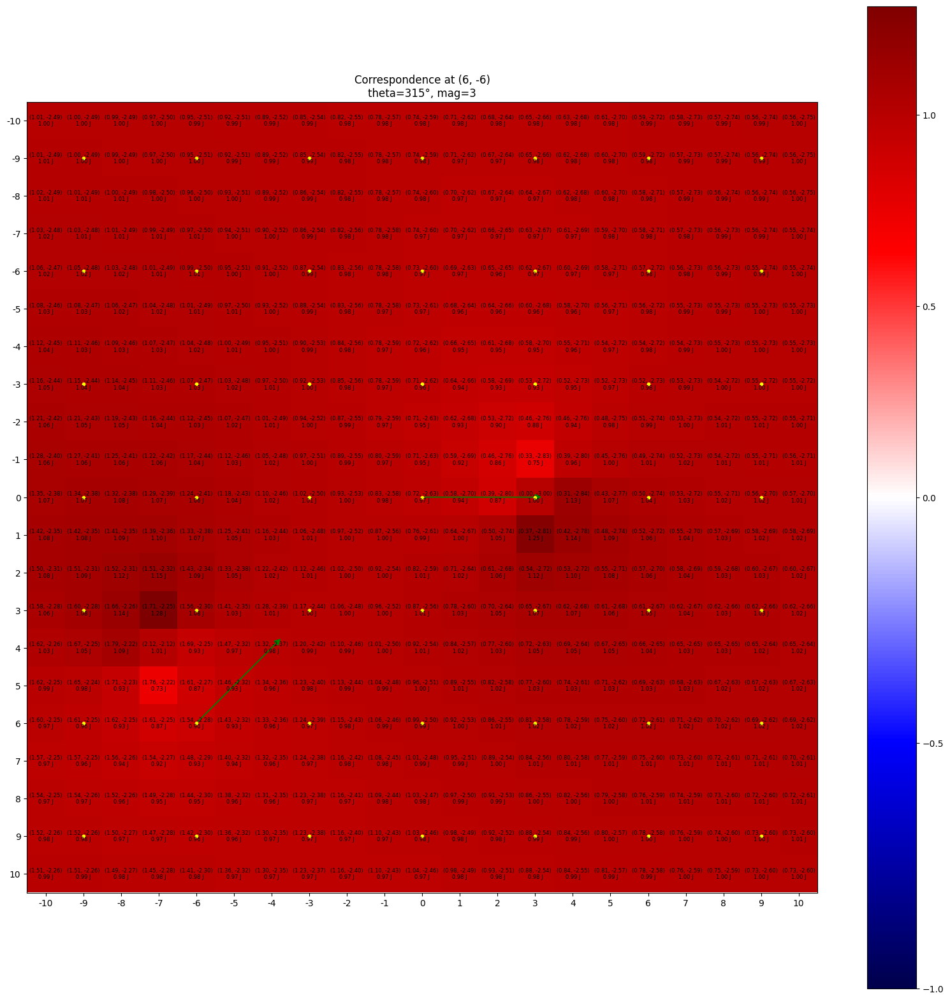

Central Jacobian determinant: 0.9676894990616747


(array([[1.01157142, 0.99914701, 0.98262778, 0.95025074, 0.92641854, 0.91874551, 0.92800199],
        [1.0437354 , 1.05406656, 1.06165579, 0.96864142, 0.89880355, 0.84127974, 0.79178918],
        [1.0544125 , 1.1072516 , 1.2389632 , 0.96512464, 0.86110324, 0.75420836, 0.54701266],
        [1.01768279, 1.07966788, 0.93816617, 0.79184969, 0.82631769, 0.76882375, 0.85817467],
        [0.95210857, 0.89626793, 0.64507456, 0.79776108, 0.88768982, 1.00168277, 1.33593182],
        [0.9471019 , 0.90676628, 0.83482208, 0.86900089, 0.92753462, 1.01518347, 1.14949585],
        [0.97401461, 0.94963886, 0.92102908, 0.91970101, 0.93860032, 0.97812734, 1.03334671]]),
 array([[1.00420525, 0.99755183, 0.98753675, 0.97719757, 0.97551289, 0.98399535, 0.99379715],
        [1.02078817, 1.00959719, 0.99091862, 0.97071323, 0.96560415, 0.97964989, 0.99423292],
        [1.04331342, 1.02669752, 0.9962764 , 0.95604447, 0.93010163, 0.98476625, 1.00111877],
        [1.07448627, 1.05724933, 1.00904249, 0.96975988, 1

In [41]:
# Neighboring correspondence parameters
oy, ox = (2, -2)
angle = 315
magnitude = 3
base_magnitude = 3
MULTIPLIER = 3
USE_X_1_CASE = False


run_case2(oy, ox, angle, magnitude, n=n, x_1_case=USE_X_1_CASE, multiplier=MULTIPLIER, base_magnitude=base_magnitude, show_downsampled=True, show_upscaled=True, upscaled_offset=1)

Central Jacobian determinant: 0.4739916100002858


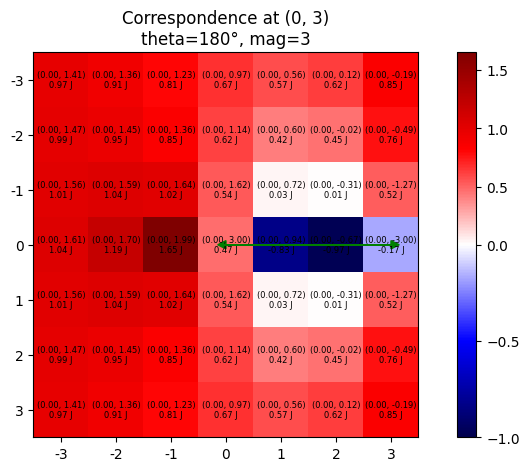

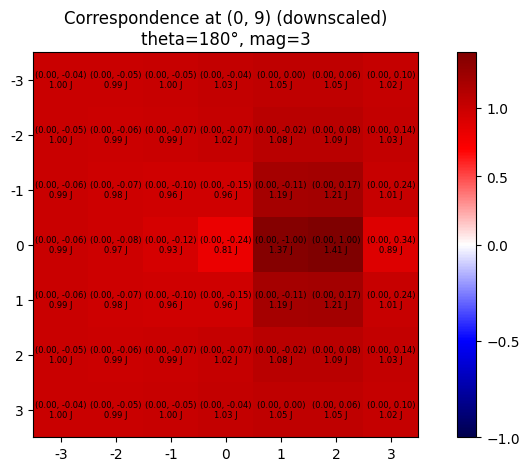

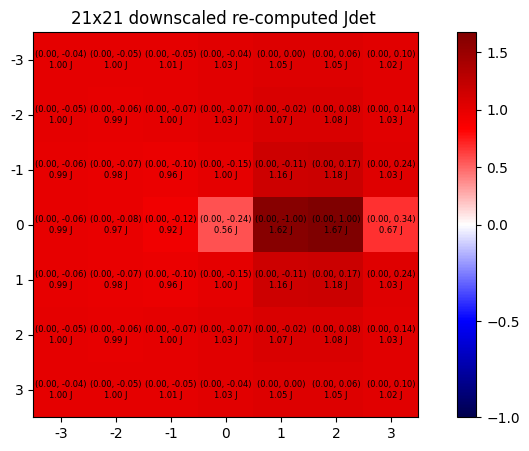

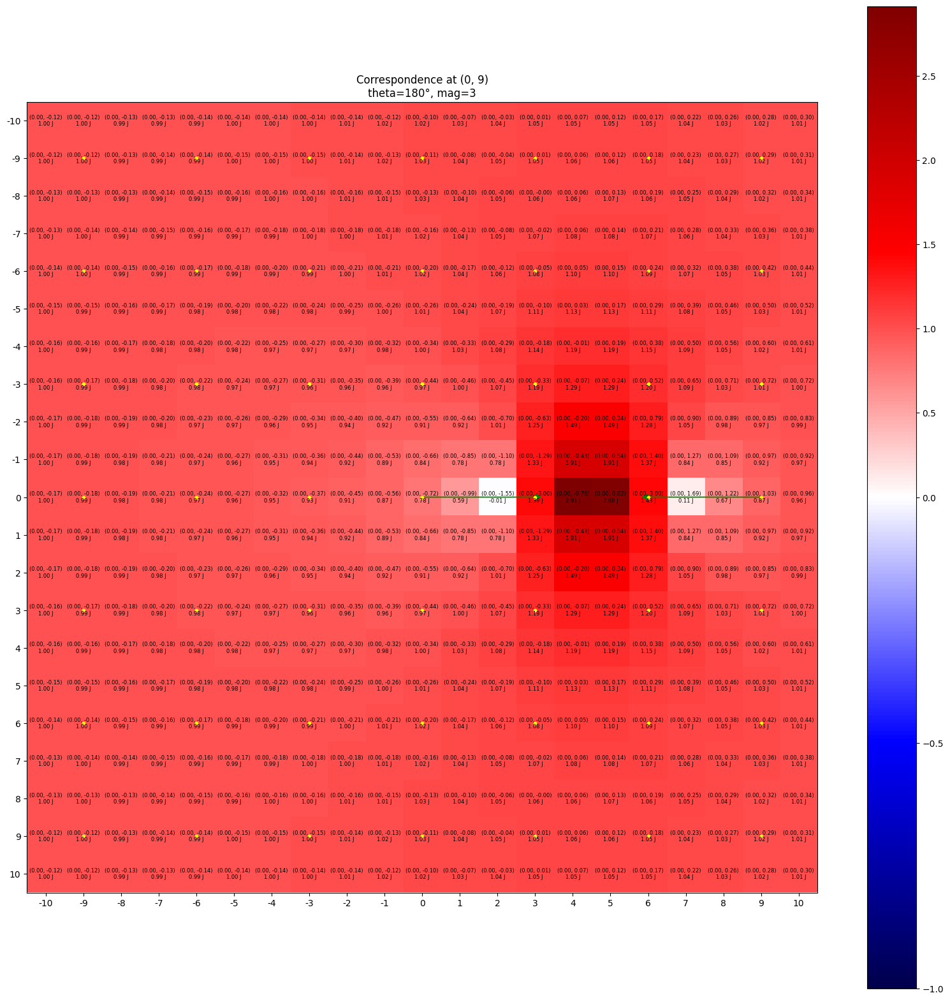

Central Jacobian determinant: 0.7837076434014947


(array([[ 0.97378475,  0.90786398,  0.80640988,  0.66674094,  0.57094012,  0.62291998,  0.84639015],
        [ 0.98605644,  0.94536109,  0.84738069,  0.61803149,  0.41981162,  0.45350034,  0.76364416],
        [ 1.01435759,  1.04261507,  1.01920672,  0.53650011,  0.03347141,  0.00887016,  0.52094961],
        [ 1.04426407,  1.19375393,  1.65219677,  0.47399161, -0.83399519, -0.97109752, -0.16581763],
        [ 1.01435759,  1.04261507,  1.01920672,  0.53650011,  0.03347141,  0.00887016,  0.52094961],
        [ 0.98605644,  0.94536109,  0.84738069,  0.61803149,  0.41981162,  0.45350034,  0.76364416],
        [ 0.97378475,  0.90786398,  0.80640988,  0.66674094,  0.57094012,  0.62291998,  0.84639015]]),
 array([[0.99597563, 0.99446762, 1.00321475, 1.02539666, 1.05254244, 1.05251943, 1.02065089],
        [0.99512589, 0.98809411, 0.99145358, 1.02090595, 1.08335916, 1.08842587, 1.0274873 ],
        [0.99222651, 0.97706521, 0.96103549, 0.96444917, 1.18769052, 1.20569919, 1.00626105],
        [

In [42]:
# Neighboring correspondence parameters
oy, ox = (0, 3)
angle = 180
magnitude = 3
base_magnitude = 3
MULTIPLIER = 3
USE_X_1_CASE = False


run_case2(oy, ox, angle, magnitude, n=n, x_1_case=USE_X_1_CASE, multiplier=MULTIPLIER, base_magnitude=base_magnitude, show_downsampled=True, show_upscaled=True, upscaled_offset=1)

Central Jacobian determinant: 0.4739916100002858


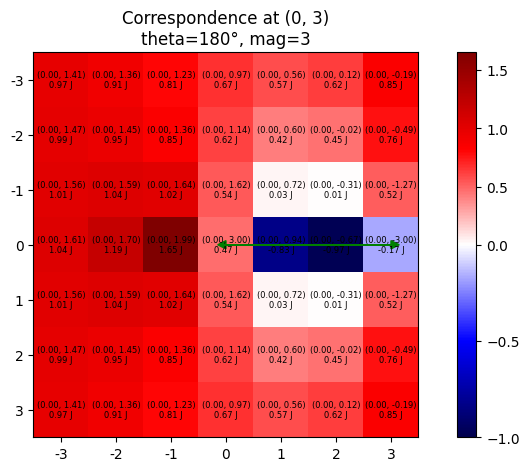

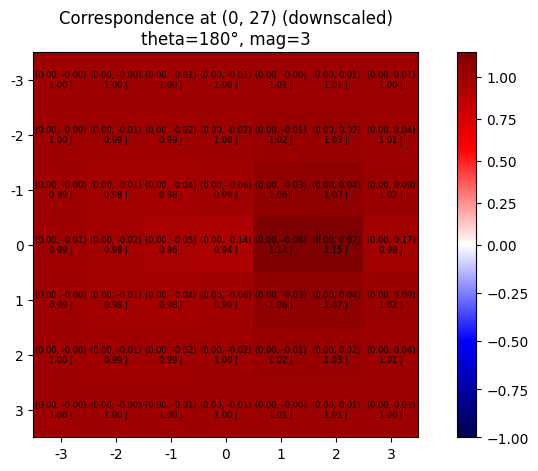

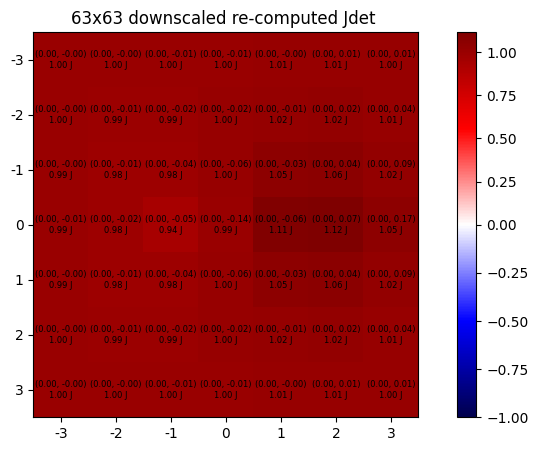

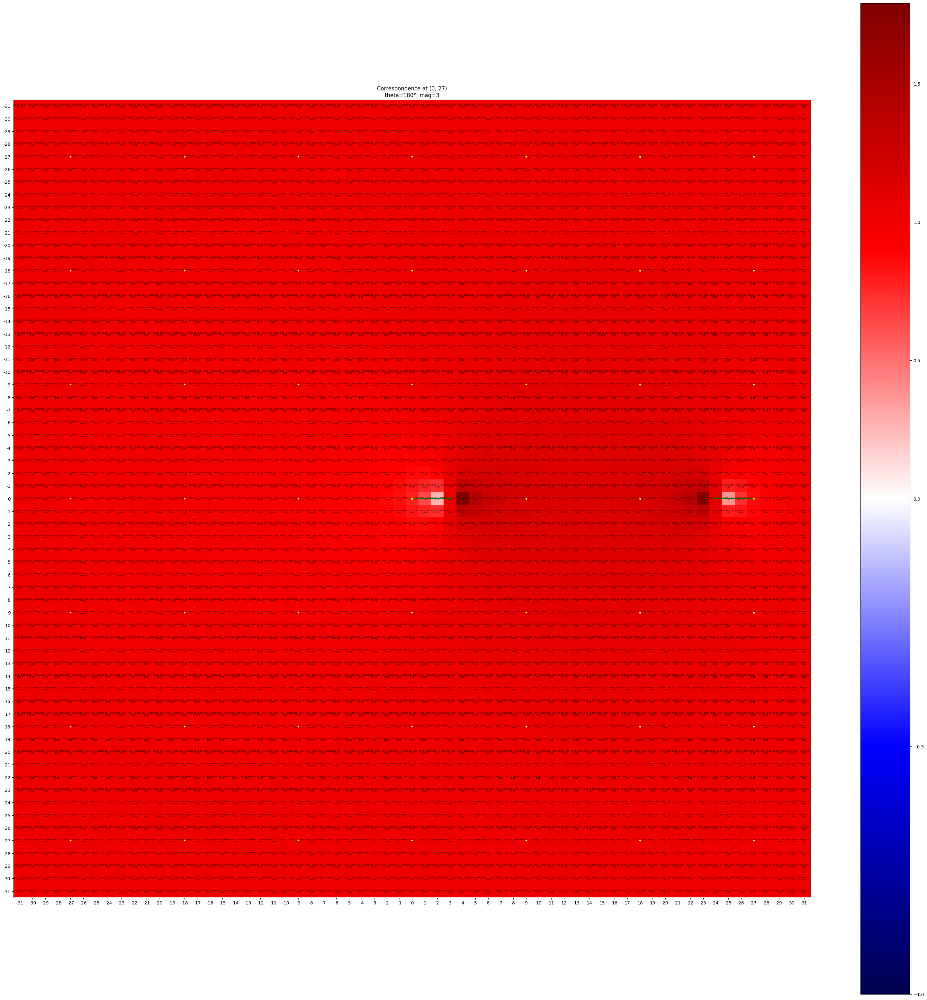

Central Jacobian determinant: 0.7786740049611064


(array([[ 0.97378475,  0.90786398,  0.80640988,  0.66674094,  0.57094012,  0.62291998,  0.84639015],
        [ 0.98605644,  0.94536109,  0.84738069,  0.61803149,  0.41981162,  0.45350034,  0.76364416],
        [ 1.01435759,  1.04261507,  1.01920672,  0.53650011,  0.03347141,  0.00887016,  0.52094961],
        [ 1.04426407,  1.19375393,  1.65219677,  0.47399161, -0.83399519, -0.97109752, -0.16581763],
        [ 1.01435759,  1.04261507,  1.01920672,  0.53650011,  0.03347141,  0.00887016,  0.52094961],
        [ 0.98605644,  0.94536109,  0.84738069,  0.61803149,  0.41981162,  0.45350034,  0.76364416],
        [ 0.97378475,  0.90786398,  0.80640988,  0.66674094,  0.57094012,  0.62291998,  0.84639015]]),
 array([[0.99892666, 0.99656093, 0.99626997, 1.00120174, 1.00836892, 1.01064666, 1.00485064],
        [0.99696723, 0.99209137, 0.99155845, 1.00277879, 1.02165346, 1.02570667, 1.01045281],
        [0.99474254, 0.98479761, 0.97541632, 0.99379396, 1.06076337, 1.06743144, 1.01683103],
        [

In [43]:
run_case2(oy, ox, angle, magnitude, n=n, x_1_case=USE_X_1_CASE, multiplier=9, base_magnitude=base_magnitude, show_original=True, show_downsampled=True, show_upscaled=True, upscaled_fontsize=4.5, upscaled_figsize=(40, 40), upscaled_offset=4)

### Jdet verification

2 2
array([[[ 0.608108  ,  0.60869502,  0.58978397,  0.51417808,  0.44884363,  0.4084681 ,  0.39047264],
        [ 0.60869502,  0.62768551,  0.64672931,  0.5037469 ,  0.42290748,  0.38554444,  0.37138823],
        [ 0.58978397,  0.64672931,  0.86598433,  0.43105159,  0.35421222,  0.34040019,  0.33813783],
        [ 0.51417808,  0.5037469 ,  0.43105159,  0.        ,  0.22245694,  0.28498245,  0.30336871],
        [ 0.44884363,  0.42290748,  0.35421222,  0.22245694,  0.24865662,  0.27414296,  0.28647899],
        [ 0.4084681 ,  0.38554444,  0.34040019,  0.28498245,  0.27414296,  0.2776797 ,  0.28212532],
        [ 0.39047264,  0.37138823,  0.33813783,  0.30336871,  0.28647899,  0.28212532,  0.28295199]],

       [[-0.0537622 , -0.05568917, -0.02475055,  0.10505014,  0.2183103 ,  0.28822919,  0.31996314],
        [-0.05568917, -0.08922937, -0.12274592,  0.12372684,  0.26249168,  0.32696099,  0.35208766],
        [-0.02475055, -0.12274592, -0.49997368,  0.25174514,  0.3829367 ,  0.4058657 

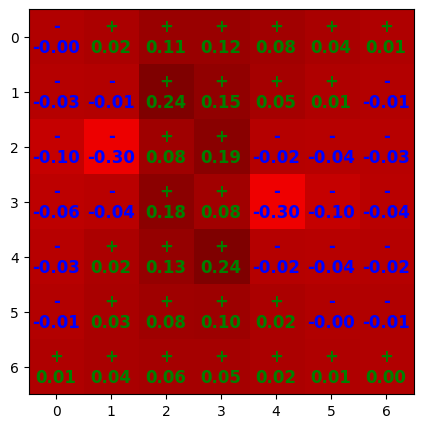

Central Jacobian determinant: 1.0765506961408364


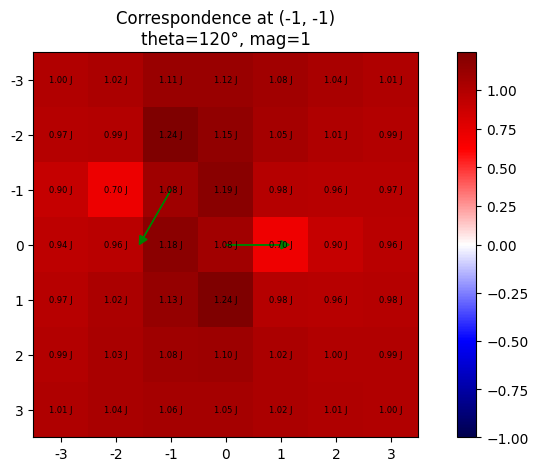

In [49]:
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import pickle
from pprint import pprint

# Load the pickled dictionary from the file
with open('lut_data_case2_7x7.pkl', 'rb') as file:
    loaded_data = pickle.load(file)
    
# Show grid information at a specific index
y, x = (-1, -1)
angle = 120
magnitude = 1
n = 7

# Scale by 3
y = int((y + n // 2))
x = int((x + n // 2))
print(y, x)
#magnitude = magnitude * 3
#n = n * 3
# Get info
deformation, jdet_field = loaded_data[y][x][angle][magnitude]
central_jdet = jdet_field[n//2, n//2]

deform = deformation[1:, 0, :, :]
pprint(deform)
displacement_y = deform[0]
displacement_x = deform[1]

norm = mcolors.TwoSlopeNorm(vmin=min(jdet_field.min(), -1), vcenter=0, vmax=jdet_field.max())
f = plt.figure(figsize=(10, 5))
plt.imshow(jdet_field, cmap='seismic', norm=norm)

def compute_derivatives(i, j, n, displacement_y, displacement_x):
    curr = (displacement_y[j, i], displacement_x[j, i])
    if i == 0 and j == 0:  # Top-left corner
        right = (displacement_y[j, i+1], displacement_x[j, i+1])
        down = (displacement_y[j+1, i], displacement_x[j+1, i])
        dxdx = (right[1] - curr[1]) / 2
        dydx = (right[0] - curr[0]) / 2
        dydy = (down[0] - curr[0]) / 2
        dxdy = (down[1] - curr[1]) / 2
    elif i == n - 1 and j == 0:  # Top-right corner
        left = (displacement_y[j, i-1], displacement_x[j, i-1])
        down = (displacement_y[j+1, i], displacement_x[j+1, i])
        dxdx = (curr[1] - left[1]) / 2
        dydx = (curr[0] - left[0]) / 2
        dydy = (down[0] - curr[0]) / 2
        dxdy = (down[1] - curr[1]) / 2
    elif i == 0 and j == n - 1:  # Bottom-left corner
        right = (displacement_y[j, i+1], displacement_x[j, i+1])
        up = (displacement_y[j-1, i], displacement_x[j-1, i])
        dxdx = (right[1] - curr[1]) / 2
        dydx = (right[0] - curr[0]) / 2
        dydy = (curr[0] - up[0]) / 2
        dxdy = (curr[1] - up[1]) / 2
    elif i == n - 1 and j == n - 1:  # Bottom-right corner
        left = (displacement_y[j, i-1], displacement_x[j, i-1])
        up = (displacement_y[j-1, i], displacement_x[j-1, i])
        dxdx = (curr[1] - left[1]) / 2
        dydx = (curr[0] - left[0]) / 2
        dydy = (curr[0] - up[0]) / 2
        dxdy = (curr[1] - up[1]) / 2
    elif i == 0:  # Left edge
        right = (displacement_y[j, i+1], displacement_x[j, i+1])
        up = (displacement_y[j-1, i], displacement_x[j-1, i])
        down = (displacement_y[j+1, i], displacement_x[j+1, i])
        dxdx = (right[1] - curr[1]) / 2
        dydx = (right[0] - curr[0]) / 2
        dydy = (down[0] - up[0]) / 2
        dxdy = (down[1] - up[1]) / 2
    elif j == 0:  # Top edge
        down = (displacement_y[j+1, i], displacement_x[j+1, i])
        right = (displacement_y[j, i+1], displacement_x[j, i+1])
        left = (displacement_y[j, i-1], displacement_x[j, i-1])
        dxdx = (right[1] - left[1]) / 2
        dydx = (right[0] - left[0]) / 2
        dydy = (down[0] - curr[0]) / 2
        dxdy = (down[1] - curr[1]) / 2
    elif i == n - 1:  # Right edge
        left = (displacement_y[j, i-1], displacement_x[j, i-1])
        up = (displacement_y[j-1, i], displacement_x[j-1, i])
        down = (displacement_y[j+1, i], displacement_x[j+1, i])
        dxdx = (curr[1] - left[1]) / 2
        dydx = (curr[0] - left[0]) / 2
        dydy = (down[0] - up[0]) / 2
        dxdy = (down[1] - up[1]) / 2
    elif j == n - 1:  # Bottom edge
        up = (displacement_y[j-1, i], displacement_x[j-1, i])
        right = (displacement_y[j, i+1], displacement_x[j, i+1])
        left = (displacement_y[j, i-1], displacement_x[j, i-1])
        dxdx = (right[1] - left[1]) / 2
        dydx = (right[0] - left[0]) / 2
        dydy = (curr[0] - up[0]) / 2
        dxdy = (curr[1] - up[1]) / 2
    else:  # Interior points
        right = (displacement_y[j, i+1], displacement_x[j, i+1])
        left = (displacement_y[j, i-1], displacement_x[j, i-1])
        up = (displacement_y[j-1, i], displacement_x[j-1, i])
        down = (displacement_y[j+1, i], displacement_x[j+1, i])
        dxdx = (right[1] - left[1]) / 2
        dydy = (down[0] - up[0]) / 2
        dxdy = (down[1] - up[1]) / 2
        dydx = (right[0] - left[0]) / 2
    return dxdx, dydy, dxdy, dydx

for j in range(n):
    for i in range(n):
        dxdx, dydy, dxdy, dydx = compute_derivatives(i, j, n, displacement_y, displacement_x)
        monotonic_func = dxdx * dydy - dxdy * dydx
        linear_term = dxdx + dydy
        monotonic_func = monotonic_func + linear_term
        print(monotonic_func)
        
        text_color = 'black'
        if monotonic_func < 0:
            monotonic_func_str = "-\n"
            text_color = 'blue'
        elif monotonic_func > 0:
            monotonic_func_str = "+\n"
            text_color = 'green'
        monotonic_func_str += f"{monotonic_func:.2f}"
        
        plt.text(i, j, monotonic_func_str, color=text_color, ha='center', va='center', fontsize=12, weight='bold')
            
plt.show()
f.clear()
plt.close(f)

print("Central Jacobian determinant:", central_jdet)
show_data(loaded_data, y, x, angle, magnitude, 
          title=f"Correspondence at ({y - n // 2}, {x - n // 2})\ntheta={angle}°, mag={magnitude}", fontsize=6)

2 2
array([[[ 0.608108  ,  0.60869502,  0.58978397,  0.51417808,  0.44884363,  0.4084681 ,  0.39047264],
        [ 0.60869502,  0.62768551,  0.64672931,  0.5037469 ,  0.42290748,  0.38554444,  0.37138823],
        [ 0.58978397,  0.64672931,  0.86598433,  0.43105159,  0.35421222,  0.34040019,  0.33813783],
        [ 0.51417808,  0.5037469 ,  0.43105159,  0.        ,  0.22245694,  0.28498245,  0.30336871],
        [ 0.44884363,  0.42290748,  0.35421222,  0.22245694,  0.24865662,  0.27414296,  0.28647899],
        [ 0.4084681 ,  0.38554444,  0.34040019,  0.28498245,  0.27414296,  0.2776797 ,  0.28212532],
        [ 0.39047264,  0.37138823,  0.33813783,  0.30336871,  0.28647899,  0.28212532,  0.28295199]],

       [[-0.0537622 , -0.05568917, -0.02475055,  0.10505014,  0.2183103 ,  0.28822919,  0.31996314],
        [-0.05568917, -0.08922937, -0.12274592,  0.12372684,  0.26249168,  0.32696099,  0.35208766],
        [-0.02475055, -0.12274592, -0.49997368,  0.25174514,  0.3829367 ,  0.4058657 

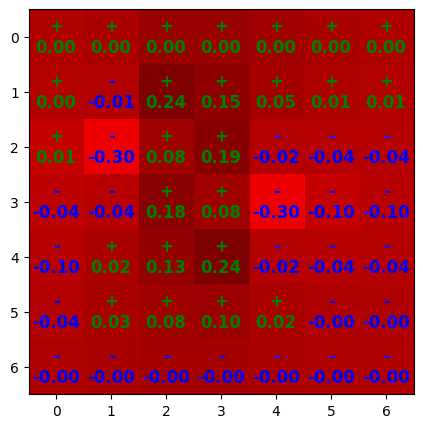

Central Jacobian determinant: 1.0765506961408364


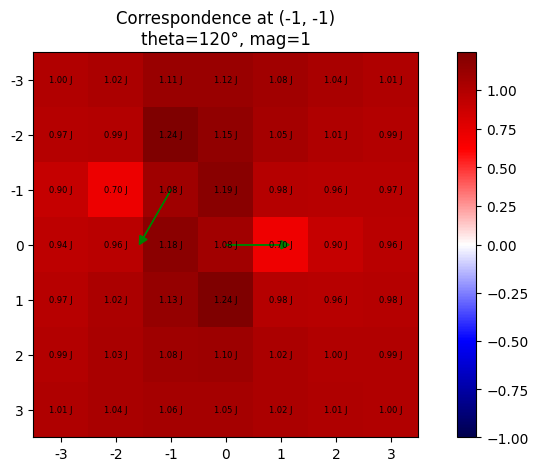

In [114]:
# Load the pickled dictionary from the file
with open('lut_data_case2_7x7.pkl', 'rb') as file:
    loaded_data = pickle.load(file)
    
# Show grid information at a specific index
y, x = (-1, -1)
angle = 120
magnitude = 1
n = 7

# Scale by 3
y = int((y + n // 2))
x = int((x + n // 2))
print(y, x)
#magnitude = magnitude * 3
#n = n * 3
# Get info
deformation, jdet_field = loaded_data[y][x][angle][magnitude]
central_jdet = jdet_field[n//2, n//2]

deform = deformation[1:, 0, :, :]
pprint(deform)
displacement_y = deform[0]
displacement_x = deform[1]

norm = mcolors.TwoSlopeNorm(vmin=min(jdet_field.min(), -1), vcenter=0, vmax=jdet_field.max())
f = plt.figure(figsize=(10, 5))
plt.imshow(jdet_field, cmap='seismic', norm=norm)
for j in range(n):
    for i in range(n):
        # Compute monotonic derivative
        curr = (displacement_y[j, i], displacement_x[j, i])
        if i != 0 and i < n - 1 and j != 0 and j < n - 1:
            right = (displacement_y[j, i+1], displacement_x[j, i+1])
            left = (displacement_y[j, i-1], displacement_x[j, i-1])
            up = (displacement_y[j-1, i], displacement_x[j-1, i])
            down = (displacement_y[j+1, i], displacement_x[j+1, i])
            dxdx = (right[1] - left[1]) / 2
            dydy = (down[0] - up[0]) / 2
            dxdy = (down[1] - up[1]) / 2
            dydx = (right[0] - left[0]) / 2
            #print(dxdx, dydy, dxdy, dydx)
            
        monotonic_func = dxdx * dydy - dxdy * dydx
        linear_term = dxdx + dydy
        monotonic_func = monotonic_func + linear_term
        print(monotonic_func)
        
        text_color = 'black'
        if monotonic_func < 0:
            monotonic_func_str = "-\n"
            text_color = 'blue'
        elif monotonic_func > 0:
            monotonic_func_str = "+\n"
            text_color = 'green'
        monotonic_func_str += f"{monotonic_func:.2f}"
        
        plt.text(i, j, monotonic_func_str, color=text_color, ha='center', va='center', fontsize=12, weight='bold')
            #if monotonic_func > 0:
            #    plt.scatter(i, j, color='green', s=10)
            #else:
            #    plt.scatter(i, j, color='blue', s=10)
            
        #plt.text(i, j, f"({displacement_y[j, i]:.2f}, {displacement_x[j, i]:.2f})", color='black', ha='center', va='center', fontsize=12, weight='normal')
plt.show()
f.clear()
plt.close(f)

print("Central Jacobian determinant:", central_jdet)
show_data(loaded_data, y, x, angle, magnitude, 
          title=f"Correspondence at ({y - n // 2}, {x - n // 2})\ntheta={angle}°, mag={magnitude}", fontsize=6)

### Phi scaling

In [6]:
def compute_derivatives(i, j, n, displacement_y, displacement_x):
    curr = (displacement_y[j, i], displacement_x[j, i])
    if i == 0 and j == 0:  # Top-left corner
        right = (displacement_y[j, i+1], displacement_x[j, i+1])
        down = (displacement_y[j+1, i], displacement_x[j+1, i])
        dxdx = (right[1] - curr[1]) / 2
        dydx = (right[0] - curr[0]) / 2
        dydy = (down[0] - curr[0]) / 2
        dxdy = (down[1] - curr[1]) / 2
    elif i == n - 1 and j == 0:  # Top-right corner
        left = (displacement_y[j, i-1], displacement_x[j, i-1])
        down = (displacement_y[j+1, i], displacement_x[j+1, i])
        dxdx = (curr[1] - left[1]) / 2
        dydx = (curr[0] - left[0]) / 2
        dydy = (down[0] - curr[0]) / 2
        dxdy = (down[1] - curr[1]) / 2
    elif i == 0 and j == n - 1:  # Bottom-left corner
        right = (displacement_y[j, i+1], displacement_x[j, i+1])
        up = (displacement_y[j-1, i], displacement_x[j-1, i])
        dxdx = (right[1] - curr[1]) / 2
        dydx = (right[0] - curr[0]) / 2
        dydy = (curr[0] - up[0]) / 2
        dxdy = (curr[1] - up[1]) / 2
    elif i == n - 1 and j == n - 1:  # Bottom-right corner
        left = (displacement_y[j, i-1], displacement_x[j, i-1])
        up = (displacement_y[j-1, i], displacement_x[j-1, i])
        dxdx = (curr[1] - left[1]) / 2
        dydx = (curr[0] - left[0]) / 2
        dydy = (curr[0] - up[0]) / 2
        dxdy = (curr[1] - up[1]) / 2
    elif i == 0:  # Left edge
        right = (displacement_y[j, i+1], displacement_x[j, i+1])
        up = (displacement_y[j-1, i], displacement_x[j-1, i])
        down = (displacement_y[j+1, i], displacement_x[j+1, i])
        dxdx = (right[1] - curr[1]) / 2
        dydx = (right[0] - curr[0]) / 2
        dydy = (down[0] - up[0]) / 2
        dxdy = (down[1] - up[1]) / 2
    elif j == 0:  # Top edge
        down = (displacement_y[j+1, i], displacement_x[j+1, i])
        right = (displacement_y[j, i+1], displacement_x[j, i+1])
        left = (displacement_y[j, i-1], displacement_x[j, i-1])
        dxdx = (right[1] - left[1]) / 2
        dydx = (right[0] - left[0]) / 2
        dydy = (down[0] - curr[0]) / 2
        dxdy = (down[1] - curr[1]) / 2
    elif i == n - 1:  # Right edge
        left = (displacement_y[j, i-1], displacement_x[j, i-1])
        up = (displacement_y[j-1, i], displacement_x[j-1, i])
        down = (displacement_y[j+1, i], displacement_x[j+1, i])
        dxdx = (curr[1] - left[1]) / 2
        dydx = (curr[0] - left[0]) / 2
        dydy = (down[0] - up[0]) / 2
        dxdy = (down[1] - up[1]) / 2
    elif j == n - 1:  # Bottom edge
        up = (displacement_y[j-1, i], displacement_x[j-1, i])
        right = (displacement_y[j, i+1], displacement_x[j, i+1])
        left = (displacement_y[j, i-1], displacement_x[j, i-1])
        dxdx = (right[1] - left[1]) / 2
        dydx = (right[0] - left[0]) / 2
        dydy = (curr[0] - up[0]) / 2
        dxdy = (curr[1] - up[1]) / 2
    else:  # Interior points
        right = (displacement_y[j, i+1], displacement_x[j, i+1])
        left = (displacement_y[j, i-1], displacement_x[j, i-1])
        up = (displacement_y[j-1, i], displacement_x[j-1, i])
        down = (displacement_y[j+1, i], displacement_x[j+1, i])
        dxdx = (right[1] - left[1]) / 2
        dydy = (down[0] - up[0]) / 2
        dxdy = (down[1] - up[1]) / 2
        dydx = (right[0] - left[0]) / 2
    return dxdx, dydy, dxdy, dydx

In [7]:
from skimage.measure import block_reduce
from scipy.ndimage import uniform_filter

def create_case_phi_scaled(y: int, x: int, angle: int, magnitude: float, base_mpoints: np.ndarray, base_fpoints: np.ndarray, n: int=7, pad=True, base_magnitude=1, x_1_case=False, phi_scale=2):
    """
    Create a case for the given parameters.
    
    Parameters:
    y (int): The y-coordinate of the pixel.
    x (int): The x-coordinate of the pixel.
    angle (int): The angle of the vector (degrees).
    magnitude (float): The magnitude of the vector.
    base_mpoints (np.ndarray): The base moving points.
    base_fpoints (np.ndarray): The base fixed points.
    n (int): The size of the grid.
    
    Returns:
    np.ndarray: The deformation field.
    np.ndarray: The Jacobian determinant field.
    """
    fixed_resolution = np.zeros((1, n, n))
    # Create the correspondence and apply as the second correspondence in the grid
    mpoint, fpoint = _create_correspondence2(y, x, angle, magnitude, n)
    
    #x_1_case = False
    if x_1_case:
        if base_fpoints is None:
            base_fpoints = np.array([[0, n // 2, n // 2 + base_magnitude - 1]])  # x - 1 case
        if base_mpoints is None:
            #base_mpoints = np.array([[0, n // 2, n // 2 - base_magnitude]])
            base_mpoints = np.array([[0, n // 2, n // 2 - 1]])
    else:  # else normal case
        if base_fpoints is None:
            base_fpoints = np.array([[0, n // 2, n // 2 + base_magnitude]])
        if base_mpoints is None:
            base_mpoints = np.array([[0, n // 2, n // 2]])
        
        
    curr_mpoints = base_mpoints.copy()
    curr_fpoints = base_fpoints.copy()
    curr_mpoints = np.append(curr_mpoints, [mpoint], axis=0)
    curr_fpoints = np.append(curr_fpoints, [fpoint], axis=0)
    # Run Laplacian and Jacobian determinant calculations and save the Jacobian determinant field
    deformation, _, _, _, _ = laplacian.sliceToSlice3DLaplacian(fixed_resolution, curr_mpoints, curr_fpoints)
    scaled_deformation = deformation.copy()
    scaled_deformation[:, 0, :, :] = deformation[:, 0, :, :] * phi_scale
    scaled_jdet_field = jacobian.sitk_jacobian_determinant(scaled_deformation)[0]
    return scaled_deformation, scaled_jdet_field


def run_case3_phi_scaling(oy, ox, angle, magnitude, n=7, x_1_case = False, phi_scale=2, base_magnitude=1, title="", show_arrows=True, show_derivative=True): 
    #############################################
    # Case 2: base x

    # Run the case
    y = oy + n // 2  # Get central coordinates
    x = ox + n // 2
    #deformation, jdet_field_original = create_case2(y, x, angle, magnitude, None, None, n=7, base_magnitude=base_magnitude, x_1_case=x_1_case)
    scaled_deformation, scaled_jdet_field = create_case_phi_scaled(y, x, angle, magnitude, None, None, n=7, base_magnitude=base_magnitude, x_1_case=x_1_case, phi_scale=phi_scale)
    
    deform = scaled_deformation[1:, 0, :, :]
    displacement_y = deform[0]
    displacement_x = deform[1]
    
    show_data2(scaled_deformation, scaled_jdet_field, y, x, angle, magnitude, base_magnitude=base_magnitude,
            title=title, fontsize=6, figsize=(10, 5), show_arrows=show_arrows)
    
    if show_derivative:
        f = plt.figure(figsize=(10, 5))
        plt.imshow(scaled_jdet_field, cmap='seismic', norm=mcolors.TwoSlopeNorm(vmin=min(scaled_jdet_field.min(), -1), vcenter=0, vmax=scaled_jdet_field.max()))
        plt.colorbar()
        plt.title(f"Derivative of Jacobian determinant for {phi_scale} * phi")
        for j in range(n):
            for i in range(n):
                dxdx, dydy, dxdy, dydx = compute_derivatives(i, j, n, displacement_y, displacement_x)
                monotonic_func = 2 * dxdx * dydy # - dxdy * dydx
                linear_term = dxdx + dydy
                monotonic_func = monotonic_func + linear_term
                
                text_color = 'black'
                monotonic_func_str = "\n"
                if monotonic_func < 0:
                    monotonic_func_str = "-\n"
                    text_color = 'blue'
                elif monotonic_func > 0:
                    monotonic_func_str = "+\n"
                    text_color = 'green'
                monotonic_func_str += f"{monotonic_func:.2f}"
                plt.text(i, j, monotonic_func_str, color=text_color, ha='center', va='center', fontsize=12, weight='bold')
        
        plt.show()
        f.clear()
        plt.close(f)

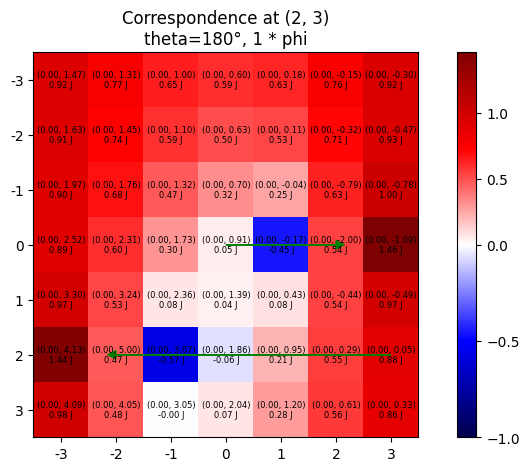

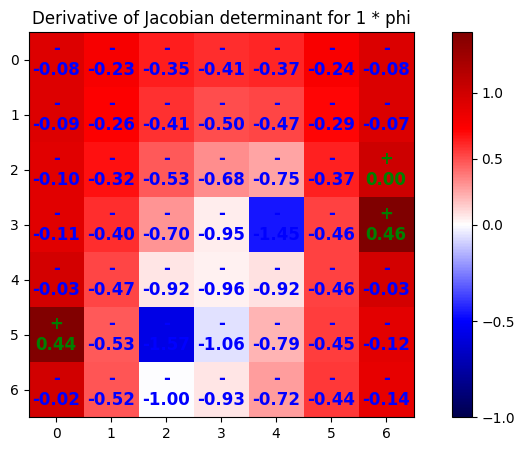

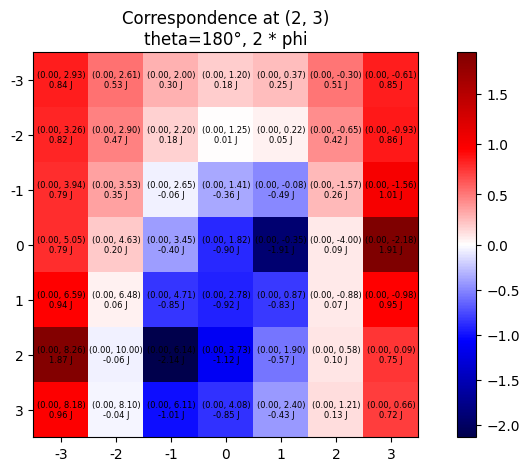

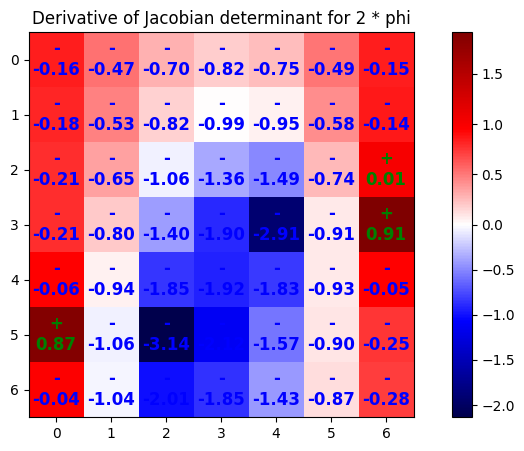

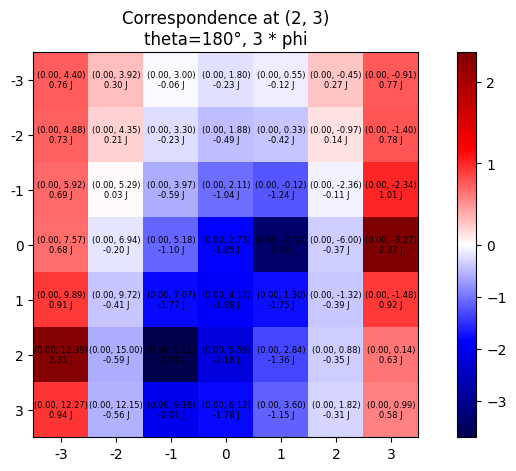

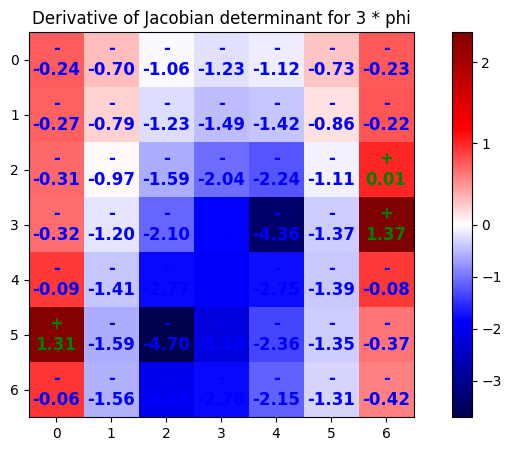

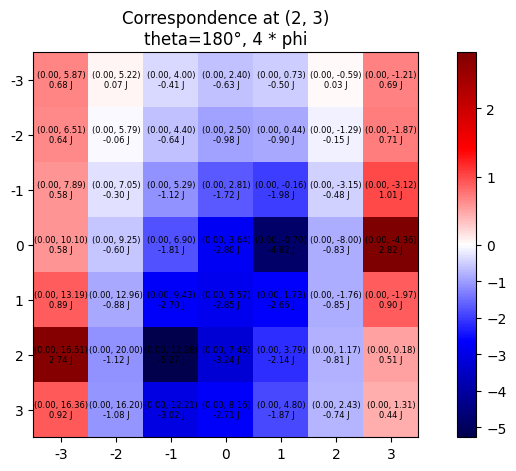

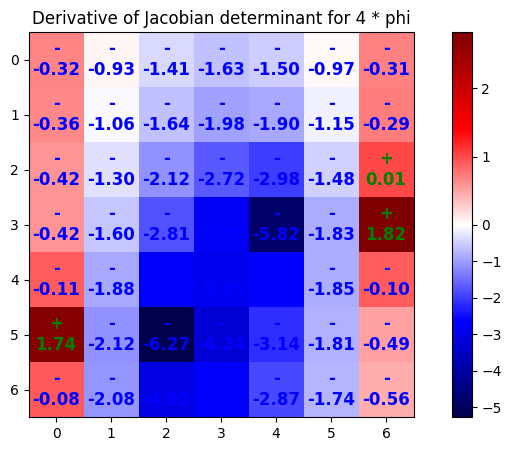

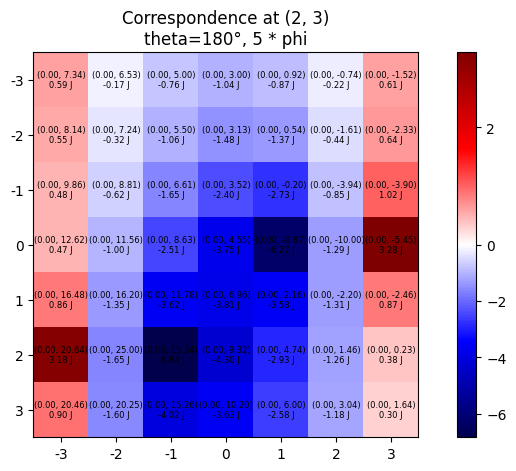

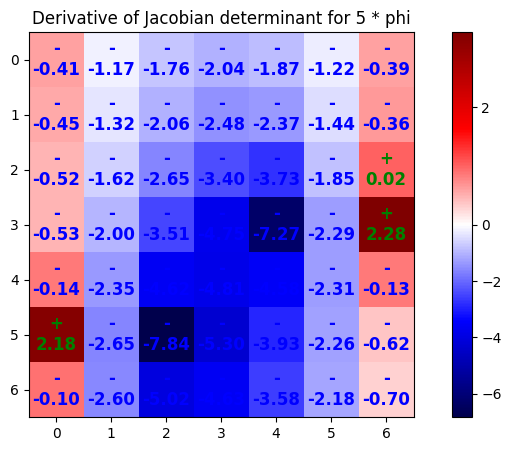

In [9]:
# Neighboring correspondence parameters
oy, ox = (2, 3)
angle = 180
magnitude = 5
base_magnitude = 2
MULTIPLIER = 3
USE_X_1_CASE = False
n = 7

for i in range(1, 6):
    show_original = i == 1
    run_case3_phi_scaling(oy, ox, angle, magnitude, n=n, x_1_case=USE_X_1_CASE, base_magnitude=base_magnitude, phi_scale=i, 
                        title=f"Correspondence at ({oy}, {ox})\ntheta={angle}°, {i} * phi", show_arrows=show_original, show_derivative=True)

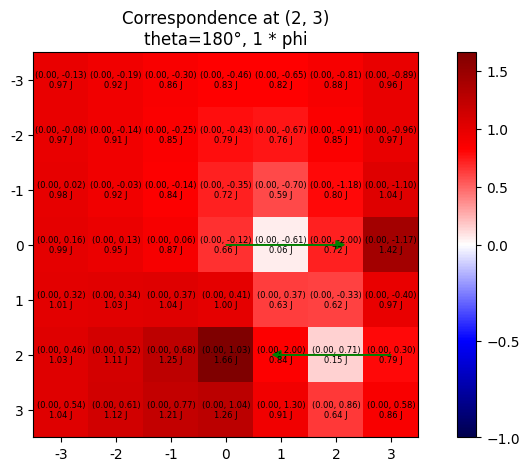

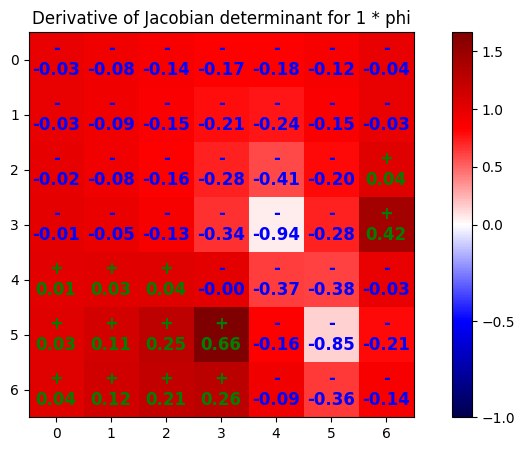

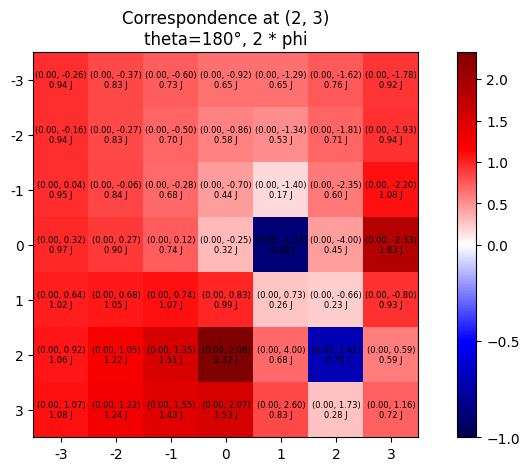

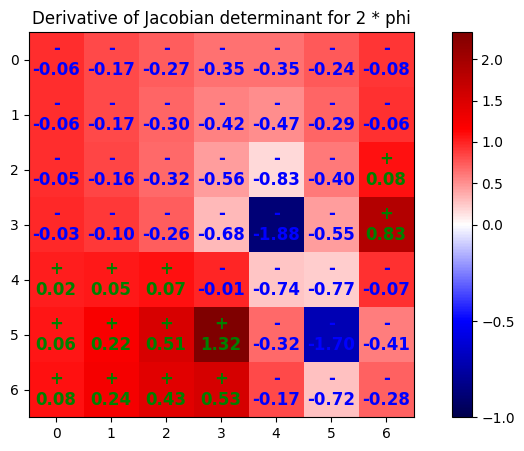

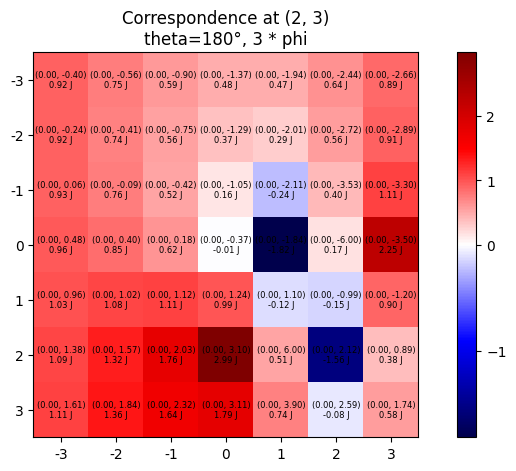

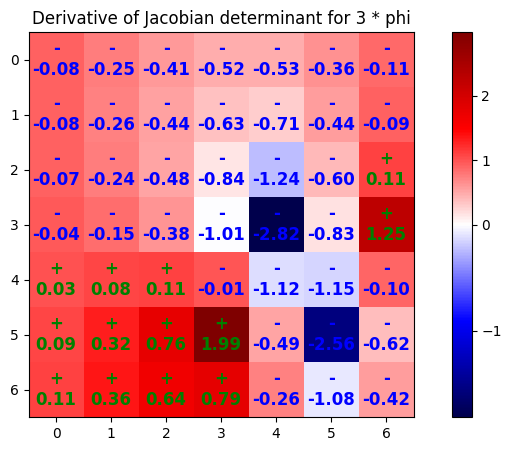

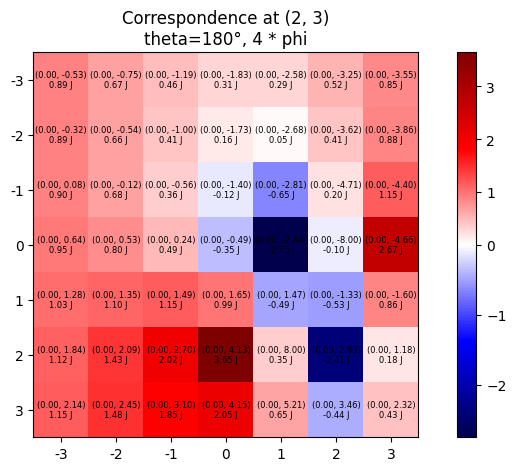

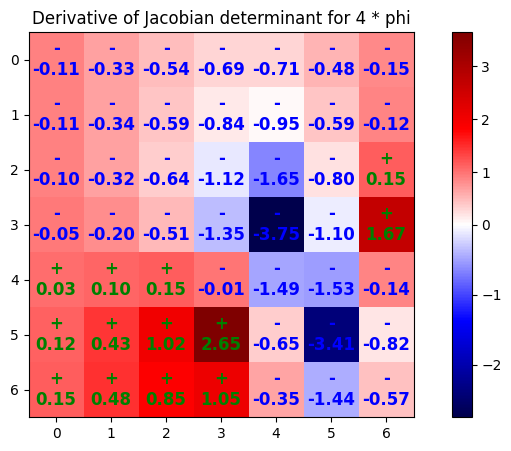

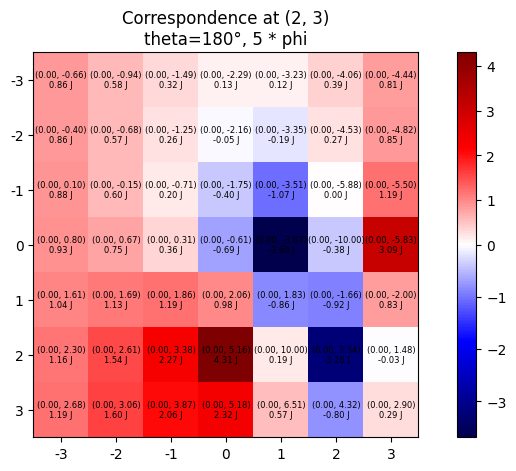

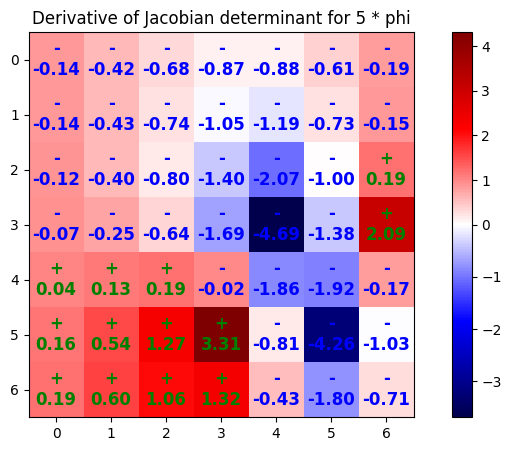

In [8]:
# Neighboring correspondence parameters
oy, ox = (2, 3)
angle = 180
magnitude = 2
base_magnitude = 2
MULTIPLIER = 3
USE_X_1_CASE = False
n = 7

for i in range(1, 6):
    show_original = i == 1
    run_case3_phi_scaling(oy, ox, angle, magnitude, n=n, x_1_case=USE_X_1_CASE, base_magnitude=base_magnitude, phi_scale=i, 
                        title=f"Correspondence at ({oy}, {ox})\ntheta={angle}°, {i} * phi", show_arrows=show_original, show_derivative=True)

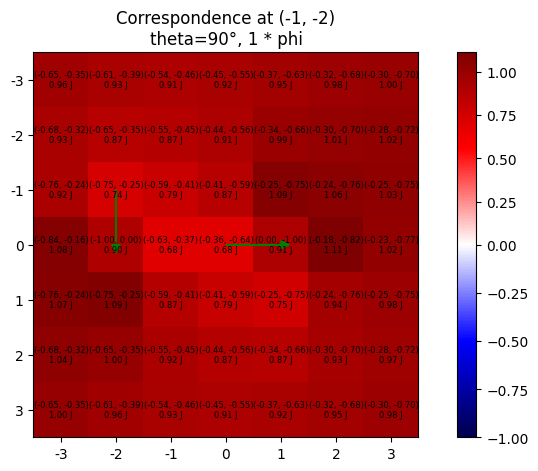

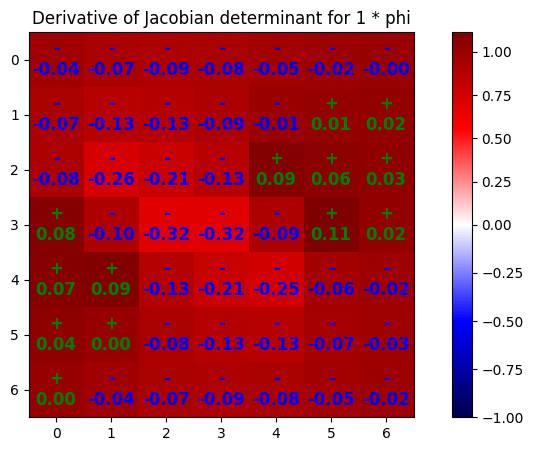

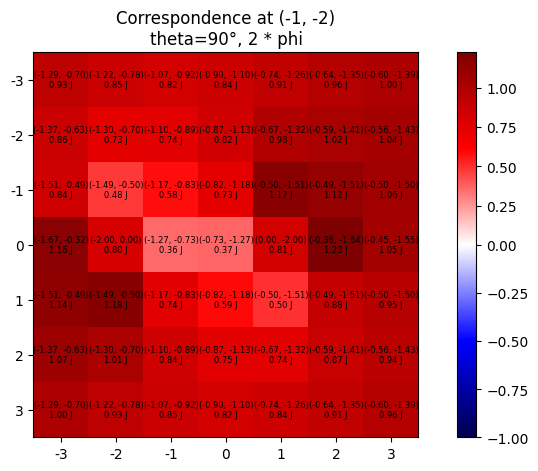

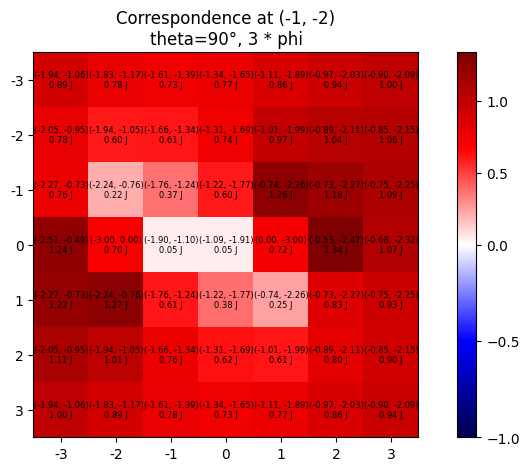

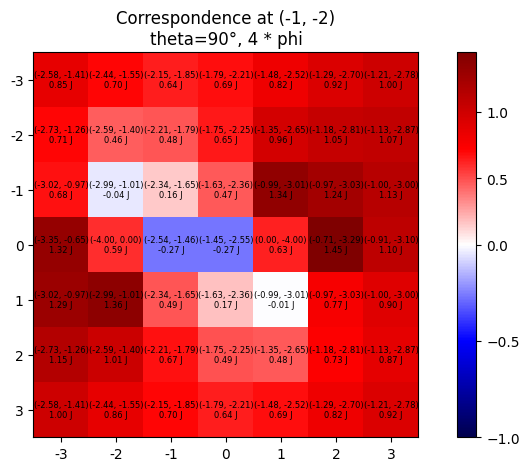

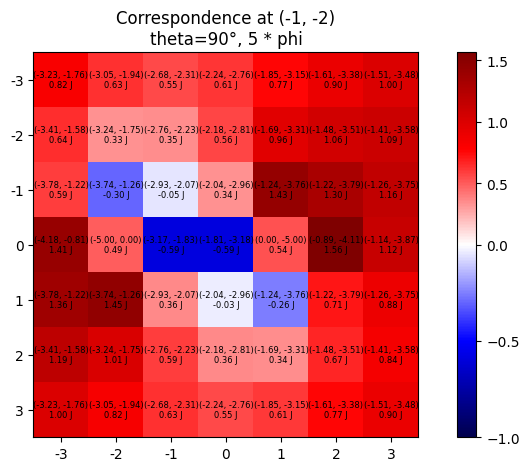

In [91]:
# Neighboring correspondence parameters
oy, ox = (-1, -2)
angle = 90
magnitude = 1
base_magnitude = 1
MULTIPLIER = 3
USE_X_1_CASE = False
n = 7

for i in range(1, 6):
    show_original = i == 1
    run_case3_phi_scaling(oy, ox, angle, magnitude, n=n, x_1_case=USE_X_1_CASE, base_magnitude=base_magnitude, phi_scale=i, 
                        title=f"Correspondence at ({oy}, {ox})\ntheta={angle}°, {i} * phi", show_arrows=show_original, show_derivative=show_original)

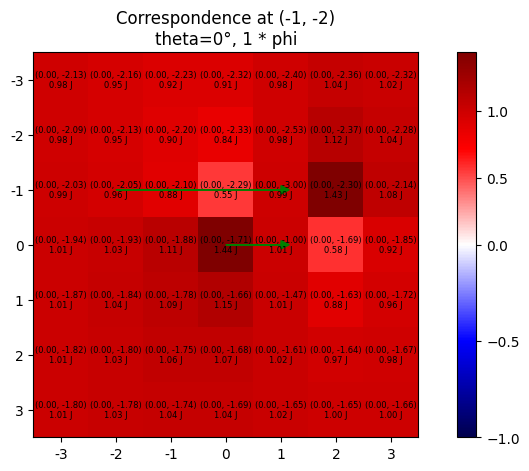

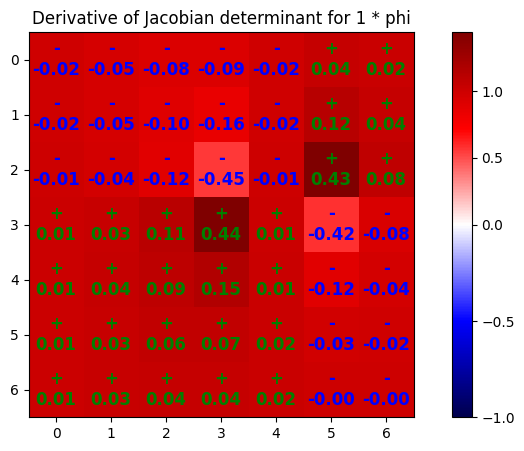

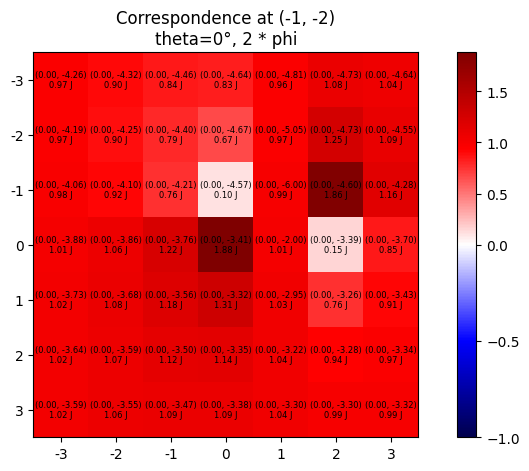

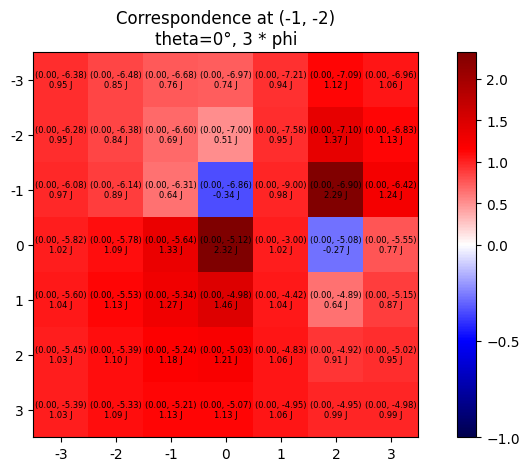

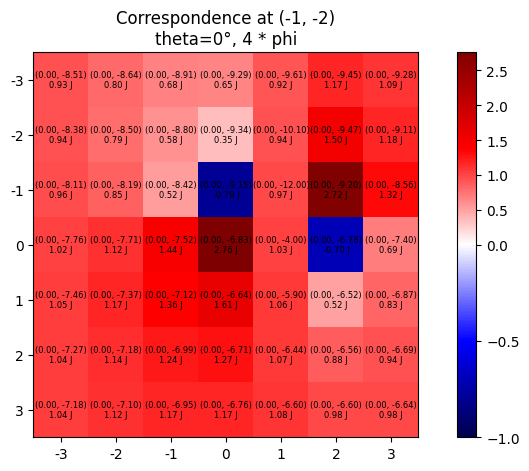

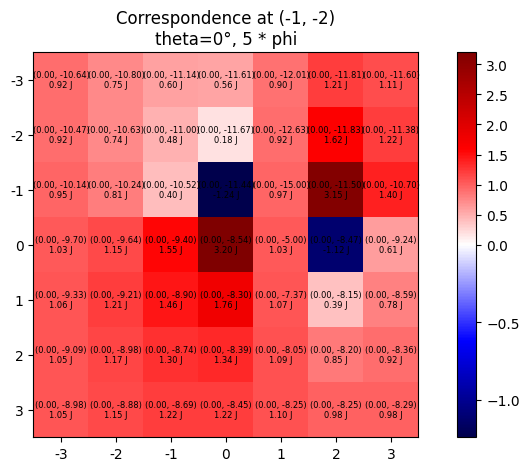

In [116]:
# Neighboring correspondence parameters
oy, ox = (-1, -2)
angle = 0
magnitude = 3
base_magnitude = 1
MULTIPLIER = 3
USE_X_1_CASE = False
n = 7

for i in range(1, 6):
    show_original = i == 1
    run_case3_phi_scaling(oy, ox, angle, magnitude, n=n, x_1_case=USE_X_1_CASE, base_magnitude=base_magnitude, phi_scale=i, 
                        title=f"Correspondence at ({oy}, {ox})\ntheta={angle}°, {i} * phi", show_arrows=show_original, show_derivative=show_original)

## END

Central Jacobian determinant: 0.8031487554435848


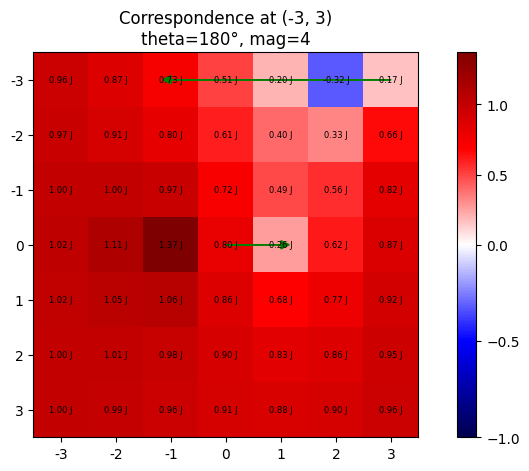

Central Jacobian determinant: 0.8385092068393244


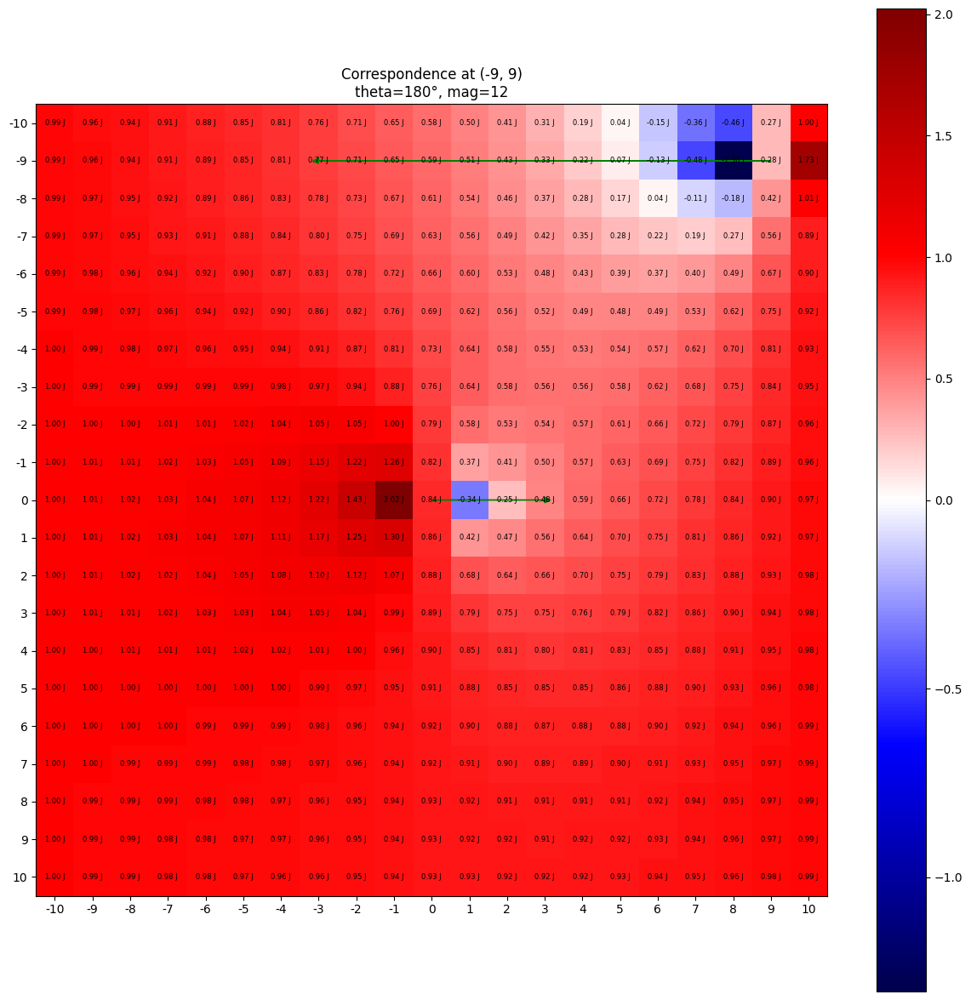

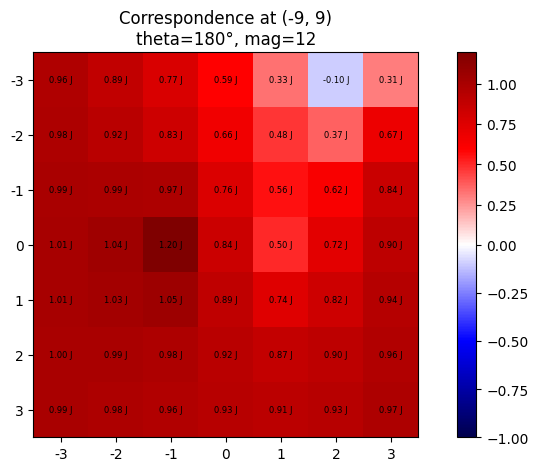

In [79]:

USE_X_1_CASE = False
MULTIPLIER = 3


# Base correspondence parameters
base_magnitude = 1

# Neighboring correspondence parameters
oy, ox = (-3, 3)
angle = 180
magnitude = 4
n = 7  # Setup the grid size

#############################################
# Case 2: base x

# Run the case
y = oy + n // 2  # Get central coordinates
x = ox + n // 2
deformation, jdet_field = create_case2(y, x, angle, magnitude, None, None, n=7, base_magnitude=base_magnitude, x_1_case=USE_X_1_CASE)
central_jdet = jdet_field[n//2, n//2]

print("Central Jacobian determinant:", central_jdet)
show_data2(deformation, jdet_field, y, x, angle, magnitude, 
           title=f"Correspondence at ({y - n // 2}, {x - n // 2})\ntheta={angle}°, mag={magnitude}", 
           fontsize=6, figsize=(10, 5),
           base_magnitude=base_magnitude)

#############################################
# Case 2: base x bigger

# Base correspondence parameters
base_magnitude = base_magnitude * MULTIPLIER

# Neighboring correspondence parameters
y, x = (oy * MULTIPLIER, ox * MULTIPLIER)
angle = angle
magnitude = magnitude * MULTIPLIER

# Setup the new grid size
n = n * MULTIPLIER

# Run the case
y = y + n // 2  # Get central coordinates
x = x + n // 2
deformation, jdet_field = create_case2(y, x, angle, magnitude, None, None, n=n, base_magnitude=base_magnitude, x_1_case=USE_X_1_CASE)
central_jdet = jdet_field[n//2, n//2]

print("Central Jacobian determinant:", central_jdet)
show_data2(deformation, jdet_field, y, x, angle, magnitude, 
           title=f"Correspondence at ({y - n // 2}, {x - n // 2})\ntheta={angle}°, mag={magnitude}", 
           fontsize=6, figsize=(15, 15),
           base_magnitude=base_magnitude)

#############################################
# Downsample jdet_field and show it.
jdet_downsampled = block_reduce(jdet_field, block_size=(3, 3), func=np.mean)

# Plot the grid of Jacobian determinants color values
show_jdet_only(jdet_downsampled, title=f"Correspondence at ({y - n // 2}, {x - n // 2})\ntheta={angle}°, mag={magnitude}", 
               fontsize=6, figsize=(10, 5))

## Generate LUT data

In [57]:
# User parameters
n = 7
SAVE_TO_FILE = True
pickle_filepath = 'lut_data_case2_x-1_x3.pkl'

# Setup initial correspondence in the center pixel.
mpoints = np.array([[0, (n // 2), (n // 2)]])
fpoints = np.array([[0, (n // 2), (n // 2) + 1]])
fixed_resolution = np.zeros((1, n, n))

# Define a function to create a nested defaultdict
def nested_dict():
    return defaultdict(nested_dict)
data = nested_dict()

# Create a range of correspondences for each pixel
for y in tqdm(range(n), desc="Outer loop y"):
    for x in tqdm(range(n), desc="Outer loop x", leave=False):
        # Skip the center pixel
        if y == (n // 2) and x == (n // 2):
            continue
        y *= 3
        x *= 3
        # Create correspondences for each angle (degrees) [0, 360) in increments of 10]
        for angle in tqdm(range(0, 360, 10), desc="Inner loop angle", leave=False):
            
            # Create correspondences for each magnitude from [0.5, 5.0] in increments of 0.5
            for magnitude in tqdm(range(1, 11), desc="Innermost loop magnitude", leave=False):
                magnitude /= 2
                magnitude *=3
                # Create the correspondence and apply as the second correspondence in the grid
                try:
                    deformation, jdet_field = create_case2(y, x, angle, magnitude, None, None, n=21, base_magnitude=3, x_1_case=USE_X_1_CASE)
                except Exception as e:
                    #print(f"Error: {e}")
                    #print(f"y: {y}, x: {x}, angle: {angle}, magnitude: {magnitude}")
                    continue
                data[y][x][angle][magnitude] = deformation, jdet_field
                
"""
# Create a range of correspondences for each pixel
for y in range(n):
    for x in range(n):
        # Skip the center pixel
        if y == (n // 2) and x == (n // 2):
            continue
        # Create correspondences for each angle (degrees) [0, 360) in increments of 10]
        for angle in range(0, 360, 10):
            
            # Create correspondences for each magnitude from [0.5, 5.0] in increments of 0.5
            for magnitude in range(1, 11):
                magnitude /= 2
                
                # Create the correspondence and apply as the second correspondence in the grid
                try:
                    deformation, jdet_field = create_case(y, x, angle, magnitude, mpoints, fpoints)
                except Exception as e:
                    #print(f"Error: {e}")
                    #print(f"y: {y}, x: {x}, angle: {angle}, magnitude: {magnitude}")
                    continue
                data[y][x][angle][magnitude] = deformation, jdet_field
"""

# Pickle the nested dictionary to a file
if SAVE_TO_FILE:
    with open(pickle_filepath, 'wb') as file:
        pickle.dump(data, file)

Outer loop y:   0%|          | 0/7 [00:00<?, ?it/s]

Outer loop x:   0%|          | 0/7 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Outer loop x:   0%|          | 0/7 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Outer loop x:   0%|          | 0/7 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Outer loop x:   0%|          | 0/7 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Outer loop x:   0%|          | 0/7 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Outer loop x:   0%|          | 0/7 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Outer loop x:   0%|          | 0/7 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

## Save to CSV spreadsheet

In [58]:
# Load the pickled dictionary from the file
with open('lut_data_case2_x-1.pkl', 'rb') as file:
    data = pickle.load(file)

In [59]:
csv_filepath = "lut_data_7x7_case2_x-1_min_jdet.csv"

headers = ["x", "y", "theta", "mag", "J"]
with open(csv_filepath, "w", newline="") as file:
    writer = csv.writer(file)
    writer.writerow(headers)
    for x in tqdm(range(n), desc="Outer loop x"):
        
        for y in tqdm(range(n), desc="Outer loop y", leave=False):
            if y == (n // 2) and x == (n // 2):
                continue

            for angle in tqdm(range(0, 360, 10), desc="Inner loop angle", leave=False):
                for magnitude in tqdm(range(1, 11), desc="Innermost loop magnitude", leave=False):
                    magnitude /= 2
                    
                    try:
                        deformation_field, jdet_field = data[y][x][angle][magnitude]
                        jdet = np.min(jdet_field)
                        normalized_y = y - (jdet_field.shape[0] // 2)
                        normalized_x = x - (jdet_field.shape[1] // 2)
                        writer.writerow([normalized_x, normalized_y, angle, magnitude, jdet])
                    except Exception as e:
                        continue

Outer loop x:   0%|          | 0/7 [00:00<?, ?it/s]

Outer loop y:   0%|          | 0/7 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Outer loop y:   0%|          | 0/7 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Outer loop y:   0%|          | 0/7 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Outer loop y:   0%|          | 0/7 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Outer loop y:   0%|          | 0/7 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Outer loop y:   0%|          | 0/7 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Outer loop y:   0%|          | 0/7 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Inner loop angle:   0%|          | 0/36 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

Innermost loop magnitude:   0%|          | 0/10 [00:00<?, ?it/s]

## Load data and visualize it

In [127]:
# Load the pickled dictionary from the file
with open('lut_data_case2_x-1_x3.pkl', 'rb') as file:
    loaded_data = pickle.load(file)

In [128]:
loaded_data.keys()

dict_keys([])

In [57]:
loaded_data[12][0]

defaultdict(<function __main__.nested_dict()>,
            {0: defaultdict(<function __main__.nested_dict()>,
                         {1.5: (array([[[[0.        , 0.        , 0.        , ..., 0.        , 0.        , 0.        ],
                                    [0.        , 0.        , 0.        , ..., 0.        , 0.        , 0.        ],
                                    [0.        , 0.        , 0.        , ..., 0.        , 0.        , 0.        ],
                                    ...,
                                    [0.        , 0.        , 0.        , ..., 0.        , 0.        , 0.        ],
                                    [0.        , 0.        , 0.        , ..., 0.        , 0.        , 0.        ],
                                    [0.        , 0.        , 0.        , ..., 0.        , 0.        , 0.        ]]],
                           
                           
                                  [[[0.        , 0.        , 0.        , ..., 0.        , 0.    

## Try x3

In [60]:
# Show grid information at a specific index
y, x = (0, 1)
angle = 0
magnitude = 3.0
n = 7

# Scale by 3
y = int((y + n // 2) * 3)
x = int((x + n // 2) * 3)
print(y, x)
#magnitude = magnitude * 3
#n = n * 3
# Get info
deformation, jdet_field = loaded_data[y][x][angle][magnitude]
central_jdet = jdet_field[n//2, n//2]

deform = deformation[:, 0, :, :]
pprint(deform)
#deformation, _ = create_case(y, x, angle, magnitude, mpoints, fpoints, n)

print("Central Jacobian determinant:", central_jdet)
show_data(loaded_data, y, x, angle, magnitude, 
          title=f"Correspondence at ({y - n // 2}, {x - n // 2})\ntheta={angle}°, mag={magnitude}", fontsize=6)

9 12


ValueError: not enough values to unpack (expected 2, got 0)

array([[[ 0.        ,  0.        ,  0.        ,  0.        ,  0.        ,  0.        ,  0.        ],
        [ 0.        ,  0.        ,  0.        ,  0.        ,  0.        ,  0.        ,  0.        ],
        [ 0.        ,  0.        ,  0.        ,  0.        ,  0.        ,  0.        ,  0.        ],
        [ 0.        ,  0.        ,  0.        ,  0.        ,  0.        ,  0.        ,  0.        ],
        [ 0.        ,  0.        ,  0.        ,  0.        ,  0.        ,  0.        ,  0.        ],
        [ 0.        ,  0.        ,  0.        ,  0.        ,  0.        ,  0.        ,  0.        ],
        [ 0.        ,  0.        ,  0.        ,  0.        ,  0.        ,  0.        ,  0.        ]],

       [[ 0.        ,  0.        ,  0.        ,  0.        ,  0.        ,  0.        ,  0.        ],
        [ 0.        ,  0.        ,  0.        ,  0.        ,  0.        ,  0.        ,  0.        ],
        [ 0.        ,  0.        ,  0.        ,  0.        ,  0.        ,  0.        ,  0

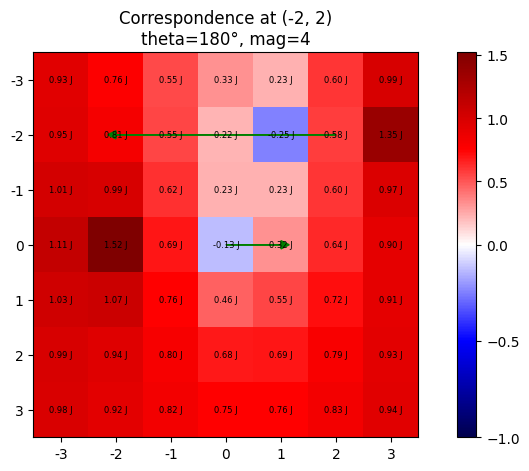

In [62]:
# Show grid information at a specific index
y, x = (-2, 2)
angle = 180
magnitude = 4
n = 7

y = y + n // 2
x = x + n // 2
# Get info
deformation, jdet_field = loaded_data[y][x][angle][magnitude]
central_jdet = jdet_field[n//2, n//2]

deform = deformation[:, 0, :, :]
pprint(deform)
#deformation, _ = create_case(y, x, angle, magnitude, mpoints, fpoints, n)

print("Central Jacobian determinant:", central_jdet)
show_data(loaded_data, y, x, angle, magnitude, 
          title=f"Correspondence at ({y - n // 2}, {x - n // 2})\ntheta={angle}°, mag={magnitude}", fontsize=6)

### Symmetry

array([[[0.        , 0.        , 0.        , 0.        , 0.        , 0.        , 0.        ],
        [0.        , 0.        , 0.        , 0.        , 0.        , 0.        , 0.        ],
        [0.        , 0.        , 0.        , 0.        , 0.        , 0.        , 0.        ],
        [0.        , 0.        , 0.        , 0.        , 0.        , 0.        , 0.        ],
        [0.        , 0.        , 0.        , 0.        , 0.        , 0.        , 0.        ],
        [0.        , 0.        , 0.        , 0.        , 0.        , 0.        , 0.        ],
        [0.        , 0.        , 0.        , 0.        , 0.        , 0.        , 0.        ]],

       [[0.        , 0.        , 0.        , 0.        , 0.        , 0.        , 0.        ],
        [0.        , 0.        , 0.        , 0.        , 0.        , 0.        , 0.        ],
        [0.        , 0.        , 0.        , 0.        , 0.        , 0.        , 0.        ],
        [0.        , 0.        , 0.        , 0.        , 0

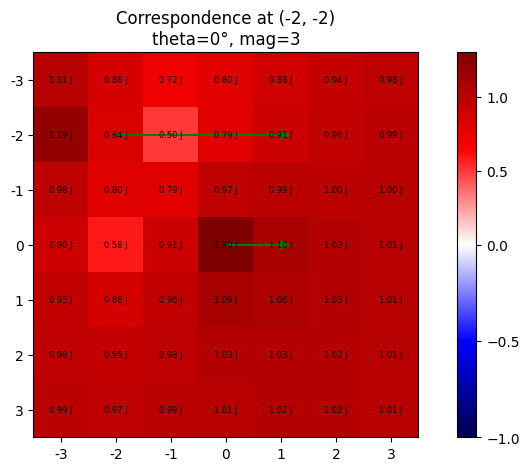

array([[[0.        , 0.        , 0.        , 0.        , 0.        , 0.        , 0.        ],
        [0.        , 0.        , 0.        , 0.        , 0.        , 0.        , 0.        ],
        [0.        , 0.        , 0.        , 0.        , 0.        , 0.        , 0.        ],
        [0.        , 0.        , 0.        , 0.        , 0.        , 0.        , 0.        ],
        [0.        , 0.        , 0.        , 0.        , 0.        , 0.        , 0.        ],
        [0.        , 0.        , 0.        , 0.        , 0.        , 0.        , 0.        ],
        [0.        , 0.        , 0.        , 0.        , 0.        , 0.        , 0.        ]],

       [[0.        , 0.        , 0.        , 0.        , 0.        , 0.        , 0.        ],
        [0.        , 0.        , 0.        , 0.        , 0.        , 0.        , 0.        ],
        [0.        , 0.        , 0.        , 0.        , 0.        , 0.        , 0.        ],
        [0.        , 0.        , 0.        , 0.        , 0

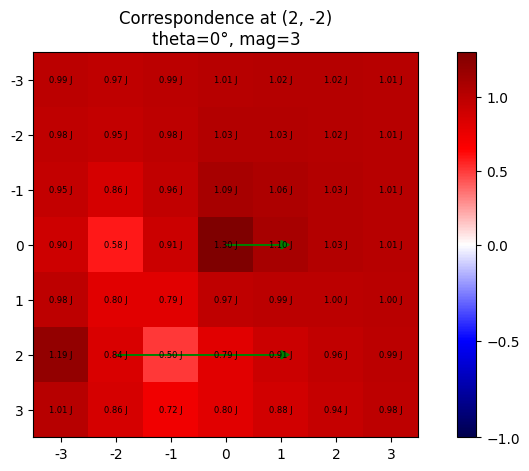

In [63]:
# Show grid information at a specific index
y, x = (1, 1)
angle = 0
magnitude = 3

# Get info
deformation, jdet_field = loaded_data[y][x][angle][magnitude]
central_jdet = jdet_field[n//2, n//2]

deform = deformation[:, 0, :, :]
pprint(deform)
#deformation, _ = create_case(y, x, angle, magnitude, mpoints, fpoints, n)

print("Central Jacobian determinant:", central_jdet)
show_data(loaded_data, y, x, angle, magnitude, 
          title=f"Correspondence at ({y - n // 2}, {x - n // 2})\ntheta={angle}°, mag={magnitude}", fontsize=6)



# Show grid information at a specific index
y, x = (5, 1)
angle = 0
magnitude = 3

# Get info
deformation, jdet_field = loaded_data[y][x][angle][magnitude]
central_jdet = jdet_field[n//2, n//2]

deform = deformation[:, 0, :, :]
pprint(deform)
#deformation, _ = create_case(y, x, angle, magnitude, mpoints, fpoints, n)

print("Central Jacobian determinant:", central_jdet)
show_data(loaded_data, y, x, angle, magnitude, 
          title=f"Correspondence at ({y - n // 2}, {x - n // 2})\ntheta={angle}°, mag={magnitude}", fontsize=6)

### Flip mpoints and fpoints in Laplacian and test

array([[[ 0.        ,  0.        ,  0.        ,  0.        ,  0.        ,  0.        ,  0.        ,  0.        ,  0.        ,  0.        ,  0.        ,  0.        ,  0.        ],
        [ 0.        ,  0.        ,  0.        ,  0.        ,  0.        ,  0.        ,  0.        ,  0.        ,  0.        ,  0.        ,  0.        ,  0.        ,  0.        ],
        [ 0.        ,  0.        ,  0.        ,  0.        ,  0.        ,  0.        ,  0.        ,  0.        ,  0.        ,  0.        ,  0.        ,  0.        ,  0.        ],
        [ 0.        ,  0.        ,  0.        ,  0.        ,  0.        ,  0.        ,  0.        ,  0.        ,  0.        ,  0.        ,  0.        ,  0.        ,  0.        ],
        [ 0.        ,  0.        ,  0.        ,  0.        ,  0.        ,  0.        ,  0.        ,  0.        ,  0.        ,  0.        ,  0.        ,  0.        ,  0.        ],
        [ 0.        ,  0.        ,  0.        ,  0.        ,  0.        ,  0.        ,  0.        ,  0.  

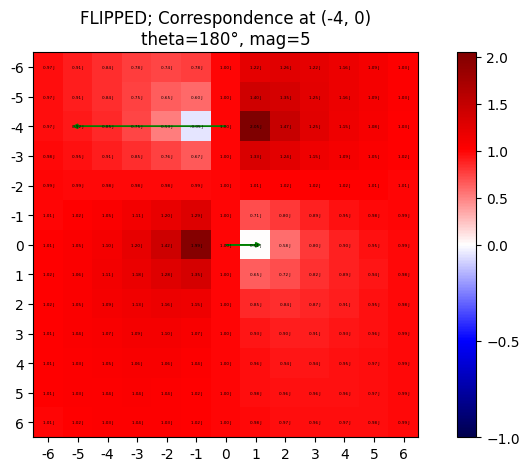

In [64]:
# Show grid information at a specific index
y, x = (2, 6)
angle = 180
magnitude = 5
n = 13

# Get info
deformation, jdet_field = create_case2(y, x, angle, magnitude, None, None, n=n)
central_jdet = jdet_field[n//2, n//2]

deform = deformation[:, 0, :, :]
pprint(deform)
pprint(jdet_field)
#deformation, _ = create_case(y, x, angle, magnitude, mpoints, fpoints, n)

print("Central Jacobian determinant:", central_jdet)
#show_data(loaded_data, y, x, angle, magnitude, 
#          title=f"Correspondence at ({y - n // 2}, {x - n // 2})\ntheta={angle}°, mag={magnitude}", fontsize=6)
show_data2(deformation, jdet_field, y, x, angle, magnitude, 
           title=f"FLIPPED; Correspondence at ({y - n // 2}, {x - n // 2})\ntheta={angle}°, mag={magnitude}", fontsize=3)

## Test cases

In [65]:
# Show grid information at a specific index with padding
y, x = (1, 6)
angle = 180
magnitude = 4
deformation, jdet_field = create_case(y, x, angle, magnitude, mpoints, fpoints, n)

pprint(deformation[2, 0, :, :])

array([[ 2.81870257,  2.96058902,  3.08336609,  2.29026198,  1.5437825 ,  1.04923093,  0.7529237 ,  0.57827723,  0.47339033,  0.40913594,  0.37025335,  0.3481525 ,  0.33851401],
       [ 2.67663571,  2.97925156,  3.99963474,  2.24521152,  1.29268857,  0.85183196,  0.6336101 ,  0.51230228,  0.43820138,  0.38997808,  0.35947201,  0.3412812 ,  0.33324121],
       [ 2.23202727,  2.28023193,  2.25935271,  1.39972004,  0.53110357,  0.43341812,  0.42025789,  0.40354535,  0.38091668,  0.35898002,  0.34158526,  0.32984695,  0.32452572],
       [ 1.73919302,  1.65053612,  1.35873841,  0.56422383, -0.99990869, -0.06819073,  0.21407031,  0.30301111,  0.32693321,  0.32814582,  0.32284423,  0.31745364,  0.31471965],
       [ 1.33510055,  1.224659  ,  0.96251883,  0.49906357, -0.03877441,  0.0801456 ,  0.20262877,  0.26936753,  0.29846981,  0.30766129,  0.30881786,  0.30720371,  0.30604012],
       [ 1.04126864,  0.95180055,  0.76924483,  0.50930858,  0.26613916,  0.22528584,  0.24796379,  0.27475839

In [66]:
# Show grid information at a specific index without padding
y, x = (1, 6)
angle = 180
magnitude = 4
deformation, jdet_field = create_case(y, x, angle, magnitude, mpoints, fpoints, n)

pprint(deformation[2, 0, :, :])

array([[ 2.81870257,  2.96058902,  3.08336609,  2.29026198,  1.5437825 ,  1.04923093,  0.7529237 ,  0.57827723,  0.47339033,  0.40913594,  0.37025335,  0.3481525 ,  0.33851401],
       [ 2.67663571,  2.97925156,  3.99963474,  2.24521152,  1.29268857,  0.85183196,  0.6336101 ,  0.51230228,  0.43820138,  0.38997808,  0.35947201,  0.3412812 ,  0.33324121],
       [ 2.23202727,  2.28023193,  2.25935271,  1.39972004,  0.53110357,  0.43341812,  0.42025789,  0.40354535,  0.38091668,  0.35898002,  0.34158526,  0.32984695,  0.32452572],
       [ 1.73919302,  1.65053612,  1.35873841,  0.56422383, -0.99990869, -0.06819073,  0.21407031,  0.30301111,  0.32693321,  0.32814582,  0.32284423,  0.31745364,  0.31471965],
       [ 1.33510055,  1.224659  ,  0.96251883,  0.49906357, -0.03877441,  0.0801456 ,  0.20262877,  0.26936753,  0.29846981,  0.30766129,  0.30881786,  0.30720371,  0.30604012],
       [ 1.04126864,  0.95180055,  0.76924483,  0.50930858,  0.26613916,  0.22528584,  0.24796379,  0.27475839

In [54]:
def compute_jdet(left, right, up, down):
    # Compute the Jacobian determinant
    left_x = left[1]
    left_y = left[0]
    right_x = right[1]
    right_y = right[0]
    up_x = up[1]
    up_y = up[0]
    down_x = down[1]
    down_y = down[0]
    
    dxdx = (right_x - left_x) / 2
    dydy = (down_y - up_y) / 2
    dxdy = (down_x - up_x) / 2
    dydx = (right_y - left_y) / 2
    
    print('dxdx:', dxdx)
    print('dydy:', dydy)
    print('dxdy:', dxdy)
    print('dydx:', dydx)
    
    jdet = (dxdx + 1) * (dydy + 1) - (dxdy * dydx)
    return jdet, dxdx, dydy, dxdy, dydx

In [55]:
right = (0.22, 0.61)
left = (0.43, 0.25)
down = (0.22, 0.61)
up = (0.43, 0.25)
compute_jdet(left, right, up, down)

dxdx: 0.18
dydy: -0.105
dxdy: 0.18
dydx: -0.105


1.075

In [57]:
# magnitude = 1
right = (0.28, 0.50)
left = (0.00, 1.00)
down = (0.25, 0.57)
up = (0.35, 0.38)
compute_jdet(left, right, up, down)

dxdx: -0.25
dydy: -0.04999999999999999
dxdy: 0.09499999999999997
dydx: 0.14


0.6991999999999999

In [58]:
right = (0.57, 1.01)
left = (0.00, 2.00)
down = (0.50, 1.14)
up = (0.71, 0.77)
compute_jdet(left, right, up, down)

dxdx: -0.495
dydy: -0.10499999999999998
dxdy: 0.18499999999999994
dydx: 0.285


0.39925000000000005

In [59]:
right = (0.85, 1.51)
left = (0.00, 3.00)
down = (0.75, 1.70)
up = (1.06, 1.15)
compute_jdet(left, right, up, down)

dxdx: -0.745
dydy: -0.15500000000000003
dxdy: 0.275
dydx: 0.425


0.0986